In [3]:
%matplotlib inline
import mne
import os
import pyedflib
import pandas as pd
import numpy as np
import seaborn as sns
from mne.io import read_raw_edf, RawArray, concatenate_raws
from mne.stats import permutation_cluster_1samp_test as pcluster_test
import warnings
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
import autoreject
from autoreject import get_rejection_threshold
from mne.decoding import CSP
from sklearn.model_selection import train_test_split, cross_val_score
import pywt
from scipy.stats import pointbiserialr
from math import sqrt

from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC 
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D,MaxPooling2D, Flatten
from tensorflow.keras import datasets, layers, models

import mrmr
from mrmr import mrmr_classif

from torch.utils.data import DataLoader, TensorDataset
import torch
from torch import nn

In [4]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

In [5]:
def load_data(subject_id:list, task_id:list, montage_name:str):
    dataset_path = "Online Dataset/eeg-motor-movementimagery-dataset-1.0.0/files"

    # --- Full Path ---
    filenames = []
    for i in range(len(subject_id)):
        for j in range(len(task_id)):
            filenames.append("S"+subject_id[i]+"/S"+subject_id[i]+"R"+task_id[j]+".edf")
            
    path = [os.path.join(dataset_path, filename).replace("\\", "/") for filename in filenames]

    # --- Read EDF Files ---
    subject_raws = []
    for file_path in path:
        with warnings.catch_warnings():
            warnings.filterwarnings("ignore", category=RuntimeWarning)
            data = mne.io.read_raw_edf(file_path, preload=True, verbose=False)
        subject_raws.append(data)

    # print("Path:",path)
    raws_data = concatenate_raws(subject_raws)
    # print("RawEDF data:", raws_data)

    # --- Check Signal Channels ---
    with pyedflib.EdfReader(path[-1]) as edf_file:
        signal_labels = edf_file.getSignalLabels()
        # print("signal_channels:", signal_labels)
    
    with open("Online Dataset/eeg-motor-movementimagery-dataset-1.0.0/files/wfdbcal", "r") as file:
        content = file.readlines()
    
    chan_name = []
    chan_order = []
    chan_mapping = {}
    order = 1
    for line in content:
        parts = line.split('\t')
        channel_name = parts[0].strip()
        channel_name = channel_name.replace(".", "")
        chan_name.append(channel_name)
        order_name = "# " + str(order)
        chan_order.append(order_name)
        chan_mapping[order_name] = channel_name
        order += 1 

    channel_names = [chan_mapping[f'# {i+1}'] for i in range(64)]
    old_ch_names = raws_data.info['ch_names']

    raws_data.rename_channels({old: new for old, new in zip(old_ch_names, channel_names)})

    # Set montage
    # montage = mne.channels.make_standard_montage('standard_1020')
    raws_data.set_montage(montage = mne.channels.make_standard_montage(montage_name))

    # Plot channel locations
    # raws_data.plot_sensors(show_names=True);
    
    # raws_data.compute_psd().plot_topomap();
    # raws_data.compute_psd().plot();
    
    return raws_data

In [6]:
def preprocessing(raws_data, event, chans_selected:list):
    # --- Apply Re-reference by Common Average Reference (CAR) ---
    streams = raws_data.copy().set_eeg_reference('average', projection=True)
    streams.apply_proj()
    
    # --- Filter Data ---
    stream_filter = streams.copy().filter(l_freq=8.0, h_freq=15.0, method = 'iir', iir_params= {"order": 6, "ftype":'butter'})
    
    # --- Apply ICA ---
    ica = mne.preprocessing.ICA(n_components=63, random_state=97, max_iter=800)
    ica.fit(stream_filter.copy())
    
    # --- Find Bad Components ---
    bad_idx, scores = ica.find_bads_eog(stream_filter.copy(), ch_name='T9', threshold=1.5)
    
    # --- Remove Bad Components ---
    ica.exclude = bad_idx
    
    # --- Apply ICA to Filtered Data ---
    stream_ica = ica.apply(stream_filter.copy(),exclude=ica.exclude)
    
    # --- Events ---
    events, event_dict = mne.events_from_annotations(stream_filter)
    
    # --- Epoch ---
    epochs = mne.Epochs(stream_ica.copy().filter(l_freq=8, h_freq=15.0, method = 'iir', iir_params= {"order": 6, "ftype":'butter'}), events, tmin = -0.5, tmax = 4, 
                    event_id = event, preload= True, verbose=False, event_repeated='drop')
    
    # --- Selected channels are interested ---
    epochs = epochs.pick_channels(chans_selected)
    
    # --- Baseline Correction ---
    Baseline = epochs.copy().filter(l_freq=8.0, h_freq=15.0, method = 'iir', iir_params= {"order": 6, "ftype":'butter'})
    stream_mi = Baseline.copy().apply_baseline((-0.5, 0))
    
    # --- reject bad channels ---
    def autoreject_epochs(epochs):
        reject = get_rejection_threshold(epochs)  
        reject.update(reject)
        epochs.drop_bad(reject = reject)
        return epochs
    stream_mi = autoreject_epochs(stream_mi.copy())
    
    return stream_mi

In [7]:
def extract_CSP(epochs, n_component = 7):
    X = epochs.get_data()
    y = epochs.events[:, -1]
    
    # Initilize CSP
    csp = CSP(n_components = n_component, norm_trace=False)
    csp_wt = CSP(n_components = n_component, reg=None, log=None, norm_trace=False, transform_into='csp_space')
    
    # Fit CSP to data 
    csp.fit(X, y)
    csp_wt.fit(X, y)
    
    new_data = csp_wt.transform(X)
    
    # Visualize CSP patterns
    csp.plot_patterns(epochs.info);
    print(csp)
    return X, y, csp, csp_wt, new_data

In [8]:
def extract_WT(epochs, target , n_component = 7):
    epochs_data = epochs.get_data()
    labels = epochs.events[:,-1]
    
    train_size = len(labels)
    train_data_cwt = np.ndarray(shape=(train_size ,epochs_data.shape[1] , 8, epochs_data.shape[2],))
    
    scales = range(8,16)

    X_mi, y_mi, csp, csp_wt, data_csp = extract_CSP(epochs.copy(), n_component)
    
    for ii in range(train_size):
        for jj in range(7):
            signal = data_csp[ii, jj, :]
            coeff, _ = pywt.cwt(signal, scales, 'morl', 1)
            coeff_ = coeff[:, :epochs_data.shape[2]]  # (8,epochs_data.shape[2])
            train_data_cwt[ii, jj, :, :] = np.abs(coeff_)  

    for j in range(4):
        sample = train_data_cwt[j]
        # Create subplots for each channel with a larger figure size
        fig, axs = plt.subplots(1, 7, figsize=(40, 5))  # Increase the width (20) to make the figure larger
        for i in range(7):
            axs[i].imshow(sample[i], aspect='auto', cmap='viridis')
            axs[i].set_title(f'Channel {i+1}')
        fig.suptitle(f'Class {labels[j]}', fontsize=16)
        plt.show()

    wt_shape = train_data_cwt.shape
    data_WT = np.reshape(train_data_cwt,(wt_shape[0],wt_shape[1]*wt_shape[2]*wt_shape[3]))
    
    return train_data_cwt, data_WT, labels, y_mi

In [9]:
def getMerit(subset, label):
    print(subset)
    # average feature-class correlation
    rcf_all = []
    for feature in subset:
        coeff = pointbiserialr( df[label], df[feature] )
        rcf_all.append( abs( coeff.correlation ) )
    rcf = np.mean( rcf_all )

    # average feature-feature correlation
    corr = df[subset].corr()
    corr.values[np.tril_indices_from(corr.values)] = np.nan
    corr = abs(corr)
    rff = corr.unstack().mean()
    
    return (k * rcf) / sqrt(k + k * (k-1) * rff)
    

In [10]:
class PriorityQueue:
    def  __init__(self):
        self.queue = []

    def isEmpty(self):
        return len(self.queue) == 0
    
    def push(self, item, priority):
        for index, (i, p) in enumerate(self.queue):
            if (set(i) == set(item)):
                if (p >= priority):
                    break
                del self.queue[index]
                self.queue.append( (item, priority) )
                break
        else:
            self.queue.append( (item, priority) )
        
    def pop(self):
        # return item with highest priority and remove it from queue
        max_idx = 0
        for index, (i, p) in enumerate(self.queue):
            if (self.queue[max_idx][1] < p):
                max_idx = index
        (item, priority) = self.queue[max_idx]
        del self.queue[max_idx]
        return (item, priority)

In [11]:
def CFS(csp,X_csp,y_csp):
    X_transformed = csp.transform(X_csp)
    df = pd.DataFrame(X_transformed)
    
    # Compute correlation matrix
    corr = df.corr()
    corr.values[np.tril_indices_from(corr.values)] = np.nan
    
    df = df.assign(Class = y_csp)
    
    # name of the label (can be seen in the dataframe)
    label = 'Class'

    # list with feature names (V1, V2, V3, ...)
    features = df.columns.tolist()
    features.remove(label)
    
    best_value = -1
    best_feature = ''
    for feature in features:
        coeff = pointbiserialr( df[label], df[feature] )
        abs_coeff = abs( coeff.correlation )
        if abs_coeff > best_value:
            best_value = abs_coeff
            best_feature = feature

    print("Feature %s with merit %.4f"%(best_feature, best_value))
    
    # initialize queue
    queue = PriorityQueue()

    # push first tuple (subset, merit)
    queue.push([best_feature], best_value)
    
    visited = []
    n_backtrack = 0
    max_backtrack = 5
    
    # repeat until queue is empty
    # or the maximum number of backtracks is reached
    while not queue.isEmpty():
        # get element of queue with highest merit
        subset, priority = queue.pop()
        
        # check whether the priority of this subset
        # is higher than the current best subset
        if (priority < best_value):
            n_backtrack += 1
        else:
            best_value = priority
            best_subset = subset

        # goal condition
        if (n_backtrack == max_backtrack):
            break
        
        # iterate through all features and look of one can
        # increase the merit
        for feature in features:
            temp_subset = subset + [feature]
            
            # check if this subset has already been evaluated
            for node in visited:
                if (set(node) == set(temp_subset)):
                    break
            # if not, ...
            else:
                # ... mark it as visited
                visited.append( temp_subset )
                # ... compute merit
                merit = getMerit(temp_subset, label)
                
                # and push it to the queue
                queue.push(temp_subset, merit)
    
    return best_subset

In [12]:
def mRMR_csp(csp,X_csp,y_csp,k=2):
    X_transformed = csp.transform(X_csp)
    df = pd.DataFrame(X_transformed)
    # Compute correlation matrix
    corr = df.corr()
    corr.values[np.tril_indices_from(corr.values)] = np.nan
    
    df = df.assign(Class = y_csp)
    
    # name of the label (can be seen in the dataframe)
    label = 'Class'

    # list with feature names (V1, V2, V3, ...)
    features = df.columns.tolist()
    features.remove(label)
    
    # predictors
    X = df[features].to_numpy()
    X = pd.DataFrame(X)
    # target
    Y = df[label].to_numpy()
    y = pd.Series(Y)

    selected_features = mrmr_classif(X=X, y=y, K=k)
    
    return selected_features

In [13]:
def mRMR_WT(data_WT, y_mi,k):  
    # predictors
    wt_shape = data_WT.shape
    X = pd.DataFrame(data_WT)
    # target
    y = pd.Series(y_mi)

    selected_features = mrmr_classif(X=X, y=y, K=k)
    print(selected_features)
    
    return selected_features

In [14]:
def csp_split(csp,X,y,test_size,random_state,subset:list = [0,1,2,3,4,5,6]):
    X_transformed = csp.transform(X)
    df = pd.DataFrame(X_transformed)

    # Split data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(df[subset], y, test_size=test_size, random_state=random_state)
    
    return X_train, X_test, y_train, y_test

In [15]:
def WT_split(data_WT, y, test_size, random_state, subset=None):
    wt_shape = data_WT.shape
    df = pd.DataFrame(data_WT)
    
    # If subset is None, set it to include all elements
    if subset is None:
        subset = slice(None)  # Equivalent to [:]
    
    # Split data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(df[subset], y, test_size=test_size, random_state=random_state)
    
    return X_train, X_test, y_train, y_test

In [16]:
def report(y_test, y_pred, results, target = ['left','right']):
    accuracy = accuracy_score(y_test, y_pred)
    results[0].append(accuracy)
    precision = precision_score(y_test, y_pred, average='weighted')
    results[1].append(precision)
    recall = recall_score(y_test, y_pred, average='weighted')
    results[2].append(recall)
    f1 = f1_score(y_test, y_pred, average='weighted')
    results[3].append(f1)
    print(f"Accuracy: {accuracy}")
    print(f"precision: {precision}")
    print(f"recall: {recall}")
    print(f"f1_score: {f1}")
    
    report = classification_report(y_test, y_pred, target_names=target)  
    print(report)
    print("Confusion matrix \n=======================")
    print(confusion_matrix(y_true=y_test, y_pred=y_pred))
    
    return results

In [17]:
def svm(X_train, X_test, y_train, y_test, target,results, kernel='linear',gamma = 'auto'):
    print("============ Support Vector Machine (SVM) kernel("+kernel+") gamma("+str(gamma)+") ============")
    clf = Pipeline([('SVM', SVC(kernel=kernel, gamma=gamma))])  
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    results = report(y_test, y_pred,results, target)
    print()
    return results

In [18]:
def lda(X_train, X_test, y_train, y_test, target,results):
    print("============ Linear Discriminant Analysis (LDA) ============")
    clf = Pipeline([('LDA', LDA())])
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    results = report(y_test, y_pred,results, target)
    print()
    return results

In [19]:
# Create and fit the logistic regression model within a pipeline
def logistic_regression(X_train, X_test, y_train, y_test, target,results):
    print("============ logistic_regression ============")
    clf = Pipeline([('LR', LogisticRegression())])
    clf.fit(X_train, y_train)
    
    # Predict and calculate accuracy
    y_pred = clf.predict(X_test)
    results = report(y_test, y_pred,results, target)
    print()
    return results

In [20]:
def naive(X_train, X_test, y_train, y_test, target,results):
    print("============ naive bayes ============")
    model = GaussianNB()
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_test)
    results = report(y_test, y_pred,results, target)
    print()
    return results

In [21]:
def knn(X_train, X_test, y_train, y_test, target, results):
    print("============ K-Nearest Neighbors (KNN) ============")
    clf = KNeighborsClassifier(n_neighbors=3)
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    results = report(y_test, y_pred,results, target)
    print()
    return results

In [22]:
def mlp(X_train, X_test, y_train, y_test, target,results, solver='lbfgs', hidden_layer_sizes=(50, 4), random_state=3, max_iter=210):
    print("============ Multi-layer Perceptron (MLP) ============")
    clf = MLPClassifier(solver='lbfgs', hidden_layer_sizes=(50, 4), random_state=3, max_iter=210)
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    results = report(y_test, y_pred,results, target)
    print()
    return results

In [23]:
def nn_fit(X_train, X_test, y_train, y_test, model, epochs, batch_size):
    y_train_encoded = pd.get_dummies(y_train, columns=[1, 2])
    y_test_encoded = pd.get_dummies(y_test, columns=[1, 2])
    
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    history = model.fit(X_train, y_train_encoded, validation_data=(X_test, y_test_encoded), epochs=epochs, batch_size=batch_size)
    
    score_train = model.evaluate(X_train, y_train_encoded, verbose=0)
    print("Train loss:", score_train[0])
    print("Train accuracy:", score_train[1])
    
    return y_train_encoded,y_test_encoded,history,model

In [24]:
def nn_report(y_test_encoded,history, X_test, target,results, numclass , model):
    
    actual_classes_str = pd.get_dummies(y_test_encoded).idxmax(1)
    actual_classes_str = pd.DataFrame(actual_classes_str, index=y_test_encoded.index)

    #Predictions on the test set
    predicted_classes = np.argmax(model.predict(X_test),axis=1)
    predicted_classes_str = []
    
    for i in predicted_classes:
        if len(numclass) == 2:
            if i == 0:
                predicted_classes_str.append(numclass[0])
            else:
                predicted_classes_str.append(numclass[1])
        elif len(numclass) == 3:
            if i == 0:
                predicted_classes_str.append(numclass[0])
            elif i == 1:
                predicted_classes_str.append(numclass[1])
            elif i == 2:
                predicted_classes_str.append(numclass[2])
    
    predicted_classes_str = pd.DataFrame(predicted_classes_str,index=y_test_encoded.index)

    results = report(actual_classes_str, predicted_classes_str,results,target)
    
    score = model.evaluate(X_test, y_test_encoded, verbose=0)
    print("Test loss:", score[0])
    print("Test accuracy:", score[1])
    
    # plotting the metrics
    plt.figure(figsize=(10, 7))
    plt.subplot(2,1,1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='lower right')

    plt.subplot(2,1,2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper right')
    plt.tight_layout()
    
    return results

## **rest left right**

In [399]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'rest':1, 'left': 2, 'right': 3}
target = ['rest','left','right']
numclass = [1,2,3]

In [400]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated


SSP projectors applied...
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took 6.7s.
Using EOG channel: T9
    Applying projection operator with 1 vector (pre-whitener application)
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windo

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 14 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating reject

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

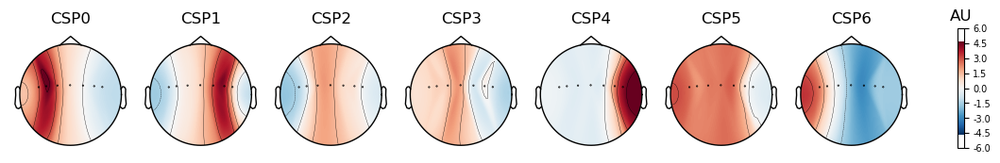

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [27]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [28]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [29]:
result = [[],[],[],[]]

In [30]:
result = svm(X_train, X_test, y_train, y_test, target,result, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.6857142857142857
precision: 0.6690683229813664
recall: 0.6857142857142857
f1_score: 0.6639455782312926
              precision    recall  f1-score   support

        rest       0.70      0.84      0.76        19
        left       0.50      0.20      0.29         5
       right       0.70      0.64      0.67        11

    accuracy                           0.69        35
   macro avg       0.63      0.56      0.57        35
weighted avg       0.67      0.69      0.66        35

Confusion matrix 
[[16  1  2]
 [ 3  1  1]
 [ 4  0  7]]



In [31]:
result = lda(X_train, X_test, y_train, y_test, target,result)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.7142857142857143
precision: 0.7057142857142858
recall: 0.7142857142857143
f1_score: 0.708913308913309
              precision    recall  f1-score   support

        rest       0.80      0.84      0.82        19
        left       0.50      0.40      0.44         5
       right       0.64      0.64      0.64        11

    accuracy                           0.71        35
   macro avg       0.65      0.63      0.63        35
weighted avg       0.71      0.71      0.71        35

Confusion matrix 
[[16  1  2]
 [ 1  2  2]
 [ 3  1  7]]



In [32]:
result = logistic_regression(X_train, X_test, y_train, y_test, target,result)

============ logistic_regression ============
Accuracy: 0.7428571428571429
precision: 0.7353535353535353
recall: 0.7428571428571429
f1_score: 0.7336662795199381
              precision    recall  f1-score   support

        rest       0.77      0.89      0.83        19
        left       0.50      0.40      0.44         5
       right       0.78      0.64      0.70        11

    accuracy                           0.74        35
   macro avg       0.68      0.64      0.66        35
weighted avg       0.74      0.74      0.73        35

Confusion matrix 
[[17  1  1]
 [ 2  2  1]
 [ 3  1  7]]



In [33]:
result = naive(X_train, X_test, y_train, y_test, target,result)

============ naive bayes ============
Accuracy: 0.6571428571428571
precision: 0.6477551020408163
recall: 0.6571428571428571
f1_score: 0.6502267573696145
              precision    recall  f1-score   support

        rest       0.71      0.79      0.75        19
        left       0.50      0.40      0.44         5
       right       0.60      0.55      0.57        11

    accuracy                           0.66        35
   macro avg       0.60      0.58      0.59        35
weighted avg       0.65      0.66      0.65        35

Confusion matrix 
[[15  2  2]
 [ 1  2  2]
 [ 5  0  6]]



In [34]:
result = knn(X_train, X_test, y_train, y_test, target,result)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.6857142857142857
precision: 0.6642857142857143
recall: 0.6857142857142857
f1_score: 0.671930243669374
              precision    recall  f1-score   support

        rest       0.75      0.79      0.77        19
        left       0.33      0.20      0.25         5
       right       0.67      0.73      0.70        11

    accuracy                           0.69        35
   macro avg       0.58      0.57      0.57        35
weighted avg       0.66      0.69      0.67        35

Confusion matrix 
[[15  2  2]
 [ 2  1  2]
 [ 3  0  8]]



In [35]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=7, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(3, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32)                256       
                                                                 
 dense_1 (Dense)             (None, 8)                 264       
                                                                 
 dense_2 (Dense)             (None, 3)                 27        
                                                                 
Total params: 547
Trainable params: 547
Non-trainable params: 0
_________________________________________________________________


In [36]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 1.1105 - accuracy: 0.2308 - val_loss: 1.0949 - val_accuracy: 0.1714
Epoch 2/50
1/1 [==============================] - 0s 58ms/step - loss: 1.1084 - accuracy: 0.2308 - val_loss: 1.0944 - val_accuracy: 0.1714
Epoch 3/50
1/1 [==============================] - 0s 51ms/step - loss: 1.1063 - accuracy: 0.2308 - val_loss: 1.0942 - val_accuracy: 0.2000
Epoch 4/50
1/1 [==============================] - 0s 48ms/step - loss: 1.1043 - accuracy: 0.2308 - val_loss: 1.0941 - val_accuracy: 0.2571
Epoch 5/50
1/1 [==============================] - 0s 46ms/step - loss: 1.1022 - accuracy: 0.2500 - val_loss: 1.0940 - val_accuracy: 0.2857
Epoch 6/50
1/1 [==============================] - 0s 49ms/step - loss: 1.1002 - accuracy: 0.2500 - val_loss: 1.0938 - val_accuracy: 0.2857
Epoch 7/50
1/1 [==============================] - 0s 44ms/step - loss: 1.0984 - accuracy: 0.2692 - val_loss: 1.0935 - val_accuracy: 0.3429
Epoch 8/50
1/1 [=============

2/2 [==============================] - 0s 3ms/step
Accuracy: 0.5142857142857142
precision: 0.4180952380952381
recall: 0.5142857142857142
f1_score: 0.44688644688644685
              precision    recall  f1-score   support

        rest       0.70      0.74      0.72        19
        left       0.27      0.80      0.40         5
       right       0.00      0.00      0.00        11

    accuracy                           0.51        35
   macro avg       0.32      0.51      0.37        35
weighted avg       0.42      0.51      0.45        35

Confusion matrix 
[[14  5  0]
 [ 1  4  0]
 [ 5  6  0]]
Test loss: 1.0295629501342773
Test accuracy: 0.5142857432365417


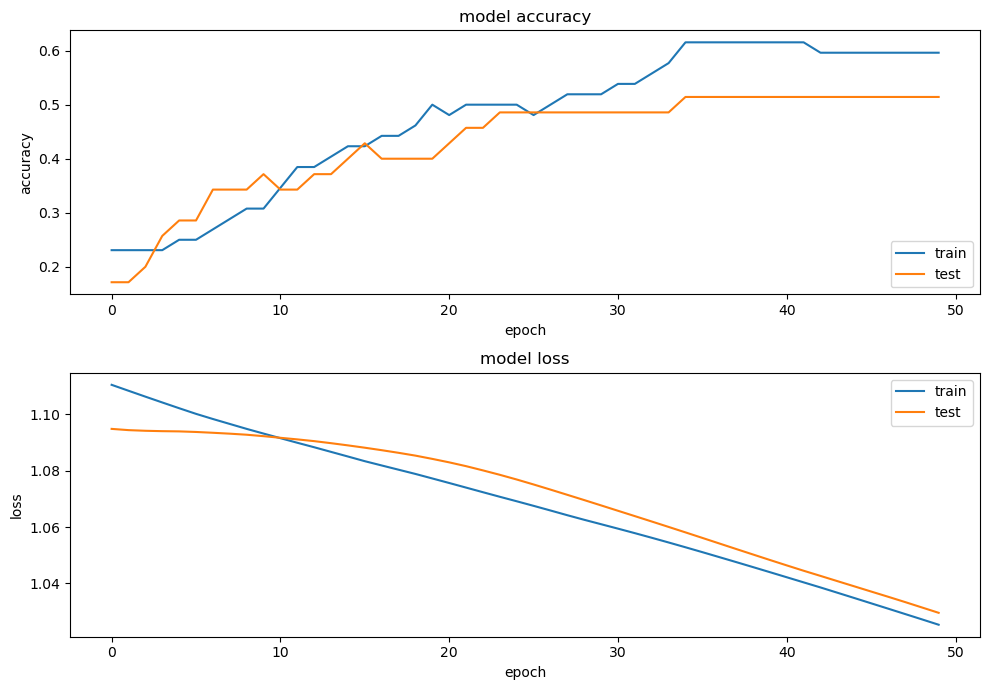

In [37]:
result = nn_report(y_test_encoded,history, X_test, target, result, numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

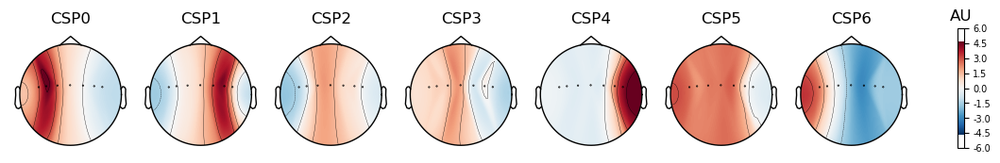

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [38]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [39]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[0,1])

In [40]:
result = svm(X_train, X_test, y_train, y_test, target, result, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.5428571428571428
precision: 0.370935960591133
recall: 0.5428571428571428
f1_score: 0.4398268398268398
              precision    recall  f1-score   support

        rest       0.55      0.84      0.67        19
        left       0.50      0.60      0.55         5
       right       0.00      0.00      0.00        11

    accuracy                           0.54        35
   macro avg       0.35      0.48      0.40        35
weighted avg       0.37      0.54      0.44        35

Confusion matrix 
[[16  3  0]
 [ 2  3  0]
 [11  0  0]]



In [41]:
result = lda(X_train, X_test, y_train, y_test, target, result)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.6571428571428571
precision: 0.6852040816326531
recall: 0.6571428571428571
f1_score: 0.658119658119658
              precision    recall  f1-score   support

        rest       0.75      0.79      0.77        19
        left       0.38      0.60      0.46         5
       right       0.71      0.45      0.56        11

    accuracy                           0.66        35
   macro avg       0.61      0.61      0.60        35
weighted avg       0.69      0.66      0.66        35

Confusion matrix 
[[15  3  1]
 [ 1  3  1]
 [ 4  2  5]]



In [42]:
result = logistic_regression(X_train, X_test, y_train, y_test, target, result)

============ logistic_regression ============
Accuracy: 0.6285714285714286
precision: 0.6508503401360545
recall: 0.6285714285714286
f1_score: 0.6209760827407886
              precision    recall  f1-score   support

        rest       0.71      0.79      0.75        19
        left       0.38      0.60      0.46         5
       right       0.67      0.36      0.47        11

    accuracy                           0.63        35
   macro avg       0.59      0.58      0.56        35
weighted avg       0.65      0.63      0.62        35

Confusion matrix 
[[15  3  1]
 [ 1  3  1]
 [ 5  2  4]]



In [43]:
result = naive(X_train, X_test, y_train, y_test, target,result)

============ naive bayes ============
Accuracy: 0.7142857142857143
precision: 0.7142857142857143
recall: 0.7142857142857143
f1_score: 0.7128205128205127
              precision    recall  f1-score   support

        rest       0.75      0.79      0.77        19
        left       0.75      0.60      0.67         5
       right       0.64      0.64      0.64        11

    accuracy                           0.71        35
   macro avg       0.71      0.68      0.69        35
weighted avg       0.71      0.71      0.71        35

Confusion matrix 
[[15  1  3]
 [ 1  3  1]
 [ 4  0  7]]



In [44]:
result = knn(X_train, X_test, y_train, y_test, target,result)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.6285714285714286
precision: 0.6392857142857142
recall: 0.6285714285714286
f1_score: 0.6247541931752457


              precision    recall  f1-score   support

        rest       0.68      0.68      0.68        19
        left       0.50      0.80      0.62         5
       right       0.62      0.45      0.53        11

    accuracy                           0.63        35
   macro avg       0.60      0.65      0.61        35
weighted avg       0.64      0.63      0.62        35

Confusion matrix 
[[13  4  2]
 [ 0  4  1]
 [ 6  0  5]]



In [45]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 32)                96        
                                                                 
 dense_4 (Dense)             (None, 16)                528       
                                                                 
 dense_5 (Dense)             (None, 8)                 136       
                                                                 
 dense_6 (Dense)             (None, 3)                 27        
                                                                 
Total params: 787
Trainable params: 787
Non-trainable params: 0
_________________________________________________________________


In [46]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 630ms/step - loss: 1.0899 - accuracy: 0.3846 - val_loss: 1.0654 - val_accuracy: 0.6000
Epoch 2/100
1/1 [==============================] - 0s 41ms/step - loss: 1.0868 - accuracy: 0.4423 - val_loss: 1.0616 - val_accuracy: 0.6286
Epoch 3/100
1/1 [==============================] - 0s 48ms/step - loss: 1.0838 - accuracy: 0.4615 - val_loss: 1.0581 - val_accuracy: 0.6571
Epoch 4/100
1/1 [==============================] - 0s 45ms/step - loss: 1.0809 - accuracy: 0.4615 - val_loss: 1.0544 - val_accuracy: 0.6857
Epoch 5/100
1/1 [==============================] - 0s 44ms/step - loss: 1.0783 - accuracy: 0.4423 - val_loss: 1.0507 - val_accuracy: 0.6857
Epoch 6/100
1/1 [==============================] - 0s 43ms/step - loss: 1.0758 - accuracy: 0.4423 - val_loss: 1.0469 - val_accuracy: 0.6857
Epoch 7/100
1/1 [==============================] - 0s 42ms/step - loss: 1.0731 - accuracy: 0.4808 - val_loss: 1.0433 - val_accuracy: 0.6857
Epoch 8/100
1/1 [==

2/2 [==============================] - 0s 6ms/step
Accuracy: 0.5714285714285714
precision: 0.6136054421768707
recall: 0.5714285714285714
f1_score: 0.5506312292358804
              precision    recall  f1-score   support

        rest       0.58      0.74      0.65        19
        left       0.43      0.60      0.50         5
       right       0.75      0.27      0.40        11

    accuracy                           0.57        35
   macro avg       0.59      0.54      0.52        35
weighted avg       0.61      0.57      0.55        35

Confusion matrix 
[[14  4  1]
 [ 2  3  0]
 [ 8  0  3]]
Test loss: 0.7992903590202332
Test accuracy: 0.5714285969734192


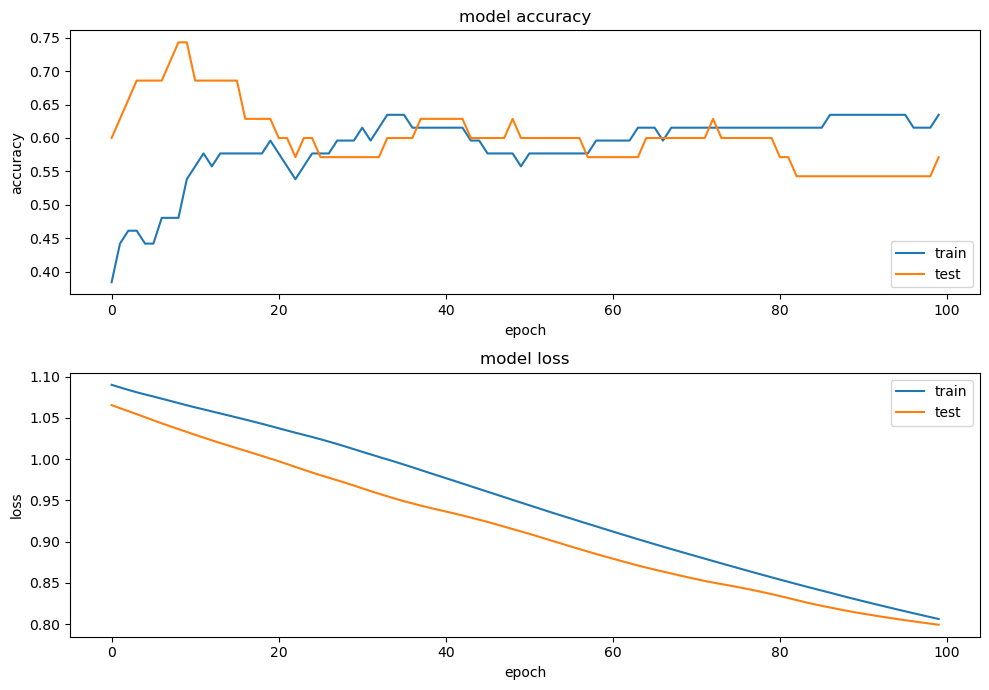

In [47]:
result = nn_report(y_test_encoded,history, X_test, target, result, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

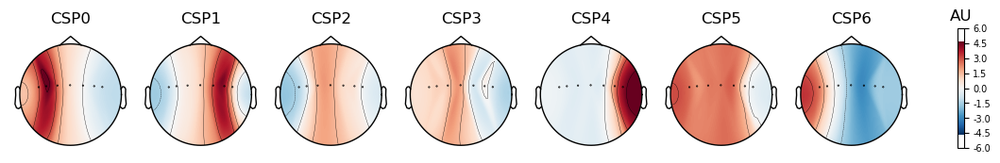

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [48]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [49]:
subset = mRMR_csp(csp,x,y,k=2)
subset

100%|██████████| 2/2 [00:01<00:00,  1.10it/s]


[0, 3]

In [50]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=subset)

In [51]:
result = svm(X_train, X_test, y_train, y_test, target,result, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.6571428571428571
precision: 0.6470046082949309
recall: 0.6571428571428571
f1_score: 0.5801904761904761
              precision    recall  f1-score   support

        rest       0.61      1.00      0.76        19
        left       0.00      0.00      0.00         5
       right       1.00      0.36      0.53        11

    accuracy                           0.66        35
   macro avg       0.54      0.45      0.43        35
weighted avg       0.65      0.66      0.58        35

Confusion matrix 
[[19  0  0]
 [ 5  0  0]
 [ 7  0  4]]



In [52]:
result = lda(X_train, X_test, y_train, y_test, target,result)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.6571428571428571
precision: 0.7047619047619047
recall: 0.6571428571428571
f1_score: 0.6544068790306821
              precision    recall  f1-score   support

        rest       0.67      0.84      0.74        19
        left       0.20      0.20      0.20         5
       right       1.00      0.55      0.71        11

    accuracy                           0.66        35
   macro avg       0.62      0.53      0.55        35
weighted avg       0.70      0.66      0.65        35

Confusion matrix 
[[16  3  0]
 [ 4  1  0]
 [ 4  1  6]]



In [53]:
result = logistic_regression(X_train, X_test, y_train, y_test, target,result)

============ logistic_regression ============
Accuracy: 0.6285714285714286
precision: 0.656084656084656
recall: 0.6285714285714286
f1_score: 0.5976708074534162
              precision    recall  f1-score   support

        rest       0.63      0.89      0.74        19
        left       0.00      0.00      0.00         5
       right       1.00      0.45      0.62        11

    accuracy                           0.63        35
   macro avg       0.54      0.45      0.45        35
weighted avg       0.66      0.63      0.60        35

Confusion matrix 
[[17  2  0]
 [ 5  0  0]
 [ 5  1  5]]



In [54]:
result = naive(X_train, X_test, y_train, y_test, target, result)

============ naive bayes ============
Accuracy: 0.6857142857142857
precision: 0.6990476190476191
recall: 0.6857142857142857
f1_score: 0.6914038342609772
              precision    recall  f1-score   support

        rest       0.74      0.74      0.74        19
        left       0.33      0.40      0.36         5
       right       0.80      0.73      0.76        11

    accuracy                           0.69        35
   macro avg       0.62      0.62      0.62        35
weighted avg       0.70      0.69      0.69        35

Confusion matrix 
[[14  3  2]
 [ 3  2  0]
 [ 2  1  8]]



In [55]:
result = knn(X_train, X_test, y_train, y_test, target, result)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.5714285714285714
precision: 0.6068027210884354
recall: 0.5714285714285714
f1_score: 0.5784126984126984
              precision    recall  f1-score   support

        rest       0.67      0.74      0.70        19
        left       0.14      0.20      0.17         5
       right       0.71      0.45      0.56        11

    accuracy                           0.57        35
   macro avg       0.51      0.46      0.47        35
weighted avg       0.61      0.57      0.58        35

Confusion matrix 
[[14  4  1]
 [ 3  1  1]
 [ 4  2  5]]



In [56]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_7 (Dense)             (None, 32)                96        
                                                                 
 dense_8 (Dense)             (None, 16)                528       
                                                                 
 dense_9 (Dense)             (None, 8)                 136       
                                                                 
 dense_10 (Dense)            (None, 3)                 27        
                                                                 
Total params: 787
Trainable params: 787
Non-trainable params: 0
_________________________________________________________________


In [57]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 1.0995 - accuracy: 0.4808 - val_loss: 1.0951 - val_accuracy: 0.4286
Epoch 2/50
1/1 [==============================] - 0s 49ms/step - loss: 1.0972 - accuracy: 0.5192 - val_loss: 1.0926 - val_accuracy: 0.4286
Epoch 3/50
1/1 [==============================] - 0s 53ms/step - loss: 1.0950 - accuracy: 0.5000 - val_loss: 1.0901 - val_accuracy: 0.4857
Epoch 4/50
1/1 [==============================] - 0s 49ms/step - loss: 1.0929 - accuracy: 0.4808 - val_loss: 1.0877 - val_accuracy: 0.4857
Epoch 5/50
1/1 [==============================] - 0s 46ms/step - loss: 1.0908 - accuracy: 0.4808 - val_loss: 1.0853 - val_accuracy: 0.4857
Epoch 6/50
1/1 [==============================] - 0s 48ms/step - loss: 1.0888 - accuracy: 0.4808 - val_loss: 1.0831 - val_accuracy: 0.4857
Epoch 7/50
1/1 [==============================] - 0s 49ms/step - loss: 1.0868 - accuracy: 0.4808 - val_loss: 1.0810 - val_accuracy: 0.4857
Epoch 8/50
1/1 [=============

2/2 [==============================] - 0s 4ms/step
Accuracy: 0.4857142857142857
precision: 0.3180952380952381
recall: 0.4857142857142857
f1_score: 0.3830903790087464
              precision    recall  f1-score   support

        rest       0.53      0.84      0.65        19
        left       0.20      0.20      0.20         5
       right       0.00      0.00      0.00        11

    accuracy                           0.49        35
   macro avg       0.24      0.35      0.28        35
weighted avg       0.32      0.49      0.38        35

Confusion matrix 
[[16  3  0]
 [ 4  1  0]
 [10  1  0]]
Test loss: 1.0034587383270264
Test accuracy: 0.48571428656578064


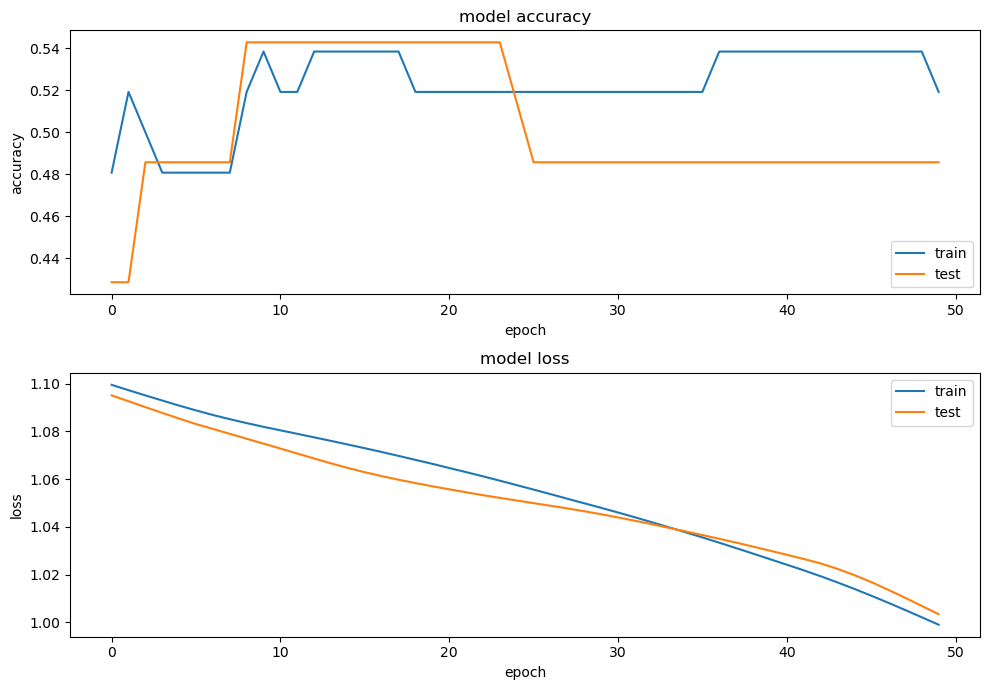

In [58]:
result = nn_report(y_test_encoded,history, X_test, target,result, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

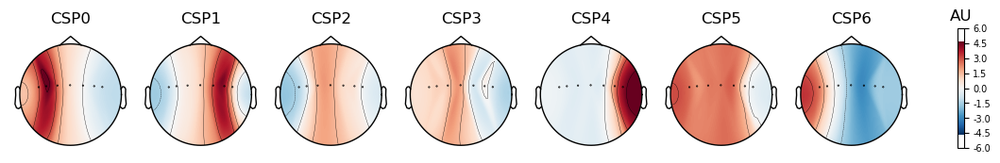

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


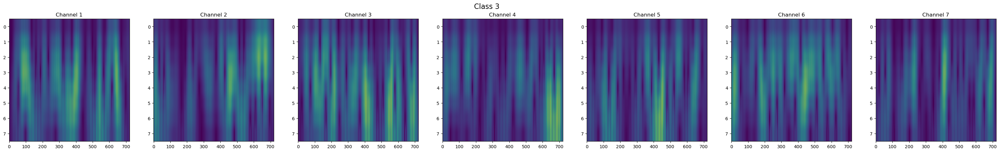

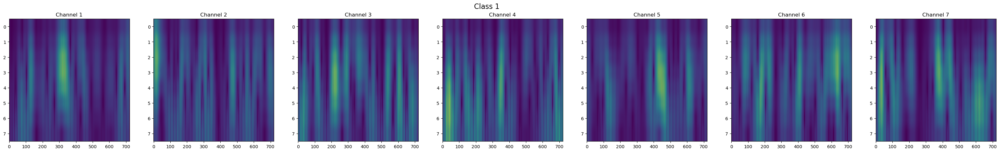

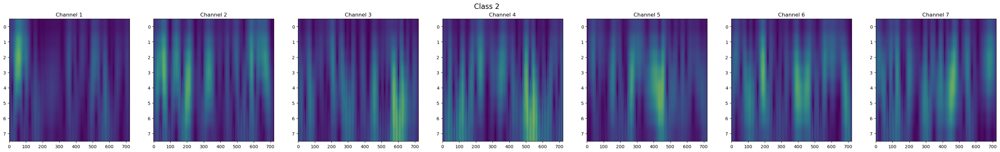

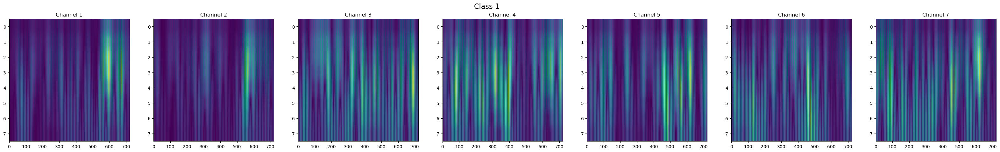

In [59]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [60]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [61]:
result = svm(X_train, X_test, y_train, y_test, target,result, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.6857142857142857
precision: 0.6835164835164835
recall: 0.6857142857142857
f1_score: 0.629824778396207
              precision    recall  f1-score   support

        rest       0.65      0.89      0.76        19
        left       0.83      1.00      0.91         5
       right       0.67      0.18      0.29        11

    accuracy                           0.69        35
   macro avg       0.72      0.69      0.65        35
weighted avg       0.68      0.69      0.63        35

Confusion matrix 
[[17  1  1]
 [ 0  5  0]
 [ 9  0  2]]



In [62]:
result = lda(X_train, X_test, y_train, y_test, target,result)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.5428571428571428
precision: 0.36753246753246754
recall: 0.5428571428571428
f1_score: 0.41664050235478806
              precision    recall  f1-score   support

        rest       0.55      0.95      0.69        19
        left       0.50      0.20      0.29         5
       right       0.00      0.00      0.00        11

    accuracy                           0.54        35
   macro avg       0.35      0.38      0.33        35
weighted avg       0.37      0.54      0.42        35

Confusion matrix 
[[18  1  0]
 [ 4  1  0]
 [11  0  0]]



In [63]:
result = logistic_regression(X_train, X_test, y_train, y_test, target,result)

============ logistic_regression ============
Accuracy: 0.6571428571428571
precision: 0.6589931972789116
recall: 0.6571428571428571
f1_score: 0.6036487322201608
              precision    recall  f1-score   support

        rest       0.64      0.84      0.73        19
        left       0.71      1.00      0.83         5
       right       0.67      0.18      0.29        11

    accuracy                           0.66        35
   macro avg       0.67      0.67      0.62        35
weighted avg       0.66      0.66      0.60        35

Confusion matrix 
[[16  2  1]
 [ 0  5  0]
 [ 9  0  2]]



In [64]:
result = naive(X_train, X_test, y_train, y_test, target,result)

============ naive bayes ============
Accuracy: 0.5714285714285714
precision: 0.6886970172684458
recall: 0.5714285714285714
f1_score: 0.53003663003663
              precision    recall  f1-score   support

        rest       0.58      0.79      0.67        19
        left       0.43      0.60      0.50         5
       right       1.00      0.18      0.31        11

    accuracy                           0.57        35
   macro avg       0.67      0.52      0.49        35
weighted avg       0.69      0.57      0.53        35

Confusion matrix 
[[15  4  0]
 [ 2  3  0]
 [ 9  0  2]]



In [65]:
result = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.5428571428571428
precision: 0.5054154995331466
recall: 0.5428571428571428
f1_score: 0.5136288998357964
              precision    recall  f1-score   support

        rest       0.71      0.63      0.67        19
        left       0.00      0.00      0.00         5
       right       0.39      0.64      0.48        11

    accuracy                           0.54        35
   macro avg       0.36      0.42      0.38        35
weighted avg       0.51      0.54      0.51        35

Confusion matrix 
[[12  0  7]
 [ 1  0  4]
 [ 4  0  7]]



In [66]:
#create model
model = Sequential()
#add model layers
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 128)               5168256   
                                                                 
 dense_12 (Dense)            (None, 32)                4128      
                                                                 
 dense_13 (Dense)            (None, 8)                 264       
                                                                 
 dense_14 (Dense)            (None, 3)                 27        
                                                                 
Total params: 5,172,675
Trainable params: 5,172,675
Non-trainable params: 0
_________________________________________________________________


In [67]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 735ms/step - loss: 1.3590 - accuracy: 0.3462 - val_loss: 6.7674 - val_accuracy: 0.5429
Epoch 2/50
1/1 [==============================] - 0s 63ms/step - loss: 6.8018 - accuracy: 0.4423 - val_loss: 4.4994 - val_accuracy: 0.5429
Epoch 3/50
1/1 [==============================] - 0s 96ms/step - loss: 3.7496 - accuracy: 0.4231 - val_loss: 12.8068 - val_accuracy: 0.1429
Epoch 4/50
1/1 [==============================] - 0s 97ms/step - loss: 9.3057 - accuracy: 0.3462 - val_loss: 1.0987 - val_accuracy: 0.3143
Epoch 5/50
1/1 [==============================] - 0s 102ms/step - loss: 1.0992 - accuracy: 0.2115 - val_loss: 1.0987 - val_accuracy: 0.3143
Epoch 6/50
1/1 [==============================] - 0s 67ms/step - loss: 1.0993 - accuracy: 0.2115 - val_loss: 1.0987 - val_accuracy: 0.3143
Epoch 7/50
1/1 [==============================] - 0s 92ms/step - loss: 1.0993 - accuracy: 0.2115 - val_loss: 1.0986 - val_accuracy: 0.3143
Epoch 8/50
1/1 [========

2/2 [==============================] - 0s 6ms/step
Accuracy: 0.5428571428571428
precision: 0.2946938775510204
recall: 0.5428571428571428
f1_score: 0.382010582010582
              precision    recall  f1-score   support

        rest       0.54      1.00      0.70        19
        left       0.00      0.00      0.00         5
       right       0.00      0.00      0.00        11

    accuracy                           0.54        35
   macro avg       0.18      0.33      0.23        35
weighted avg       0.29      0.54      0.38        35

Confusion matrix 
[[19  0  0]
 [ 5  0  0]
 [11  0  0]]
Test loss: 1.0941524505615234
Test accuracy: 0.5428571701049805


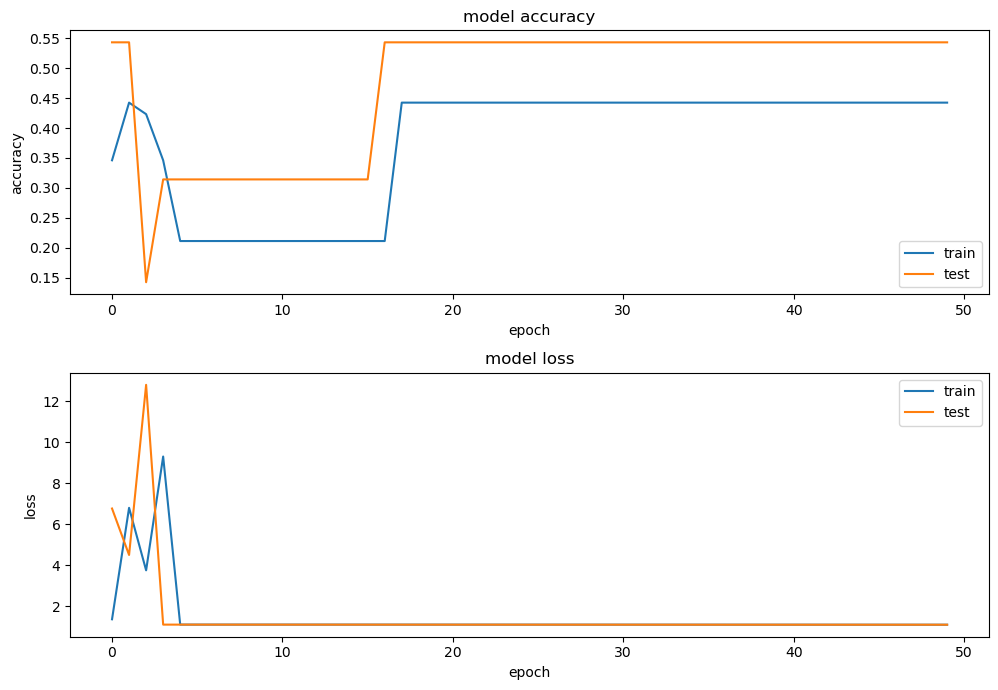

In [68]:
result = nn_report(y_test_encoded,history, X_test, target,result, numclass , model)

In [69]:
# Split data into training and test sets
X_train, X_test,y_train, y_test = train_test_split(train_data_cwt,y, test_size=0.4, random_state=56, shuffle=False)

# Convert arrays to DataFrames
X_train_df = pd.DataFrame(X_train.reshape(X_train.shape[0], -1))
X_test_df = pd.DataFrame(X_test.reshape(X_test.shape[0], -1))

In [70]:
X_train.shape

(52, 7, 8, 721)

In [71]:
model = models.Sequential()
model.add(layers.Conv2D(32, (2, 2), activation='relu', input_shape=(7, 8, 721)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(16, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dense(10))

model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = model.fit(X_train, y_train, epochs=50,batch_size = X_train.shape[0],validation_data=(X_test, y_test))

Epoch 1/50
1/1 [==============================] - 1s 930ms/step - loss: 3.8513 - accuracy: 0.0000e+00 - val_loss: 2.6378 - val_accuracy: 0.0000e+00
Epoch 2/50
1/1 [==============================] - 0s 62ms/step - loss: 2.9981 - accuracy: 0.0192 - val_loss: 2.3911 - val_accuracy: 0.4571
Epoch 3/50
1/1 [==============================] - 0s 59ms/step - loss: 2.3186 - accuracy: 0.4615 - val_loss: 1.8626 - val_accuracy: 0.4286
Epoch 4/50
1/1 [==============================] - 0s 143ms/step - loss: 1.7070 - accuracy: 0.5000 - val_loss: 1.9137 - val_accuracy: 0.2571
Epoch 5/50
1/1 [==============================] - 0s 50ms/step - loss: 1.6872 - accuracy: 0.2692 - val_loss: 1.3070 - val_accuracy: 0.3714
Epoch 6/50
1/1 [==============================] - 0s 84ms/step - loss: 1.0836 - accuracy: 0.4615 - val_loss: 1.2392 - val_accuracy: 0.4857
Epoch 7/50
1/1 [==============================] - 0s 122ms/step - loss: 1.0529 - accuracy: 0.5385 - val_loss: 1.2176 - val_accuracy: 0.5143
Epoch 8/50
1/1 [

2/2 - 0s - loss: 0.8567 - accuracy: 0.5429 - 51ms/epoch - 26ms/step


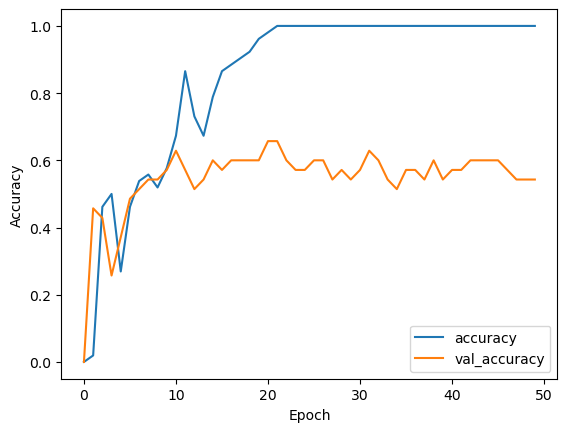

In [72]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

test_loss, test_acc = model.evaluate(X_test,  y_test, verbose=2)

In [73]:
score_train = model.evaluate(X_train, y_train, verbose=0)
print("Train loss:", score_train[0])
print("Train accuracy:", score_train[1])

Train loss: 0.01818736456334591
Train accuracy: 1.0


In [76]:
re = [[],[],[],[]]

2/2 [==============================] - 0s 4ms/step


[1 3 1 3 1 1 2 1 3 3 3 1 2 3 1 1 2 3 1 3 1 1 1 1 1 1 3 1 1 1 1 1 2 1 3]
(35,)
Accuracy: 0.5428571428571428
precision: 0.5321088435374149
recall: 0.5428571428571428
f1_score: 0.5197223828802776
              precision    recall  f1-score   support

        rest       0.62      0.76      0.68        17
        left       0.50      0.22      0.31         9
       right       0.40      0.44      0.42         9

    accuracy                           0.54        35
   macro avg       0.51      0.48      0.47        35
weighted avg       0.53      0.54      0.52        35

Confusion matrix 
[[13  0  4]
 [ 5  2  2]
 [ 3  2  4]]
Test loss: 0.8566815257072449
Test accuracy: 0.5428571701049805


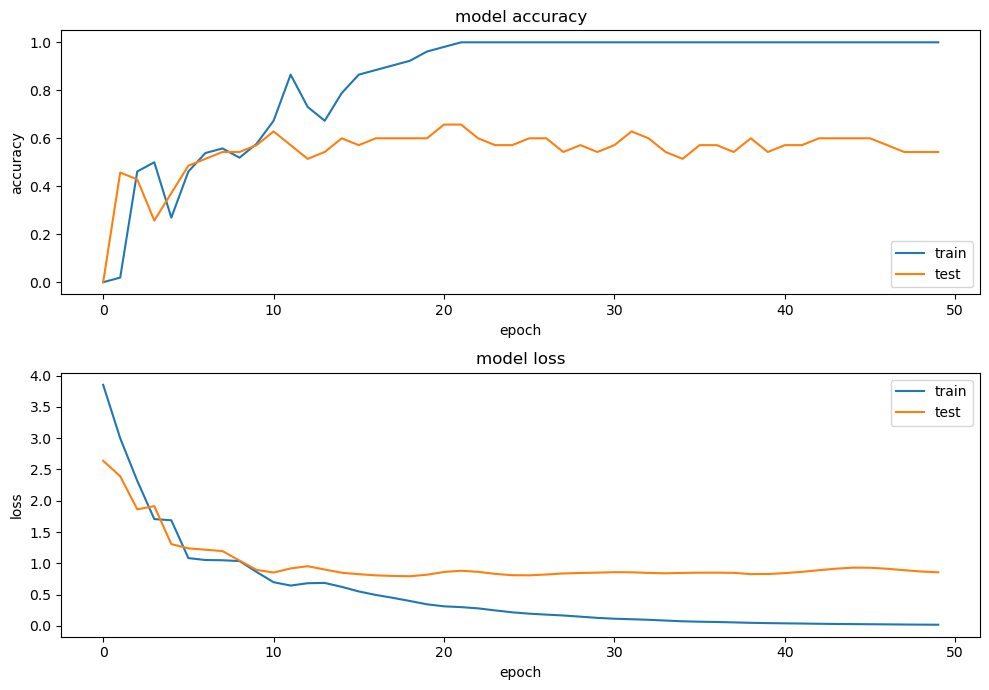

In [78]:
y_test_encoded = pd.get_dummies(y_test, columns=[1, 2])
actual_classes_str = pd.get_dummies(y_test_encoded).idxmax(1)
actual_classes_str = pd.DataFrame(actual_classes_str, index=y_test_encoded.index)

#Predictions on the test set
predicted_classes = np.argmax(model.predict(X_test),axis=1)
predicted_classes_str = []

for i in predicted_classes:
    if i == 1:
        predicted_classes_str.append(numclass[0])
    elif i == 2:
        predicted_classes_str.append(numclass[1])
    elif i == 3:
        predicted_classes_str.append(numclass[2])

print(predicted_classes)
print(np.array(predicted_classes_str).shape)
predicted_classes_str = pd.DataFrame(predicted_classes_str,index=y_test_encoded.index)


re = report(actual_classes_str, predicted_classes_str,re,target)

score = model.evaluate(X_test, y_test, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])

# plotting the metrics
plt.figure(figsize=(10, 7))
plt.subplot(2,1,1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='lower right')

plt.subplot(2,1,2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.tight_layout()

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

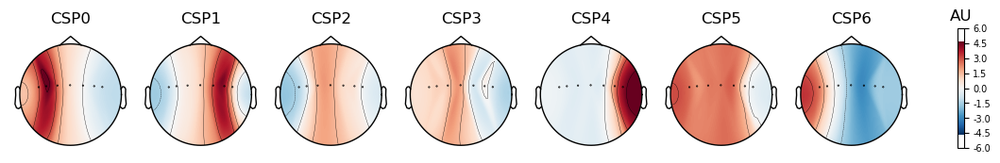

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


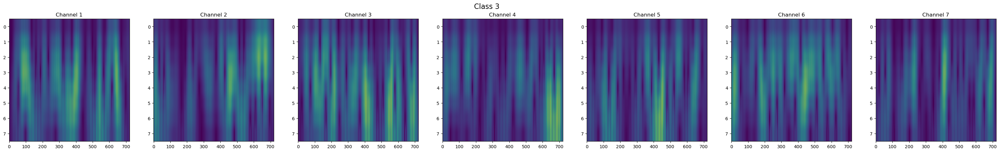

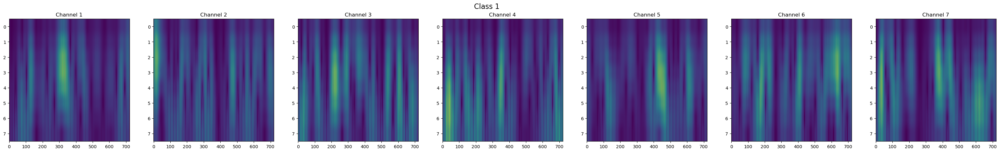

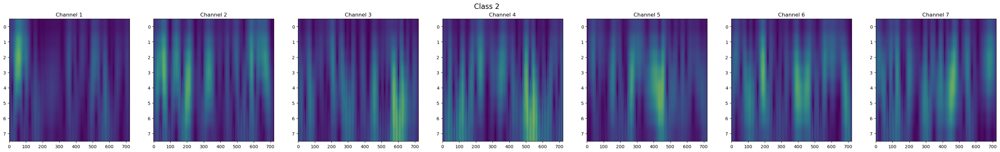

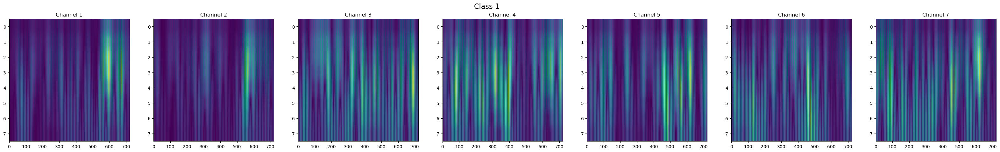

In [405]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [431]:
subset = mRMR_WT(data_WT, y,k=100)

KeyboardInterrupt: 

In [81]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56,subset=subset)

In [424]:
result = svm(X_train, X_test, y_train, y_test, target, result, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.4857142857142857
precision: 0.45373626373626375
recall: 0.4857142857142857
f1_score: 0.4480952380952381
              precision    recall  f1-score   support

        rest       0.54      0.74      0.62        19
        left       0.25      0.20      0.22         5
       right       0.40      0.18      0.25        11

    accuracy                           0.49        35
   macro avg       0.40      0.37      0.36        35
weighted avg       0.45      0.49      0.45        35

Confusion matrix 
[[14  3  2]
 [ 3  1  1]
 [ 9  0  2]]



In [425]:
result = lda(X_train, X_test, y_train, y_test, target, result)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.4857142857142857
precision: 0.4857142857142857
recall: 0.4857142857142857
f1_score: 0.47809523809523813
              precision    recall  f1-score   support

        rest       0.57      0.63      0.60        19
        left       0.29      0.40      0.33         5
       right       0.43      0.27      0.33        11

    accuracy                           0.49        35
   macro avg       0.43      0.43      0.42        35
weighted avg       0.49      0.49      0.48        35

Confusion matrix 
[[12  3  4]
 [ 3  2  0]
 [ 6  2  3]]



In [426]:
result = logistic_regression(X_train, X_test, y_train, y_test, target, result)

============ logistic_regression ============
Accuracy: 0.4857142857142857
precision: 0.45373626373626375
recall: 0.4857142857142857
f1_score: 0.4480952380952381
              precision    recall  f1-score   support

        rest       0.54      0.74      0.62        19
        left       0.25      0.20      0.22         5
       right       0.40      0.18      0.25        11

    accuracy                           0.49        35
   macro avg       0.40      0.37      0.36        35
weighted avg       0.45      0.49      0.45        35

Confusion matrix 
[[14  3  2]
 [ 3  1  1]
 [ 9  0  2]]



In [427]:
result = naive(X_train, X_test, y_train, y_test, target,result)

============ naive bayes ============
Accuracy: 0.5714285714285714
precision: 0.6886970172684458
recall: 0.5714285714285714
f1_score: 0.53003663003663
              precision    recall  f1-score   support

        rest       0.58      0.79      0.67        19
        left       0.43      0.60      0.50         5
       right       1.00      0.18      0.31        11

    accuracy                           0.57        35
   macro avg       0.67      0.52      0.49        35
weighted avg       0.69      0.57      0.53        35

Confusion matrix 
[[15  4  0]
 [ 2  3  0]
 [ 9  0  2]]



In [428]:
result = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.5428571428571428
precision: 0.5054154995331466
recall: 0.5428571428571428
f1_score: 0.5136288998357964
              precision    recall  f1-score   support

        rest       0.71      0.63      0.67        19
        left       0.00      0.00      0.00         5
       right       0.39      0.64      0.48        11

    accuracy                           0.54        35
   macro avg       0.36      0.42      0.38        35
weighted avg       0.51      0.54      0.51        35

Confusion matrix 
[[12  0  7]
 [ 1  0  4]
 [ 4  0  7]]



In [429]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3, activation='softmax'))

model.summary()

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_78 (Dense)            (None, 64)                64064     
                                                                 
 dense_79 (Dense)            (None, 32)                2080      
                                                                 
 dense_80 (Dense)            (None, 16)                528       
                                                                 
 dense_81 (Dense)            (None, 3)                 51        
                                                                 
Total params: 66,723
Trainable params: 66,723
Non-trainable params: 0
_________________________________________________________________


In [430]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50


ValueError: in user code:

    File "c:\Anaconda\lib\site-packages\keras\engine\training.py", line 1160, in train_function  *
        return step_function(self, iterator)
    File "c:\Anaconda\lib\site-packages\keras\engine\training.py", line 1146, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "c:\Anaconda\lib\site-packages\keras\engine\training.py", line 1135, in run_step  **
        outputs = model.train_step(data)
    File "c:\Anaconda\lib\site-packages\keras\engine\training.py", line 993, in train_step
        y_pred = self(x, training=True)
    File "c:\Anaconda\lib\site-packages\keras\utils\traceback_utils.py", line 70, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "c:\Anaconda\lib\site-packages\keras\engine\input_spec.py", line 295, in assert_input_compatibility
        raise ValueError(

    ValueError: Input 0 of layer "sequential_21" is incompatible with the layer: expected shape=(None, 1000), found shape=(52, 40376)


2/2 [==============================] - 0s 5ms/step
Accuracy: 0.9142857142857143
precision: 0.9326530612244897
recall: 0.9142857142857143
f1_score: 0.9157551020408163
              precision    recall  f1-score   support

        rest       1.00      0.84      0.91        19
        left       1.00      1.00      1.00         5
       right       0.79      1.00      0.88        11

    accuracy                           0.91        35
   macro avg       0.93      0.95      0.93        35
weighted avg       0.93      0.91      0.92        35

Confusion matrix 
[[16  0  3]
 [ 0  5  0]
 [ 0  0 11]]
Test loss: 0.34402352571487427
Test accuracy: 0.9142857193946838


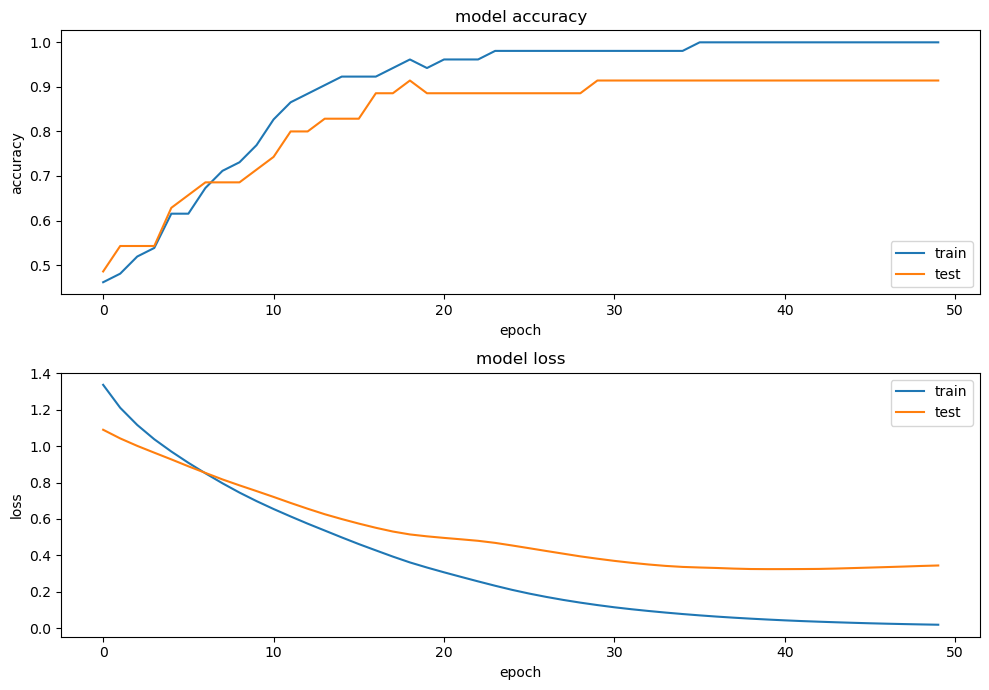

In [89]:
result = nn_report(y_test_encoded,history, X_test, target, result, numclass , model)

## **left right**

In [90]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'left': 2, 'right': 3}
target = ['left','right']
numclass = [2,3]

In [91]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took 7

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 14 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating reject

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

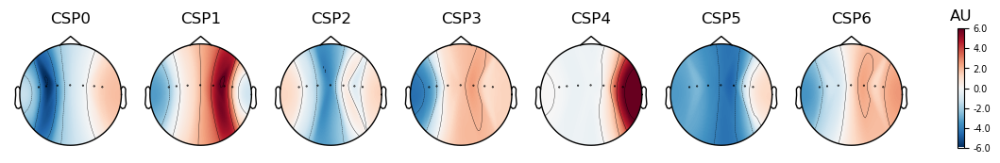

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [92]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [93]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [94]:
result_mi = [[],[],[],[]]

In [95]:
result_mi = svm(X_train, X_test, y_train, y_test, target, result_mi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.7222222222222222
precision: 0.759018759018759
recall: 0.7222222222222222
f1_score: 0.7196422428620571
              precision    recall  f1-score   support

        left       0.86      0.60      0.71        10
       right       0.64      0.88      0.74         8

    accuracy                           0.72        18
   macro avg       0.75      0.74      0.72        18
weighted avg       0.76      0.72      0.72        18

Confusion matrix 
[[6 4]
 [1 7]]



In [96]:
result_mi = lda(X_train, X_test, y_train, y_test, target,result_mi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.7222222222222222
precision: 0.759018759018759
recall: 0.7222222222222222
f1_score: 0.7196422428620571
              precision    recall  f1-score   support

        left       0.86      0.60      0.71        10
       right       0.64      0.88      0.74         8

    accuracy                           0.72        18
   macro avg       0.75      0.74      0.72        18
weighted avg       0.76      0.72      0.72        18

Confusion matrix 
[[6 4]
 [1 7]]



In [97]:
result_mi = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi)

============ logistic_regression ============
Accuracy: 0.8888888888888888
precision: 0.8888888888888888
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.90      0.90      0.90        10
       right       0.88      0.88      0.88         8

    accuracy                           0.89        18
   macro avg       0.89      0.89      0.89        18
weighted avg       0.89      0.89      0.89        18

Confusion matrix 
[[9 1]
 [1 7]]



In [98]:
result_mi = naive(X_train, X_test, y_train, y_test, target, result_mi)

============ naive bayes ============
Accuracy: 0.7777777777777778
precision: 0.7972222222222222
recall: 0.7777777777777778
f1_score: 0.7777777777777777
              precision    recall  f1-score   support

        left       0.88      0.70      0.78        10
       right       0.70      0.88      0.78         8

    accuracy                           0.78        18
   macro avg       0.79      0.79      0.78        18
weighted avg       0.80      0.78      0.78        18

Confusion matrix 
[[7 3]
 [1 7]]



In [99]:
result_mi = knn(X_train, X_test, y_train, y_test, target, result_mi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.8333333333333334
precision: 0.8395061728395061
recall: 0.8333333333333334
f1_score: 0.8338493292053665
              precision    recall  f1-score   support

        left       0.89      0.80      0.84        10
       right       0.78      0.88      0.82         8

    accuracy                           0.83        18
   macro avg       0.83      0.84      0.83        18
weighted avg       0.84      0.83      0.83        18

Confusion matrix 
[[8 2]
 [1 7]]



In [100]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_21 (Dense)            (None, 32)                256       
                                                                 
 dense_22 (Dense)            (None, 16)                528       
                                                                 
 dense_23 (Dense)            (None, 2)                 34        
                                                                 
Total params: 818
Trainable params: 818
Non-trainable params: 0
_________________________________________________________________


In [101]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 0.6983 - accuracy: 0.5185 - val_loss: 0.7164 - val_accuracy: 0.4444
Epoch 2/50
1/1 [==============================] - 0s 42ms/step - loss: 0.6952 - accuracy: 0.4444 - val_loss: 0.7134 - val_accuracy: 0.4444
Epoch 3/50
1/1 [==============================] - 0s 41ms/step - loss: 0.6924 - accuracy: 0.4815 - val_loss: 0.7101 - val_accuracy: 0.3889
Epoch 4/50
1/1 [==============================] - 0s 41ms/step - loss: 0.6899 - accuracy: 0.4815 - val_loss: 0.7068 - val_accuracy: 0.5000
Epoch 5/50
1/1 [==============================] - 0s 41ms/step - loss: 0.6875 - accuracy: 0.4815 - val_loss: 0.7033 - val_accuracy: 0.6667
Epoch 6/50
1/1 [==============================] - 0s 43ms/step - loss: 0.6852 - accuracy: 0.4815 - val_loss: 0.7007 - val_accuracy: 0.6667
Epoch 7/50
1/1 [==============================] - 0s 40ms/step - loss: 0.6826 - accuracy: 0.5185 - val_loss: 0.6983 - val_accuracy: 0.5556
Epoch 8/50
1/1 [=============

1/1 [==============================] - 0s 100ms/step
Accuracy: 0.7777777777777778
precision: 0.7972222222222222
recall: 0.7777777777777778
f1_score: 0.7777777777777777
              precision    recall  f1-score   support

        left       0.88      0.70      0.78        10
       right       0.70      0.88      0.78         8

    accuracy                           0.78        18
   macro avg       0.79      0.79      0.78        18
weighted avg       0.80      0.78      0.78        18

Confusion matrix 
[[7 3]
 [1 7]]
Test loss: 0.5495148301124573
Test accuracy: 0.7777777910232544


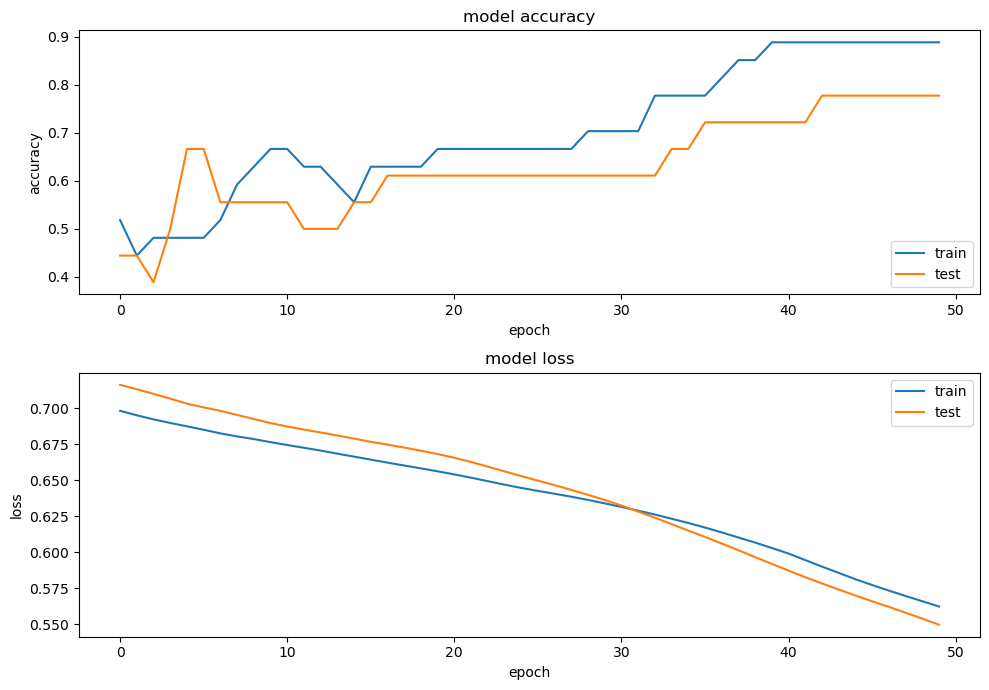

In [102]:
result_mi = nn_report(y_test_encoded,history, X_test, target, result_mi, numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

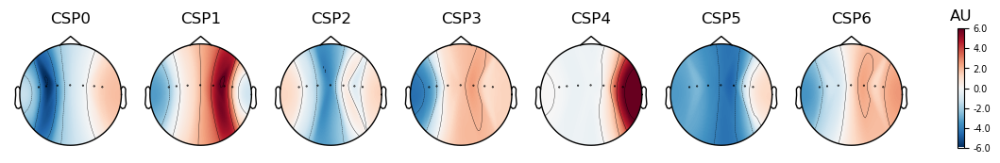

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [103]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [104]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[0,1])

In [105]:
result_mi = svm(X_train, X_test, y_train, y_test, target, result_mi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.8888888888888888
precision: 0.8888888888888888
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.90      0.90      0.90        10
       right       0.88      0.88      0.88         8

    accuracy                           0.89        18
   macro avg       0.89      0.89      0.89        18
weighted avg       0.89      0.89      0.89        18

Confusion matrix 
[[9 1]
 [1 7]]



In [106]:
result_mi = lda(X_train, X_test, y_train, y_test, target, result_mi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.8888888888888888
precision: 0.8888888888888888
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.90      0.90      0.90        10
       right       0.88      0.88      0.88         8

    accuracy                           0.89        18
   macro avg       0.89      0.89      0.89        18
weighted avg       0.89      0.89      0.89        18

Confusion matrix 
[[9 1]
 [1 7]]



In [107]:
result_mi = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi)

============ logistic_regression ============
Accuracy: 0.8888888888888888
precision: 0.8888888888888888
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.90      0.90      0.90        10
       right       0.88      0.88      0.88         8

    accuracy                           0.89        18
   macro avg       0.89      0.89      0.89        18
weighted avg       0.89      0.89      0.89        18

Confusion matrix 
[[9 1]
 [1 7]]



In [108]:
result_mi = naive(X_train, X_test, y_train, y_test, target, result_mi)

============ naive bayes ============
Accuracy: 0.8333333333333334
precision: 0.8395061728395061
recall: 0.8333333333333334
f1_score: 0.8338493292053665
              precision    recall  f1-score   support

        left       0.89      0.80      0.84        10
       right       0.78      0.88      0.82         8

    accuracy                           0.83        18
   macro avg       0.83      0.84      0.83        18
weighted avg       0.84      0.83      0.83        18

Confusion matrix 
[[8 2]
 [1 7]]



In [109]:
result_mi = knn(X_train, X_test, y_train, y_test, target, result_mi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.8333333333333334
precision: 0.8395061728395061
recall: 0.8333333333333334
f1_score: 0.8338493292053665
              precision    recall  f1-score   support

        left       0.89      0.80      0.84        10
       right       0.78      0.88      0.82         8

    accuracy                           0.83        18
   macro avg       0.83      0.84      0.83        18
weighted avg       0.84      0.83      0.83        18

Confusion matrix 
[[8 2]
 [1 7]]



In [110]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_24 (Dense)            (None, 32)                96        
                                                                 
 dense_25 (Dense)            (None, 16)                528       
                                                                 
 dense_26 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [111]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 661ms/step - loss: 0.7239 - accuracy: 0.4074 - val_loss: 0.7497 - val_accuracy: 0.3889
Epoch 2/100
1/1 [==============================] - 0s 37ms/step - loss: 0.7202 - accuracy: 0.3704 - val_loss: 0.7460 - val_accuracy: 0.3889
Epoch 3/100
1/1 [==============================] - 0s 41ms/step - loss: 0.7165 - accuracy: 0.3704 - val_loss: 0.7420 - val_accuracy: 0.3889
Epoch 4/100
1/1 [==============================] - 0s 38ms/step - loss: 0.7129 - accuracy: 0.4074 - val_loss: 0.7378 - val_accuracy: 0.3889
Epoch 5/100
1/1 [==============================] - 0s 40ms/step - loss: 0.7094 - accuracy: 0.4444 - val_loss: 0.7336 - val_accuracy: 0.3889
Epoch 6/100
1/1 [==============================] - 0s 39ms/step - loss: 0.7059 - accuracy: 0.4815 - val_loss: 0.7293 - val_accuracy: 0.3889
Epoch 7/100
1/1 [==============================] - 0s 36ms/step - loss: 0.7026 - accuracy: 0.4815 - val_loss: 0.7249 - val_accuracy: 0.3889
Epoch 8/100
1/1 [==

1/1 [==============================] - 0s 83ms/step
Accuracy: 0.8888888888888888
precision: 0.8888888888888888
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.90      0.90      0.90        10
       right       0.88      0.88      0.88         8

    accuracy                           0.89        18
   macro avg       0.89      0.89      0.89        18
weighted avg       0.89      0.89      0.89        18

Confusion matrix 
[[9 1]
 [1 7]]
Test loss: 0.3627890944480896
Test accuracy: 0.8888888955116272


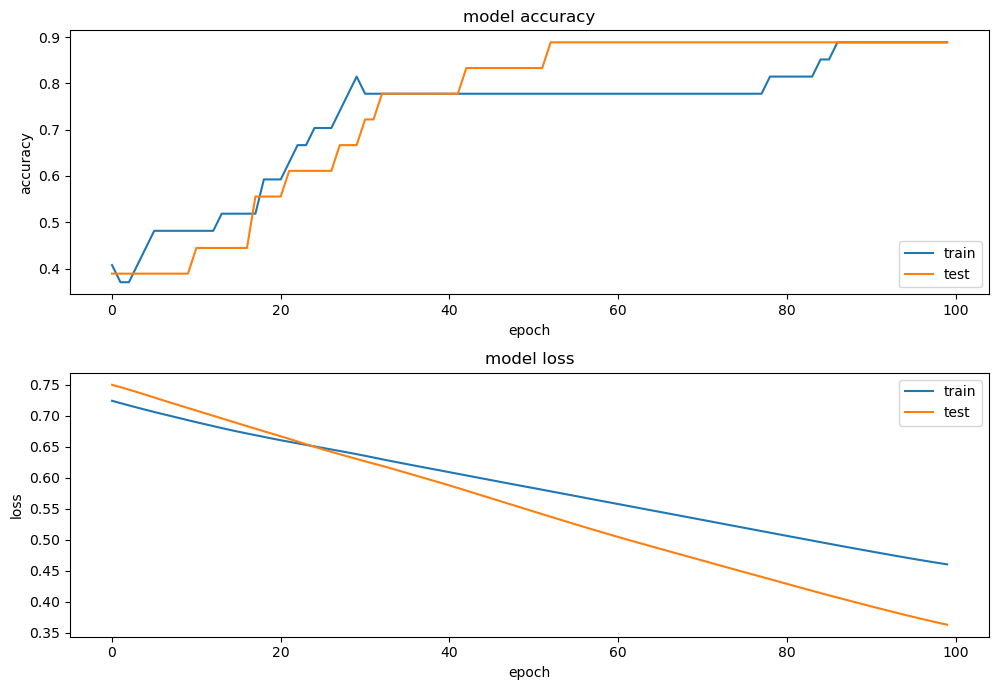

In [112]:
result_mi = nn_report(y_test_encoded,history, X_test, target, result_mi, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

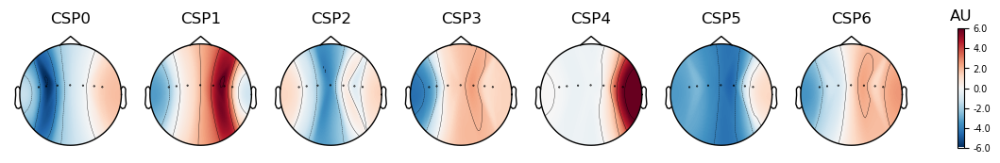

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [113]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [114]:
subset = mRMR_csp(csp,x,y,k=2)
subset

100%|██████████| 2/2 [00:01<00:00,  1.13it/s]


[0, 2]

In [115]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=subset)

In [116]:
result_mi = svm(X_train, X_test, y_train, y_test, target, result_mi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.7777777777777778
precision: 0.7972222222222222
recall: 0.7777777777777778
f1_score: 0.7777777777777777
              precision    recall  f1-score   support

        left       0.88      0.70      0.78        10
       right       0.70      0.88      0.78         8

    accuracy                           0.78        18
   macro avg       0.79      0.79      0.78        18
weighted avg       0.80      0.78      0.78        18

Confusion matrix 
[[7 3]
 [1 7]]



In [117]:
result_mi = lda(X_train, X_test, y_train, y_test, target, result_mi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.7222222222222222
precision: 0.759018759018759
recall: 0.7222222222222222
f1_score: 0.7196422428620571
              precision    recall  f1-score   support

        left       0.86      0.60      0.71        10
       right       0.64      0.88      0.74         8

    accuracy                           0.72        18
   macro avg       0.75      0.74      0.72        18
weighted avg       0.76      0.72      0.72        18

Confusion matrix 
[[6 4]
 [1 7]]



In [118]:
result_mi = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi)

============ logistic_regression ============
Accuracy: 0.7777777777777778
precision: 0.7972222222222222
recall: 0.7777777777777778
f1_score: 0.7777777777777777
              precision    recall  f1-score   support

        left       0.88      0.70      0.78        10
       right       0.70      0.88      0.78         8

    accuracy                           0.78        18
   macro avg       0.79      0.79      0.78        18
weighted avg       0.80      0.78      0.78        18

Confusion matrix 
[[7 3]
 [1 7]]



In [119]:
result_mi = naive(X_train, X_test, y_train, y_test, target, result_mi)

============ naive bayes ============
Accuracy: 0.7222222222222222
precision: 0.759018759018759
recall: 0.7222222222222222
f1_score: 0.7196422428620571
              precision    recall  f1-score   support

        left       0.86      0.60      0.71        10
       right       0.64      0.88      0.74         8

    accuracy                           0.72        18
   macro avg       0.75      0.74      0.72        18
weighted avg       0.76      0.72      0.72        18

Confusion matrix 
[[6 4]
 [1 7]]



In [120]:
result_mi = knn(X_train, X_test, y_train, y_test, target, result_mi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.7222222222222222
precision: 0.759018759018759
recall: 0.7222222222222222
f1_score: 0.7196422428620571
              precision    recall  f1-score   support

        left       0.86      0.60      0.71        10
       right       0.64      0.88      0.74         8

    accuracy                           0.72        18
   macro avg       0.75      0.74      0.72        18
weighted avg       0.76      0.72      0.72        18

Confusion matrix 
[[6 4]
 [1 7]]



In [121]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_27 (Dense)            (None, 32)                96        
                                                                 
 dense_28 (Dense)            (None, 16)                528       
                                                                 
 dense_29 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [122]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=60,batch_size = X_train.shape[0])

Epoch 1/60
1/1 [==============================] - 1s 955ms/step - loss: 0.7347 - accuracy: 0.4444 - val_loss: 0.7191 - val_accuracy: 0.3889
Epoch 2/60
1/1 [==============================] - 0s 47ms/step - loss: 0.7261 - accuracy: 0.4444 - val_loss: 0.7134 - val_accuracy: 0.3889
Epoch 3/60
1/1 [==============================] - 0s 51ms/step - loss: 0.7182 - accuracy: 0.4444 - val_loss: 0.7083 - val_accuracy: 0.3333
Epoch 4/60
1/1 [==============================] - 0s 58ms/step - loss: 0.7113 - accuracy: 0.4444 - val_loss: 0.7038 - val_accuracy: 0.3333
Epoch 5/60
1/1 [==============================] - 0s 51ms/step - loss: 0.7052 - accuracy: 0.3333 - val_loss: 0.6995 - val_accuracy: 0.2778
Epoch 6/60
1/1 [==============================] - 0s 56ms/step - loss: 0.6995 - accuracy: 0.3704 - val_loss: 0.6957 - val_accuracy: 0.5000
Epoch 7/60
1/1 [==============================] - 0s 58ms/step - loss: 0.6942 - accuracy: 0.4815 - val_loss: 0.6922 - val_accuracy: 0.4444
Epoch 8/60
1/1 [==========

1/1 [==============================] - 0s 94ms/step
Accuracy: 0.7777777777777778
precision: 0.7972222222222222
recall: 0.7777777777777778
f1_score: 0.7777777777777777
              precision    recall  f1-score   support

        left       0.88      0.70      0.78        10
       right       0.70      0.88      0.78         8

    accuracy                           0.78        18
   macro avg       0.79      0.79      0.78        18
weighted avg       0.80      0.78      0.78        18

Confusion matrix 
[[7 3]
 [1 7]]
Test loss: 0.5539844036102295
Test accuracy: 0.7777777910232544


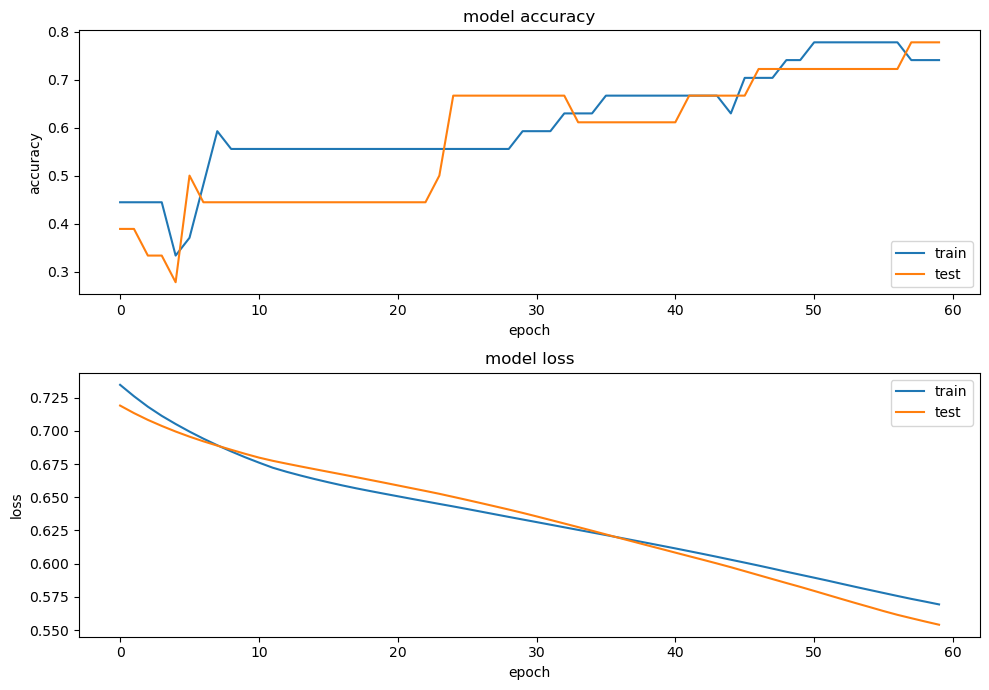

In [123]:
result_mi = nn_report(y_test_encoded,history, X_test, target, result_mi, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

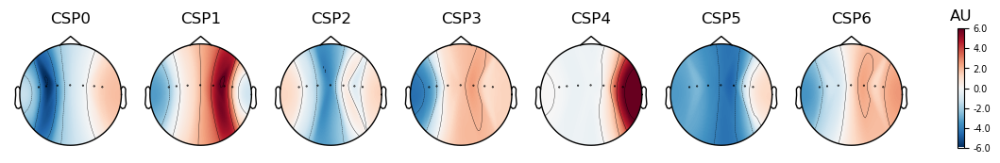

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


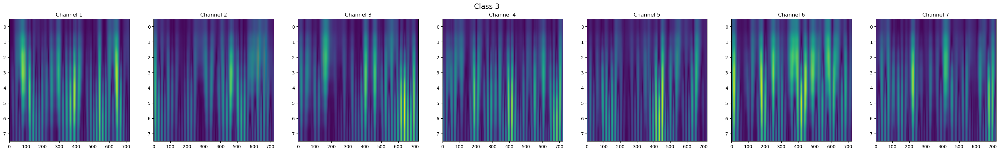

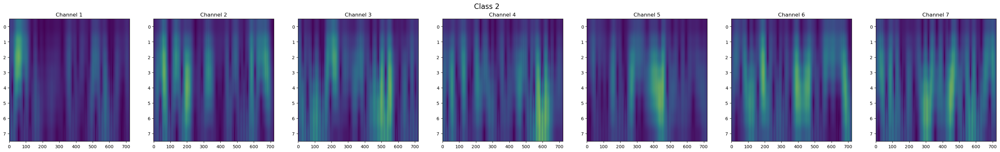

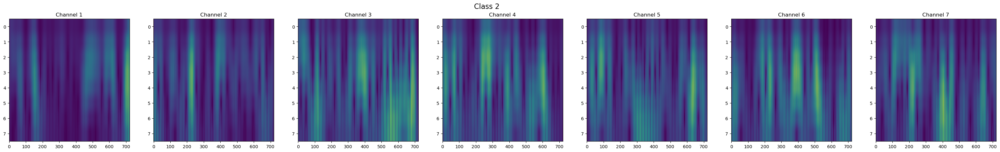

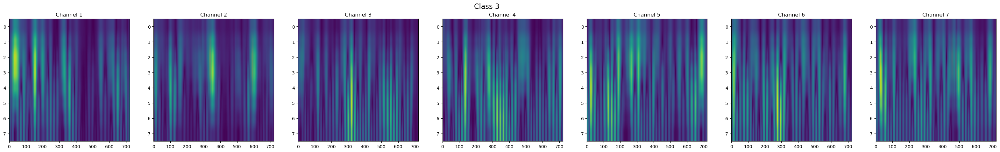

In [124]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [125]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [126]:
result_mi = svm(X_train, X_test, y_train, y_test, target,result_mi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============


Accuracy: 0.7777777777777778
precision: 0.8518518518518517
recall: 0.7777777777777778
f1_score: 0.7722222222222221
              precision    recall  f1-score   support

        left       1.00      0.60      0.75        10
       right       0.67      1.00      0.80         8

    accuracy                           0.78        18
   macro avg       0.83      0.80      0.77        18
weighted avg       0.85      0.78      0.77        18

Confusion matrix 
[[6 4]
 [0 8]]



In [127]:
result_mi = lda(X_train, X_test, y_train, y_test, target,result_mi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.5555555555555556
precision: 0.6388888888888888
recall: 0.5555555555555556
f1_score: 0.5209235209235208
              precision    recall  f1-score   support

        left       0.75      0.30      0.43        10
       right       0.50      0.88      0.64         8

    accuracy                           0.56        18
   macro avg       0.62      0.59      0.53        18
weighted avg       0.64      0.56      0.52        18

Confusion matrix 
[[3 7]
 [1 7]]



In [128]:
result_mi = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi)

============ logistic_regression ============
Accuracy: 0.8333333333333334
precision: 0.8787878787878788
recall: 0.8333333333333334
f1_score: 0.8317853457172342
              precision    recall  f1-score   support

        left       1.00      0.70      0.82        10
       right       0.73      1.00      0.84         8

    accuracy                           0.83        18
   macro avg       0.86      0.85      0.83        18
weighted avg       0.88      0.83      0.83        18

Confusion matrix 
[[7 3]
 [0 8]]



In [129]:
result_mi = naive(X_train, X_test, y_train, y_test, target, result_mi)

============ naive bayes ============
Accuracy: 0.7222222222222222
precision: 0.7283950617283951
recall: 0.7222222222222222
f1_score: 0.7230822153422771
              precision    recall  f1-score   support

        left       0.78      0.70      0.74        10
       right       0.67      0.75      0.71         8

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weighted avg       0.73      0.72      0.72        18

Confusion matrix 
[[7 3]
 [2 6]]



In [130]:
result_mi = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_mi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.5
precision: 0.7647058823529412
recall: 0.5
f1_score: 0.38545454545454544
              precision    recall  f1-score   support

        left       1.00      0.10      0.18        10
       right       0.47      1.00      0.64         8

    accuracy                           0.50        18
   macro avg       0.74      0.55      0.41        18
weighted avg       0.76      0.50      0.39        18

Confusion matrix 
[[1 9]
 [0 8]]



In [131]:
#create model
model = Sequential()
#add model layers
model.add(Dense(512, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_30 (Dense)            (None, 512)               20673024  
                                                                 
 dense_31 (Dense)            (None, 128)               65664     
                                                                 
 dense_32 (Dense)            (None, 32)                4128      
                                                                 
 dense_33 (Dense)            (None, 8)                 264       
                                                                 
 dense_34 (Dense)            (None, 2)                 18        
                                                                 
Total params: 20,743,098
Trainable params: 20,743,098
Non-trainable params: 0
_________________________________________________________________


In [132]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=70,batch_size = X_train.shape[0])

Epoch 1/70
1/1 [==============================] - 1s 1s/step - loss: 1.1209 - accuracy: 0.4815 - val_loss: 9.1798 - val_accuracy: 0.5556
Epoch 2/70
1/1 [==============================] - 0s 66ms/step - loss: 10.0634 - accuracy: 0.4815 - val_loss: 12.5028 - val_accuracy: 0.5556
Epoch 3/70
1/1 [==============================] - 0s 67ms/step - loss: 14.2496 - accuracy: 0.4815 - val_loss: 1.7360 - val_accuracy: 0.5556
Epoch 4/70
1/1 [==============================] - 0s 69ms/step - loss: 1.9020 - accuracy: 0.4815 - val_loss: 1.5003 - val_accuracy: 0.4444
Epoch 5/70
1/1 [==============================] - 0s 66ms/step - loss: 1.3443 - accuracy: 0.5185 - val_loss: 1.7343 - val_accuracy: 0.4444
Epoch 6/70
1/1 [==============================] - 0s 65ms/step - loss: 1.5502 - accuracy: 0.5185 - val_loss: 8.9659 - val_accuracy: 0.4444
Epoch 7/70
1/1 [==============================] - 0s 65ms/step - loss: 7.7851 - accuracy: 0.5185 - val_loss: 2.1700 - val_accuracy: 0.4444
Epoch 8/70
1/1 [==========

1/1 [==============================] - 0s 117ms/step
Accuracy: 0.5555555555555556
precision: 0.30864197530864196
recall: 0.5555555555555556
f1_score: 0.39682539682539686
              precision    recall  f1-score   support

        left       0.56      1.00      0.71        10
       right       0.00      0.00      0.00         8

    accuracy                           0.56        18
   macro avg       0.28      0.50      0.36        18
weighted avg       0.31      0.56      0.40        18

Confusion matrix 
[[10  0]
 [ 8  0]]
Test loss: 0.6897857189178467
Test accuracy: 0.5555555820465088


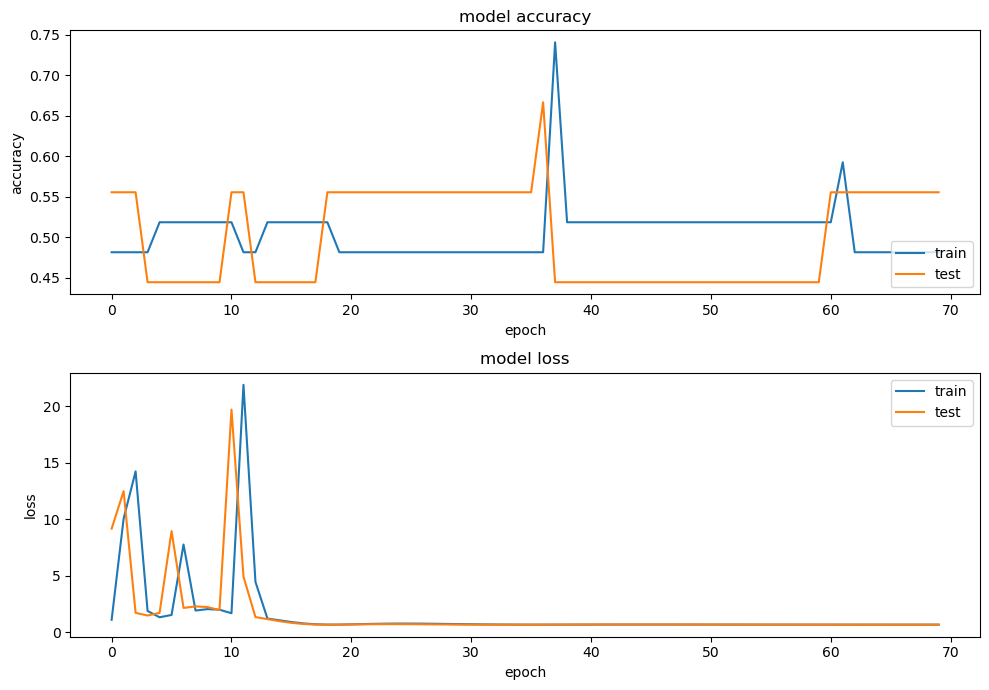

In [133]:
result_mi = nn_report(y_test_encoded,history, X_test, target, result_mi, numclass , model)

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

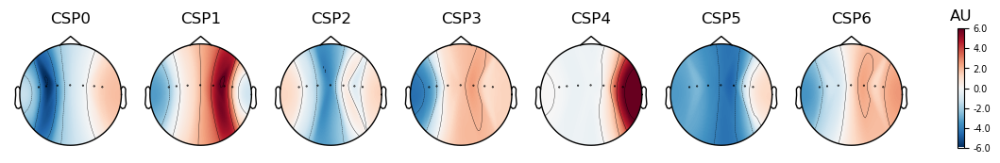

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


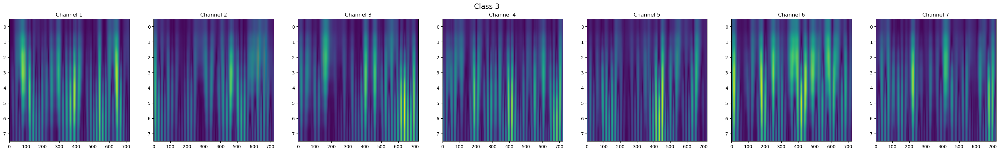

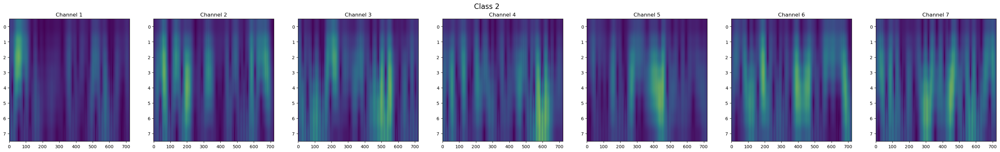

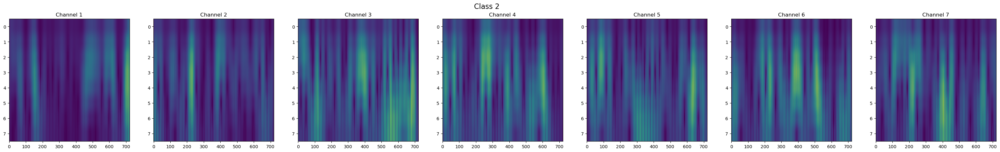

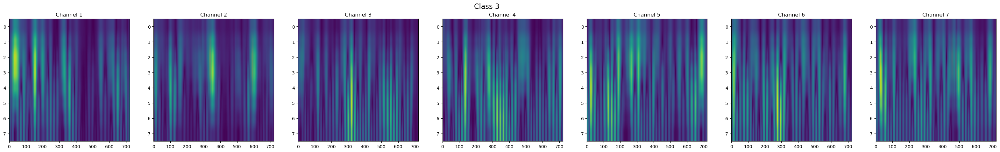

In [134]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [135]:
subset = mRMR_WT(data_WT, y,k=100)

100%|██████████| 100/100 [02:31<00:00,  1.52s/it]


[34820, 19905, 28972, 26996, 17654, 24911, 2955, 38861, 12165, 35541, 2856, 30009, 26092, 36257, 17735, 29288, 22504, 5157, 6127, 34826, 31849, 20426, 17741, 36978, 21, 382, 717, 20052, 6848, 34833, 5646, 34494, 17861, 30375, 34832, 6121, 25326, 787, 25371, 35547, 18456, 711, 6133, 35536, 27724, 36281, 1439, 26047, 376, 1502, 22657, 30002, 17747, 9, 6444, 5165, 31096, 6854, 35554, 1508, 34485, 3577, 34814, 26947, 5638, 34167, 35560, 25412, 17753, 27667, 20773, 6115, 39590, 35553, 18462, 6842, 66, 35535, 17867, 1432, 34839, 23849, 554, 34486, 4925, 34827, 21783, 781, 29281, 35529, 718, 1097, 23405, 730, 560, 6109, 2223, 17868, 35548, 33773]


In [136]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56,subset=subset)

In [137]:
result_mi = svm(X_train, X_test, y_train, y_test, target, result_mi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        10
       right       1.00      1.00      1.00         8

    accuracy                           1.00        18
   macro avg       1.00      1.00      1.00        18
weighted avg       1.00      1.00      1.00        18

Confusion matrix 
[[10  0]
 [ 0  8]]



In [138]:
result_mi = lda(X_train, X_test, y_train, y_test, target, result_mi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        10
       right       1.00      1.00      1.00         8

    accuracy                           1.00        18
   macro avg       1.00      1.00      1.00        18
weighted avg       1.00      1.00      1.00        18

Confusion matrix 
[[10  0]
 [ 0  8]]



In [139]:
result_mi = logistic_regression(X_train, X_test, y_train, y_test, target,result_mi)

============ logistic_regression ============
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        10
       right       1.00      1.00      1.00         8

    accuracy                           1.00        18
   macro avg       1.00      1.00      1.00        18
weighted avg       1.00      1.00      1.00        18

Confusion matrix 
[[10  0]
 [ 0  8]]



In [140]:
result_mi = naive(X_train, X_test, y_train, y_test, target, result_mi)

============ naive bayes ============
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        10
       right       1.00      1.00      1.00         8

    accuracy                           1.00        18
   macro avg       1.00      1.00      1.00        18
weighted avg       1.00      1.00      1.00        18

Confusion matrix 
[[10  0]
 [ 0  8]]



In [141]:
result_mi = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target,result_mi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        10
       right       1.00      1.00      1.00         8

    accuracy                           1.00        18
   macro avg       1.00      1.00      1.00        18
weighted avg       1.00      1.00      1.00        18

Confusion matrix 
[[10  0]
 [ 0  8]]



In [142]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_35 (Dense)            (None, 64)                6464      
                                                                 
 dense_36 (Dense)            (None, 32)                2080      
                                                                 
 dense_37 (Dense)            (None, 16)                528       
                                                                 
 dense_38 (Dense)            (None, 2)                 34        
                                                                 
Total params: 9,106
Trainable params: 9,106
Non-trainable params: 0
_________________________________________________________________


In [143]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 880ms/step - loss: 1.4242 - accuracy: 0.5185 - val_loss: 1.1621 - val_accuracy: 0.4444
Epoch 2/50
1/1 [==============================] - 0s 46ms/step - loss: 0.9981 - accuracy: 0.5185 - val_loss: 0.8755 - val_accuracy: 0.5000
Epoch 3/50
1/1 [==============================] - 0s 43ms/step - loss: 0.7464 - accuracy: 0.5185 - val_loss: 0.6871 - val_accuracy: 0.5556
Epoch 4/50
1/1 [==============================] - 0s 42ms/step - loss: 0.5950 - accuracy: 0.5926 - val_loss: 0.5938 - val_accuracy: 0.5556
Epoch 5/50
1/1 [==============================] - 0s 48ms/step - loss: 0.5009 - accuracy: 0.6296 - val_loss: 0.5400 - val_accuracy: 0.6111
Epoch 6/50
1/1 [==============================] - 0s 45ms/step - loss: 0.4490 - accuracy: 0.8148 - val_loss: 0.5063 - val_accuracy: 0.7222
Epoch 7/50
1/1 [==============================] - 0s 41ms/step - loss: 0.4164 - accuracy: 0.8889 - val_loss: 0.4834 - val_accuracy: 0.7778
Epoch 8/50
1/1 [==========

1/1 [==============================] - 0s 93ms/step
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        10
       right       1.00      1.00      1.00         8

    accuracy                           1.00        18
   macro avg       1.00      1.00      1.00        18
weighted avg       1.00      1.00      1.00        18

Confusion matrix 
[[10  0]
 [ 0  8]]
Test loss: 0.009279553778469563
Test accuracy: 1.0


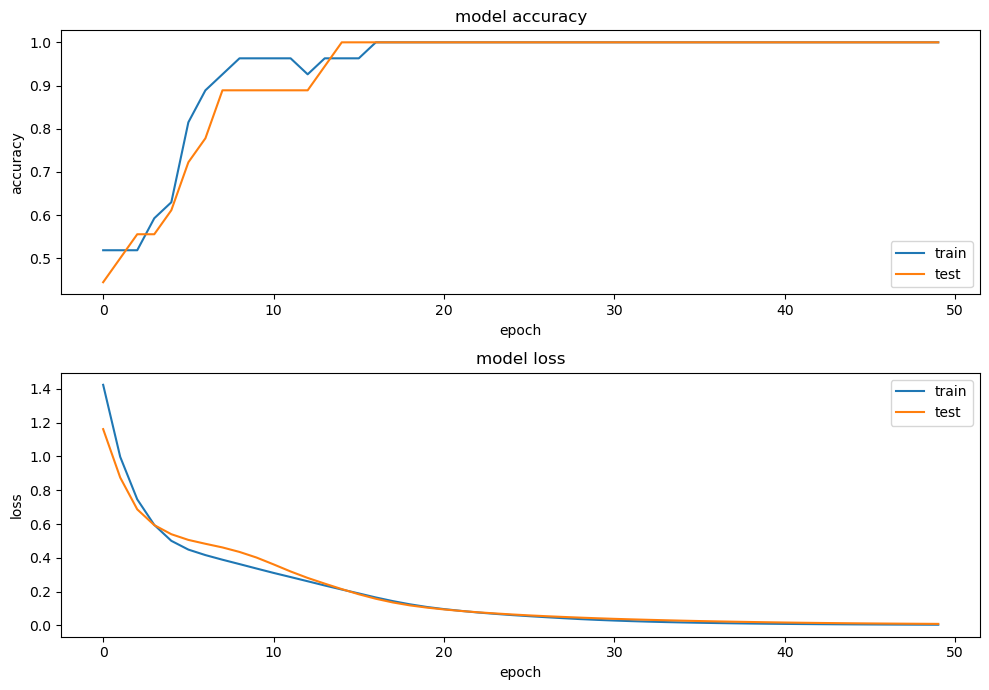

In [144]:
result_mi = nn_report(y_test_encoded,history, X_test, target, result_mi, numclass , model)

## **Non-MI MI**

In [145]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'rest':1, 'left': 2, 'right': 3}
target = ['non-MI','MI']
numclass = [1,2]

In [146]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took 6

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 14 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating reject

In [147]:
result_nonmi = [[],[],[],[]]

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

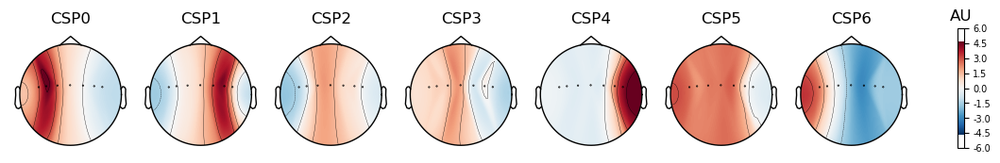

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [148]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [149]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [150]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [151]:
result_nonmi = svm(X_train, X_test, y_train, y_test, target, result_nonmi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.6285714285714286
precision: 0.6378759398496241
recall: 0.6285714285714286
f1_score: 0.6285714285714286
              precision    recall  f1-score   support

      non-MI       0.69      0.58      0.63        19
          MI       0.58      0.69      0.63        16

    accuracy                           0.63        35
   macro avg       0.63      0.63      0.63        35
weighted avg       0.64      0.63      0.63        35

Confusion matrix 
[[11  8]
 [ 5 11]]



In [152]:
result_nonmi = lda(X_train, X_test, y_train, y_test, target, result_nonmi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.5142857142857142
precision: 0.5218984962406015
recall: 0.5142857142857142
f1_score: 0.5142857142857142
              precision    recall  f1-score   support

      non-MI       0.56      0.47      0.51        19
          MI       0.47      0.56      0.51        16

    accuracy                           0.51        35
   macro avg       0.52      0.52      0.51        35
weighted avg       0.52      0.51      0.51        35

Confusion matrix 
[[ 9 10]
 [ 7  9]]



In [153]:
result_nonmi = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi)

============ logistic_regression ============
Accuracy: 0.6571428571428571
precision: 0.6723809523809523
recall: 0.6571428571428571
f1_score: 0.6560224089635853
              precision    recall  f1-score   support

      non-MI       0.73      0.58      0.65        19
          MI       0.60      0.75      0.67        16

    accuracy                           0.66        35
   macro avg       0.67      0.66      0.66        35
weighted avg       0.67      0.66      0.66        35

Confusion matrix 
[[11  8]
 [ 4 12]]



In [154]:
result_nonmi = naive(X_train, X_test, y_train, y_test, target, result_nonmi)

============ naive bayes ============
Accuracy: 0.6571428571428571
precision: 0.6625583566760038
recall: 0.6571428571428571
f1_score: 0.6577030812324931
              precision    recall  f1-score   support

      non-MI       0.71      0.63      0.67        19
          MI       0.61      0.69      0.65        16

    accuracy                           0.66        35
   macro avg       0.66      0.66      0.66        35
weighted avg       0.66      0.66      0.66        35

Confusion matrix 
[[12  7]
 [ 5 11]]



In [155]:
result_nonmi = knn(X_train, X_test, y_train, y_test, target, result_nonmi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.7428571428571429
precision: 0.7449112978524745
recall: 0.7428571428571429
f1_score: 0.7432783432783432
              precision    recall  f1-score   support

      non-MI       0.78      0.74      0.76        19
          MI       0.71      0.75      0.73        16

    accuracy                           0.74        35
   macro avg       0.74      0.74      0.74        35
weighted avg       0.74      0.74      0.74        35

Confusion matrix 
[[14  5]
 [ 4 12]]



In [156]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_39 (Dense)            (None, 32)                256       
                                                                 
 dense_40 (Dense)            (None, 16)                528       
                                                                 
 dense_41 (Dense)            (None, 2)                 34        
                                                                 
Total params: 818
Trainable params: 818
Non-trainable params: 0
_________________________________________________________________


In [157]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 544ms/step - loss: 0.6998 - accuracy: 0.5000 - val_loss: 0.6960 - val_accuracy: 0.4286
Epoch 2/50
1/1 [==============================] - 0s 35ms/step - loss: 0.6970 - accuracy: 0.5192 - val_loss: 0.6931 - val_accuracy: 0.4571
Epoch 3/50
1/1 [==============================] - 0s 34ms/step - loss: 0.6944 - accuracy: 0.5385 - val_loss: 0.6902 - val_accuracy: 0.5143
Epoch 4/50
1/1 [==============================] - 0s 35ms/step - loss: 0.6920 - accuracy: 0.5577 - val_loss: 0.6878 - val_accuracy: 0.5143
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 0.6896 - accuracy: 0.5769 - val_loss: 0.6854 - val_accuracy: 0.5143
Epoch 6/50
1/1 [==============================] - 0s 34ms/step - loss: 0.6872 - accuracy: 0.5962 - val_loss: 0.6830 - val_accuracy: 0.5143
Epoch 7/50
1/1 [==============================] - 0s 36ms/step - loss: 0.6849 - accuracy: 0.5962 - val_loss: 0.6807 - val_accuracy: 0.5143
Epoch 8/50
1/1 [==========

2/2 [==============================] - 0s 3ms/step
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]
Test loss: 0.626202404499054
Test accuracy: 0.7142857313156128


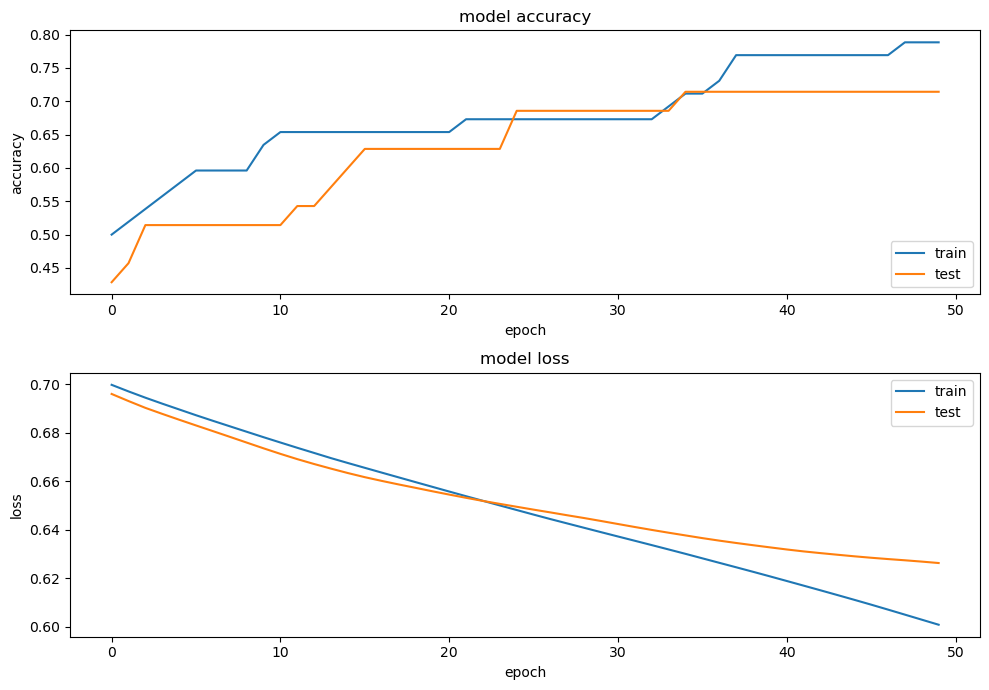

In [158]:
result_nonmi = nn_report(y_test_encoded,history, X_test, target, result_nonmi , numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

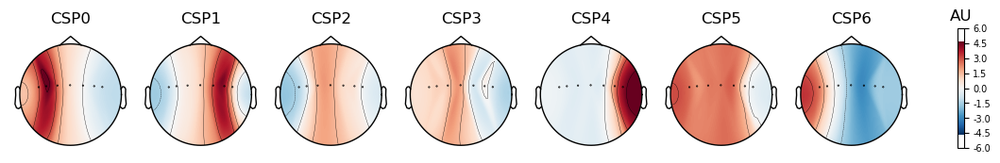

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [159]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [160]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [161]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[0,1])

In [162]:
result_nonmi = svm(X_train, X_test, y_train, y_test, target, result_nonmi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.7142857142857143
precision: 0.7502497502497503
recall: 0.7142857142857143
f1_score: 0.7100563909774437
              precision    recall  f1-score   support

      non-MI       0.85      0.58      0.69        19
          MI       0.64      0.88      0.74        16

    accuracy                           0.71        35
   macro avg       0.74      0.73      0.71        35
weighted avg       0.75      0.71      0.71        35

Confusion matrix 
[[11  8]
 [ 2 14]]



In [163]:
result_nonmi = lda(X_train, X_test, y_train, y_test, target, result_nonmi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]



In [164]:
result_nonmi = logistic_regression(X_train, X_test, y_train, y_test, target,result_nonmi)

============ logistic_regression ============
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]



In [165]:
result_nonmi = naive(X_train, X_test, y_train, y_test, target, result_nonmi)

============ naive bayes ============
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]



In [166]:
result_nonmi = knn(X_train, X_test, y_train, y_test, target, result_nonmi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.6285714285714286
precision: 0.630812324929972
recall: 0.6285714285714286
f1_score: 0.6291798291798291
              precision    recall  f1-score   support

      non-MI       0.67      0.63      0.65        19
          MI       0.59      0.62      0.61        16

    accuracy                           0.63        35
   macro avg       0.63      0.63      0.63        35
weighted avg       0.63      0.63      0.63        35

Confusion matrix 
[[12  7]
 [ 6 10]]



In [167]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_42 (Dense)            (None, 32)                96        
                                                                 
 dense_43 (Dense)            (None, 16)                528       
                                                                 
 dense_44 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [168]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 709ms/step - loss: 0.6967 - accuracy: 0.5192 - val_loss: 0.7213 - val_accuracy: 0.4286
Epoch 2/100
1/1 [==============================] - 0s 40ms/step - loss: 0.6948 - accuracy: 0.5192 - val_loss: 0.7173 - val_accuracy: 0.4571
Epoch 3/100
1/1 [==============================] - 0s 38ms/step - loss: 0.6928 - accuracy: 0.5192 - val_loss: 0.7136 - val_accuracy: 0.4571
Epoch 4/100
1/1 [==============================] - 0s 39ms/step - loss: 0.6910 - accuracy: 0.5577 - val_loss: 0.7100 - val_accuracy: 0.4571
Epoch 5/100
1/1 [==============================] - 0s 40ms/step - loss: 0.6892 - accuracy: 0.5577 - val_loss: 0.7066 - val_accuracy: 0.4571
Epoch 6/100
1/1 [==============================] - 0s 42ms/step - loss: 0.6873 - accuracy: 0.5577 - val_loss: 0.7033 - val_accuracy: 0.4571
Epoch 7/100
1/1 [==============================] - 0s 42ms/step - loss: 0.6856 - accuracy: 0.5577 - val_loss: 0.7002 - val_accuracy: 0.4571
Epoch 8/100
1/1 [==

2/2 [==============================] - 0s 10ms/step
Accuracy: 0.7142857142857143
precision: 0.7502497502497503
recall: 0.7142857142857143
f1_score: 0.7100563909774437
              precision    recall  f1-score   support

      non-MI       0.85      0.58      0.69        19
          MI       0.64      0.88      0.74        16

    accuracy                           0.71        35
   macro avg       0.74      0.73      0.71        35
weighted avg       0.75      0.71      0.71        35

Confusion matrix 
[[11  8]
 [ 2 14]]
Test loss: 0.6010769605636597
Test accuracy: 0.7142857313156128


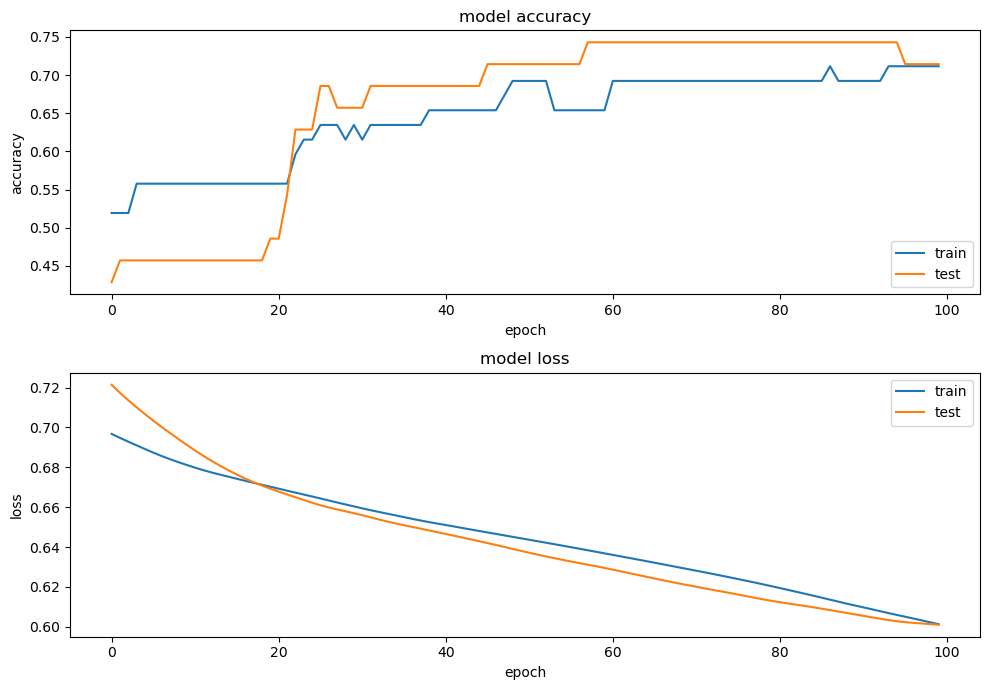

In [169]:
result_nonmi = nn_report(y_test_encoded,history, X_test, target, result_nonmi, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

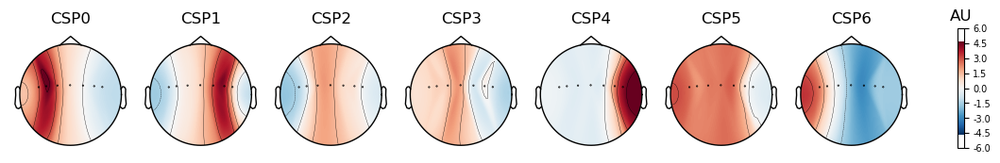

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [170]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [171]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [172]:
subset = mRMR_csp(csp,x,y,k=2)
subset

100%|██████████| 2/2 [00:01<00:00,  1.71it/s]


[0, 1]

In [173]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=subset)

In [174]:
result_nonmi = svm(X_train, X_test, y_train, y_test, target, result_nonmi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.7142857142857143
precision: 0.7502497502497503
recall: 0.7142857142857143
f1_score: 0.7100563909774437
              precision    recall  f1-score   support

      non-MI       0.85      0.58      0.69        19
          MI       0.64      0.88      0.74        16

    accuracy                           0.71        35
   macro avg       0.74      0.73      0.71        35
weighted avg       0.75      0.71      0.71        35

Confusion matrix 
[[11  8]
 [ 2 14]]



In [175]:
result_nonmi = lda(X_train, X_test, y_train, y_test, target, result_nonmi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]



In [176]:
result_nonmi = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi)

============ logistic_regression ============
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]



In [177]:
result_nonmi = naive(X_train, X_test, y_train, y_test, target, result_nonmi)

============ naive bayes ============
Accuracy: 0.7142857142857143
precision: 0.7314285714285714
recall: 0.7142857142857143
f1_score: 0.7133520074696547
              precision    recall  f1-score   support

      non-MI       0.80      0.63      0.71        19
          MI       0.65      0.81      0.72        16

    accuracy                           0.71        35
   macro avg       0.73      0.72      0.71        35
weighted avg       0.73      0.71      0.71        35

Confusion matrix 
[[12  7]
 [ 3 13]]



In [178]:
result_nonmi = knn(X_train, X_test, y_train, y_test, target, result_nonmi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.6285714285714286
precision: 0.630812324929972
recall: 0.6285714285714286
f1_score: 0.6291798291798291
              precision    recall  f1-score   support

      non-MI       0.67      0.63      0.65        19
          MI       0.59      0.62      0.61        16

    accuracy                           0.63        35
   macro avg       0.63      0.63      0.63        35
weighted avg       0.63      0.63      0.63        35

Confusion matrix 
[[12  7]
 [ 6 10]]



In [179]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_45 (Dense)            (None, 32)                96        
                                                                 
 dense_46 (Dense)            (None, 16)                528       
                                                                 
 dense_47 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [180]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=60,batch_size = X_train.shape[0])

Epoch 1/60
1/1 [==============================] - 1s 537ms/step - loss: 0.7293 - accuracy: 0.3846 - val_loss: 0.7830 - val_accuracy: 0.2857
Epoch 2/60
1/1 [==============================] - 0s 35ms/step - loss: 0.7257 - accuracy: 0.3846 - val_loss: 0.7769 - val_accuracy: 0.2857
Epoch 3/60
1/1 [==============================] - 0s 35ms/step - loss: 0.7222 - accuracy: 0.3654 - val_loss: 0.7709 - val_accuracy: 0.2857
Epoch 4/60
1/1 [==============================] - 0s 34ms/step - loss: 0.7188 - accuracy: 0.3846 - val_loss: 0.7651 - val_accuracy: 0.3143
Epoch 5/60
1/1 [==============================] - 0s 35ms/step - loss: 0.7156 - accuracy: 0.4231 - val_loss: 0.7595 - val_accuracy: 0.2857
Epoch 6/60
1/1 [==============================] - 0s 35ms/step - loss: 0.7125 - accuracy: 0.4615 - val_loss: 0.7538 - val_accuracy: 0.2571
Epoch 7/60
1/1 [==============================] - 0s 35ms/step - loss: 0.7096 - accuracy: 0.4615 - val_loss: 0.7482 - val_accuracy: 0.2571
Epoch 8/60
1/1 [==========

2/2 [==============================] - 0s 2ms/step
Accuracy: 0.7428571428571429
precision: 0.7700680272108843
recall: 0.7428571428571429
f1_score: 0.7407511407511407
              precision    recall  f1-score   support

      non-MI       0.86      0.63      0.73        19
          MI       0.67      0.88      0.76        16

    accuracy                           0.74        35
   macro avg       0.76      0.75      0.74        35
weighted avg       0.77      0.74      0.74        35

Confusion matrix 
[[12  7]
 [ 2 14]]
Test loss: 0.5734052658081055
Test accuracy: 0.7428571581840515


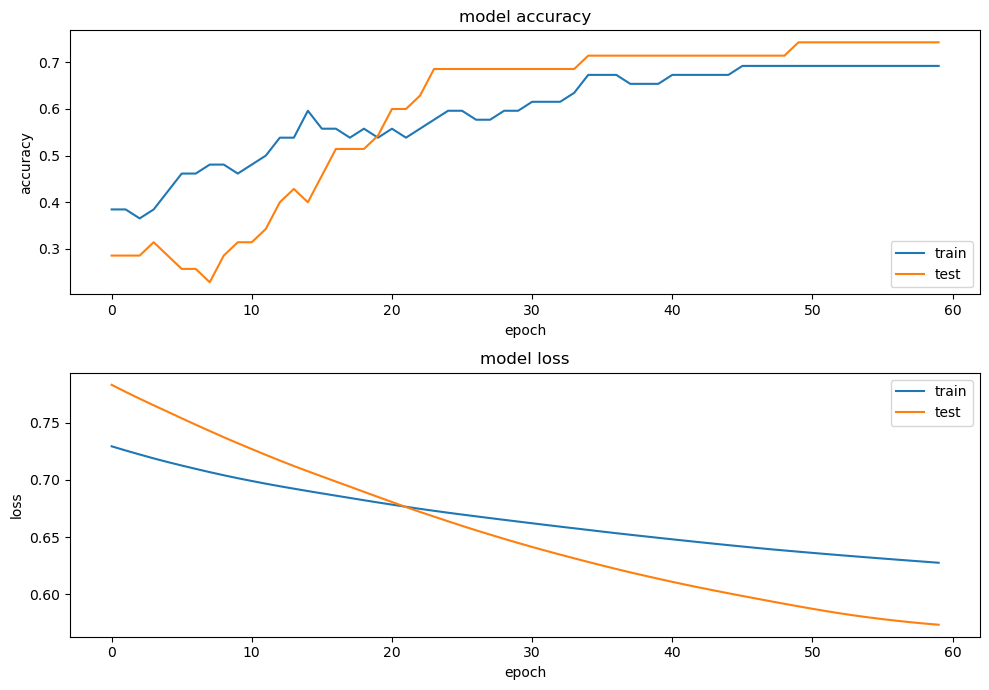

In [181]:
result_nonmi = nn_report(y_test_encoded,history, X_test, target, result_nonmi, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

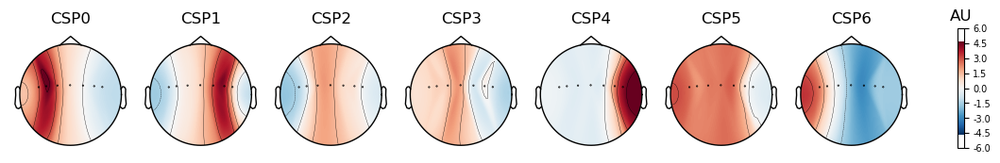

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


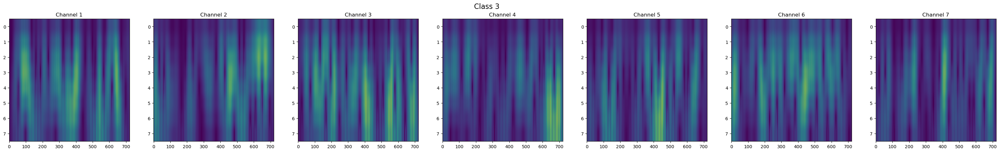

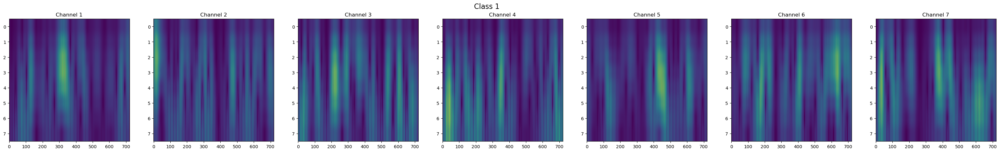

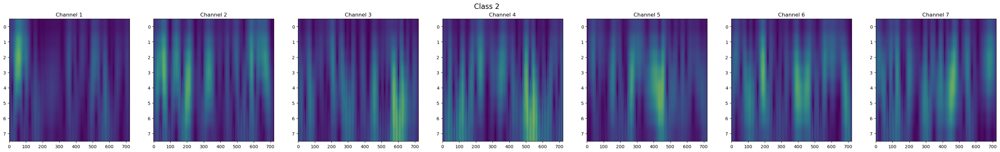

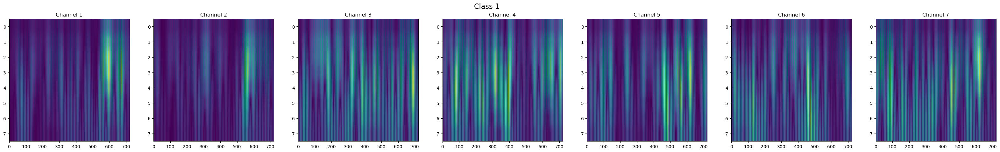

In [182]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [183]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [184]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [185]:
result_nonmi = svm(X_train, X_test, y_train, y_test, target, result_nonmi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.5714285714285714
precision: 0.5884353741496599
recall: 0.5714285714285714
f1_score: 0.5679185679185679
              precision    recall  f1-score   support

      non-MI       0.64      0.47      0.55        19
          MI       0.52      0.69      0.59        16

    accuracy                           0.57        35
   macro avg       0.58      0.58      0.57        35
weighted avg       0.59      0.57      0.57        35

Confusion matrix 
[[ 9 10]
 [ 5 11]]



In [186]:
result_nonmi = lda(X_train, X_test, y_train, y_test, target, result_nonmi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.6571428571428571
precision: 0.6625583566760038
recall: 0.6571428571428571
f1_score: 0.6577030812324931
              precision    recall  f1-score   support

      non-MI       0.71      0.63      0.67        19
          MI       0.61      0.69      0.65        16

    accuracy                           0.66        35
   macro avg       0.66      0.66      0.66        35
weighted avg       0.66      0.66      0.66        35

Confusion matrix 
[[12  7]
 [ 5 11]]



In [187]:
result_nonmi = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi)

============ logistic_regression ============
Accuracy: 0.5428571428571428
precision: 0.5626373626373626
recall: 0.5428571428571428
f1_score: 0.5360902255639098
              precision    recall  f1-score   support

      non-MI       0.62      0.42      0.50        19
          MI       0.50      0.69      0.58        16

    accuracy                           0.54        35
   macro avg       0.56      0.55      0.54        35
weighted avg       0.56      0.54      0.54        35

Confusion matrix 
[[ 8 11]
 [ 5 11]]



In [188]:
result_nonmi = naive(X_train, X_test, y_train, y_test, target, result_nonmi)

============ naive bayes ============
Accuracy: 0.6857142857142857
precision: 0.687861811391223
recall: 0.6857142857142857
f1_score: 0.6862290862290863
              precision    recall  f1-score   support

      non-MI       0.72      0.68      0.70        19
          MI       0.65      0.69      0.67        16

    accuracy                           0.69        35
   macro avg       0.68      0.69      0.68        35
weighted avg       0.69      0.69      0.69        35

Confusion matrix 
[[13  6]
 [ 5 11]]



In [189]:
result_nonmi = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_nonmi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.6
precision: 0.6424242424242425
recall: 0.6
f1_score: 0.5866666666666666
              precision    recall  f1-score   support

      non-MI       0.73      0.42      0.53        19
          MI       0.54      0.81      0.65        16

    accuracy                           0.60        35
   macro avg       0.63      0.62      0.59        35
weighted avg       0.64      0.60      0.59        35

Confusion matrix 
[[ 8 11]
 [ 3 13]]



In [190]:
#create model
model = Sequential()
#add model layers
model.add(Dense(512, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 512)               20673024  
                                                                 
 dense_49 (Dense)            (None, 128)               65664     
                                                                 
 dense_50 (Dense)            (None, 32)                4128      
                                                                 
 dense_51 (Dense)            (None, 8)                 264       
                                                                 
 dense_52 (Dense)            (None, 2)                 18        
                                                                 
Total params: 20,743,098
Trainable params: 20,743,098
Non-trainable params: 0
_________________________________________________________________


In [191]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=70,batch_size = X_train.shape[0])

Epoch 1/70
1/1 [==============================] - 1s 972ms/step - loss: 0.9322 - accuracy: 0.4423 - val_loss: 44.3024 - val_accuracy: 0.4571
Epoch 2/70
1/1 [==============================] - 0s 102ms/step - loss: 31.4369 - accuracy: 0.5577 - val_loss: 2.0351 - val_accuracy: 0.5429
Epoch 3/70
1/1 [==============================] - 0s 95ms/step - loss: 1.7546 - accuracy: 0.5769 - val_loss: 5.2378 - val_accuracy: 0.5429
Epoch 4/70
1/1 [==============================] - 0s 96ms/step - loss: 7.5816 - accuracy: 0.4423 - val_loss: 6.2108 - val_accuracy: 0.5429
Epoch 5/70
1/1 [==============================] - 0s 96ms/step - loss: 8.0508 - accuracy: 0.4423 - val_loss: 3.4427 - val_accuracy: 0.5429
Epoch 6/70
1/1 [==============================] - 0s 89ms/step - loss: 4.7838 - accuracy: 0.4423 - val_loss: 0.6933 - val_accuracy: 0.4571
Epoch 7/70
1/1 [==============================] - 0s 88ms/step - loss: 0.6929 - accuracy: 0.5577 - val_loss: 0.6934 - val_accuracy: 0.4571
Epoch 8/70
1/1 [=======

2/2 [==============================] - 0s 15ms/step
Accuracy: 0.45714285714285713
precision: 0.20897959183673467
recall: 0.45714285714285713
f1_score: 0.2868347338935574
              precision    recall  f1-score   support

      non-MI       0.00      0.00      0.00        19
          MI       0.46      1.00      0.63        16

    accuracy                           0.46        35
   macro avg       0.23      0.50      0.31        35
weighted avg       0.21      0.46      0.29        35

Confusion matrix 
[[ 0 19]
 [ 0 16]]
Test loss: 0.6954877972602844
Test accuracy: 0.4571428596973419


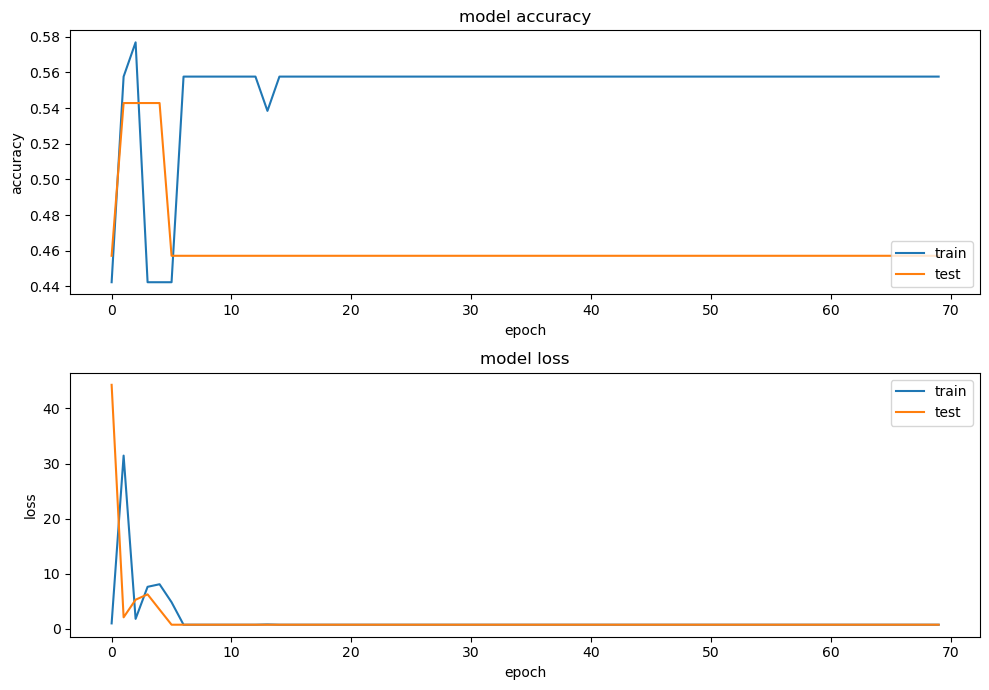

In [192]:
result_nonmi = nn_report(y_test_encoded,history, X_test, target,result_nonmi, numclass , model)

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

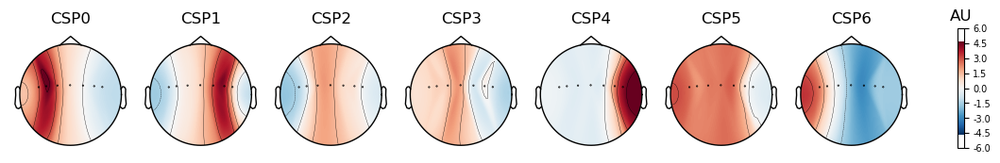

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


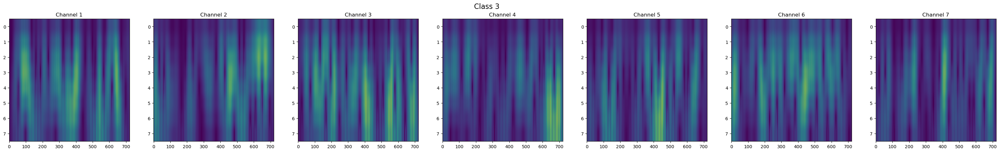

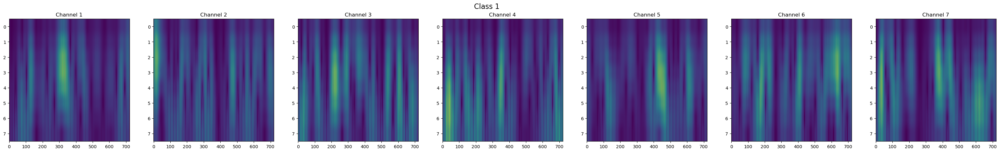

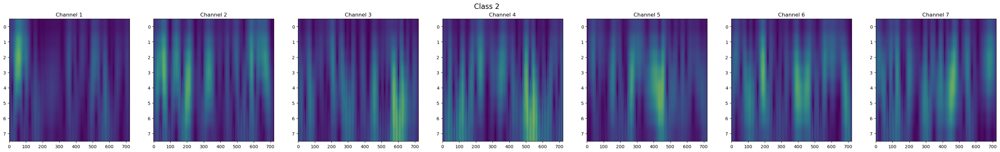

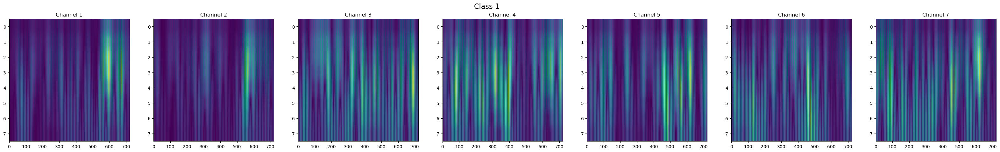

In [193]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [194]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [195]:
subset = mRMR_WT(data_WT, y,k=100)

100%|██████████| 100/100 [02:49<00:00,  1.69s/it]


[6781, 38531, 36986, 8826, 21241, 11745, 1212, 1841, 20576, 18674, 6079, 20847, 4202, 31688, 2914, 353, 6060, 1848, 36854, 12003, 19388, 36502, 6800, 18957, 2583, 20568, 491, 6331, 6787, 35585, 2193, 1081, 4931, 2562, 21297, 18667, 17027, 8479, 9547, 7502, 510, 1120, 36126, 6080, 19298, 21568, 6066, 1472, 2576, 347, 19855, 27966, 8105, 3187, 29953, 504, 31681, 4210, 1842, 2907, 27155, 37575, 1068, 6073, 17946, 2441, 22741, 1121, 1074, 36300, 20575, 7765, 35781, 1206, 6086, 8819, 1303, 35545, 6775, 2186, 1834, 7758, 35411, 7521, 21576, 11969, 21289, 1855, 360, 7052, 6794, 20019, 7154, 516, 27876, 9540, 1720, 2179, 4090, 20584]


In [196]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56,subset=subset)

In [197]:
result_nonmi = svm(X_train, X_test, y_train, y_test, target, result_nonmi, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.9714285714285714
precision: 0.9731092436974791
recall: 0.9714285714285714
f1_score: 0.9714753714753714
              precision    recall  f1-score   support

      non-MI       1.00      0.95      0.97        19
          MI       0.94      1.00      0.97        16

    accuracy                           0.97        35
   macro avg       0.97      0.97      0.97        35
weighted avg       0.97      0.97      0.97        35

Confusion matrix 
[[18  1]
 [ 0 16]]



In [198]:
result_nonmi = lda(X_train, X_test, y_train, y_test, target, result_nonmi)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.9142857142857143
precision: 0.9278195488721804
recall: 0.9142857142857143
f1_score: 0.9142857142857143
              precision    recall  f1-score   support

      non-MI       1.00      0.84      0.91        19
          MI       0.84      1.00      0.91        16

    accuracy                           0.91        35
   macro avg       0.92      0.92      0.91        35
weighted avg       0.93      0.91      0.91        35

Confusion matrix 
[[16  3]
 [ 0 16]]



In [199]:
result_nonmi = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi)

============ logistic_regression ============
Accuracy: 0.9714285714285714
precision: 0.9731092436974791
recall: 0.9714285714285714
f1_score: 0.9714753714753714
              precision    recall  f1-score   support

      non-MI       1.00      0.95      0.97        19
          MI       0.94      1.00      0.97        16

    accuracy                           0.97        35
   macro avg       0.97      0.97      0.97        35
weighted avg       0.97      0.97      0.97        35

Confusion matrix 
[[18  1]
 [ 0 16]]



In [200]:
result_nonmi = naive(X_train, X_test, y_train, y_test, target, result_nonmi)

============ naive bayes ============
Accuracy: 0.8285714285714286
precision: 0.8438923395445134
recall: 0.8285714285714286
f1_score: 0.8244897959183672
              precision    recall  f1-score   support

      non-MI       0.78      0.95      0.86        19
          MI       0.92      0.69      0.79        16

    accuracy                           0.83        35
   macro avg       0.85      0.82      0.82        35
weighted avg       0.84      0.83      0.82        35

Confusion matrix 
[[18  1]
 [ 5 11]]



In [201]:
result_nonmi = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target,result_nonmi)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.9142857142857143
precision: 0.9278195488721804
recall: 0.9142857142857143
f1_score: 0.9142857142857143
              precision    recall  f1-score   support

      non-MI       1.00      0.84      0.91        19
          MI       0.84      1.00      0.91        16

    accuracy                           0.91        35
   macro avg       0.92      0.92      0.91        35
weighted avg       0.93      0.91      0.91        35

Confusion matrix 
[[16  3]
 [ 0 16]]



In [202]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_53 (Dense)            (None, 64)                6464      
                                                                 
 dense_54 (Dense)            (None, 32)                2080      
                                                                 
 dense_55 (Dense)            (None, 16)                528       
                                                                 
 dense_56 (Dense)            (None, 2)                 34        
                                                                 
Total params: 9,106
Trainable params: 9,106
Non-trainable params: 0
_________________________________________________________________


In [203]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 598ms/step - loss: 1.6755 - accuracy: 0.5577 - val_loss: 1.6256 - val_accuracy: 0.5143
Epoch 2/50
1/1 [==============================] - 0s 37ms/step - loss: 1.3020 - accuracy: 0.5577 - val_loss: 1.2465 - val_accuracy: 0.4857
Epoch 3/50
1/1 [==============================] - 0s 36ms/step - loss: 0.9859 - accuracy: 0.6154 - val_loss: 0.9477 - val_accuracy: 0.4857
Epoch 4/50
1/1 [==============================] - 0s 34ms/step - loss: 0.7485 - accuracy: 0.6346 - val_loss: 0.7658 - val_accuracy: 0.5429
Epoch 5/50
1/1 [==============================] - 0s 36ms/step - loss: 0.6003 - accuracy: 0.6923 - val_loss: 0.6731 - val_accuracy: 0.6286
Epoch 6/50
1/1 [==============================] - 0s 38ms/step - loss: 0.5251 - accuracy: 0.7115 - val_loss: 0.6373 - val_accuracy: 0.5714
Epoch 7/50
1/1 [==============================] - 0s 36ms/step - loss: 0.4914 - accuracy: 0.7500 - val_loss: 0.6153 - val_accuracy: 0.6286
Epoch 8/50
1/1 [==========

2/2 [==============================] - 0s 4ms/step
Accuracy: 0.9142857142857143
precision: 0.9160597572362278
recall: 0.9142857142857143
f1_score: 0.9144261144261144
              precision    recall  f1-score   support

      non-MI       0.94      0.89      0.92        19
          MI       0.88      0.94      0.91        16

    accuracy                           0.91        35
   macro avg       0.91      0.92      0.91        35
weighted avg       0.92      0.91      0.91        35

Confusion matrix 
[[17  2]
 [ 1 15]]
Test loss: 0.22004462778568268
Test accuracy: 0.9142857193946838


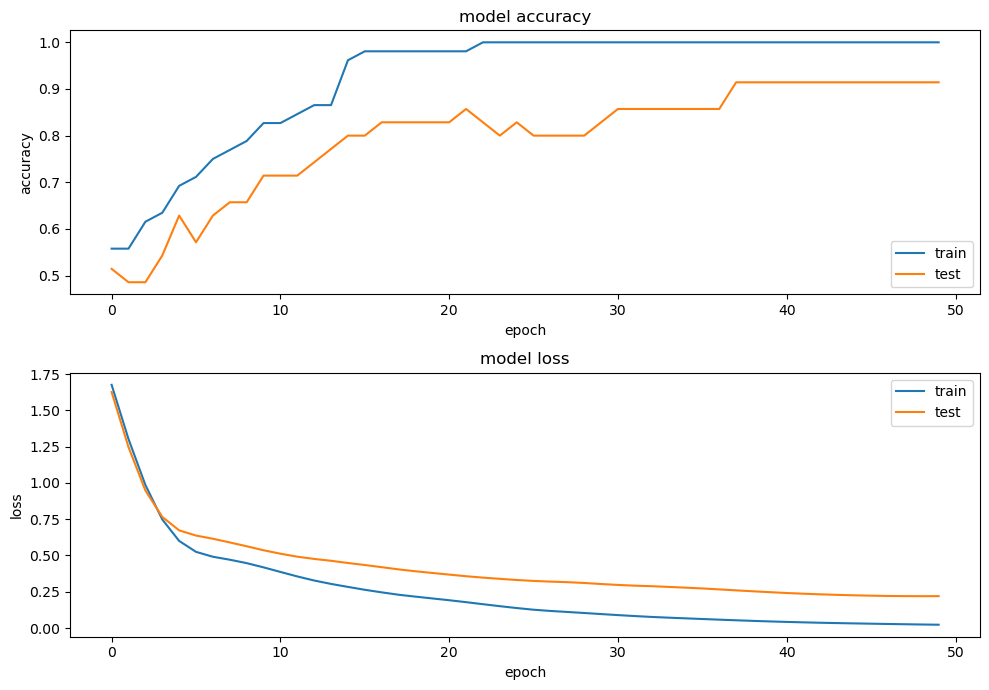

In [204]:
result_nonmi = nn_report(y_test_encoded,history, X_test, target, result_nonmi, numclass , model)

## **rest left right 100 paticipant**

In [205]:
# --- Data Details --- 
subject_id = ["001","002","003","004","005","006","007","008","009","010","011","012","013","014","015","016","017","018","019","020","021","022","023","024","025","026","027","028","029","030","031","032","033","034","035","036","037","038","039","040","041","042","043","044","045","046","047","048","049","050","051","052","053","054","055","056","057","058","059","060"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'rest':1, 'left': 2, 'right': 3}
target = ['rest', 'left', 'right']
numclass = [1,2,3]

In [206]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 180 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    4.8s finished


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 1600 samples (10.000 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 4 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 180 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating rejec

In [207]:
result_ind = [[],[],[],[]]

### **CSP + no feature selection**

Computing rank from data with rank=None


    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7

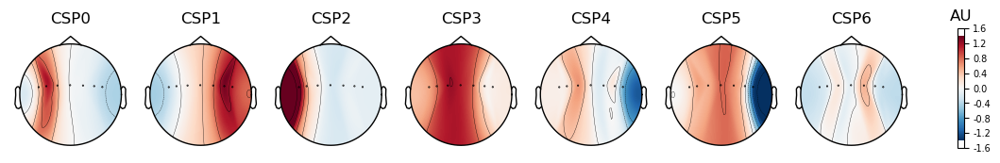

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [208]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [209]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.30,56)

In [210]:
result_ind = svm(X_train, X_test, y_train, y_test, target,result_ind, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.46496815286624205
precision: 0.21619538317984502
recall: 0.46496815286624205
f1_score: 0.2951536970368319
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       146
        left       0.00      0.00      0.00        86
       right       0.00      0.00      0.00        82

    accuracy                           0.46       314
   macro avg       0.15      0.33      0.21       314
weighted avg       0.22      0.46      0.30       314

Confusion matrix 
[[146   0   0]
 [ 86   0   0]
 [ 82   0   0]]



In [211]:
result_ind = lda(X_train, X_test, y_train, y_test, target, result_ind)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.445859872611465
precision: 0.34892168048094335
recall: 0.445859872611465
f1_score: 0.33008041444598535
              precision    recall  f1-score   support

        rest       0.47      0.90      0.62       146
        left       0.22      0.05      0.08        86
       right       0.27      0.05      0.08        82

    accuracy                           0.45       314
   macro avg       0.32      0.33      0.26       314
weighted avg       0.35      0.45      0.33       314

Confusion matrix 
[[132   7   7]
 [ 78   4   4]
 [ 71   7   4]]



In [212]:
result_ind = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind)

============ logistic_regression ============
Accuracy: 0.445859872611465
precision: 0.32658463318280717
recall: 0.445859872611465
f1_score: 0.3215069939185737
              precision    recall  f1-score   support

        rest       0.47      0.92      0.62       146
        left       0.24      0.05      0.08        86
       right       0.17      0.02      0.04        82

    accuracy                           0.45       314
   macro avg       0.29      0.33      0.25       314
weighted avg       0.33      0.45      0.32       314

Confusion matrix 
[[134   6   6]
 [ 78   4   4]
 [ 73   7   2]]



In [213]:
result_ind = naive(X_train, X_test, y_train, y_test, target, result_ind)

============ naive bayes ============
Accuracy: 0.4681528662420382
precision: 0.3327463055918786
recall: 0.4681528662420382
f1_score: 0.3227040816326531
              precision    recall  f1-score   support

        rest       0.47      0.97      0.63       146
        left       0.42      0.06      0.10        86
       right       0.00      0.00      0.00        82

    accuracy                           0.47       314
   macro avg       0.30      0.34      0.25       314
weighted avg       0.33      0.47      0.32       314

Confusion matrix 
[[142   4   0]
 [ 81   5   0]
 [ 79   3   0]]



In [214]:
result_ind = knn(X_train, X_test, y_train, y_test, target, result_ind)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.43312101910828027
precision: 0.4024593702755313
recall: 0.43312101910828027
f1_score: 0.39940695762583106
              precision    recall  f1-score   support

        rest       0.48      0.70      0.57       146
        left       0.33      0.22      0.26        86
       right       0.34      0.18      0.24        82

    accuracy                           0.43       314
   macro avg       0.38      0.37      0.36       314
weighted avg       0.40      0.43      0.40       314

Confusion matrix 
[[102  25  19]
 [ 57  19  10]
 [ 53  14  15]]



In [215]:
#create model
model = Sequential()
#add model layers
model.add(Dense(150, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_57 (Dense)            (None, 150)               1200      
                                                                 
 dense_58 (Dense)            (None, 64)                9664      
                                                                 
 dense_59 (Dense)            (None, 32)                2080      
                                                                 
 dense_60 (Dense)            (None, 16)                528       
                                                                 
 dense_61 (Dense)            (None, 3)                 51        
                                                                 
Total params: 13,523
Trainable params: 13,523
Non-trainable params: 0
_________________________________________________________________


In [216]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 626ms/step - loss: 1.0888 - accuracy: 0.4178 - val_loss: 1.0846 - val_accuracy: 0.4554
Epoch 2/100
1/1 [==============================] - 0s 43ms/step - loss: 1.0805 - accuracy: 0.4726 - val_loss: 1.0788 - val_accuracy: 0.4650
Epoch 3/100
1/1 [==============================] - 0s 38ms/step - loss: 1.0729 - accuracy: 0.4808 - val_loss: 1.0739 - val_accuracy: 0.4650
Epoch 4/100
1/1 [==============================] - 0s 38ms/step - loss: 1.0659 - accuracy: 0.4822 - val_loss: 1.0705 - val_accuracy: 0.4650
Epoch 5/100
1/1 [==============================] - 0s 38ms/step - loss: 1.0605 - accuracy: 0.4822 - val_loss: 1.0687 - val_accuracy: 0.4650
Epoch 6/100
1/1 [==============================] - 0s 39ms/step - loss: 1.0568 - accuracy: 0.4822 - val_loss: 1.0681 - val_accuracy: 0.4650
Epoch 7/100
1/1 [==============================] - 0s 39ms/step - loss: 1.0544 - accuracy: 0.4822 - val_loss: 1.0683 - val_accuracy: 0.4650
Epoch 8/100
1/1 [==

10/10 [==============================] - 0s 2ms/step
Accuracy: 0.4299363057324841
precision: 0.407726595733722
recall: 0.4299363057324841
f1_score: 0.38599078366660133
              precision    recall  f1-score   support

        rest       0.46      0.72      0.56       146
        left       0.31      0.22      0.26        86
       right       0.41      0.13      0.20        82

    accuracy                           0.43       314
   macro avg       0.39      0.36      0.34       314
weighted avg       0.41      0.43      0.39       314

Confusion matrix 
[[105  29  12]
 [ 63  19   4]
 [ 58  13  11]]
Test loss: 1.1552351713180542
Test accuracy: 0.42993631958961487


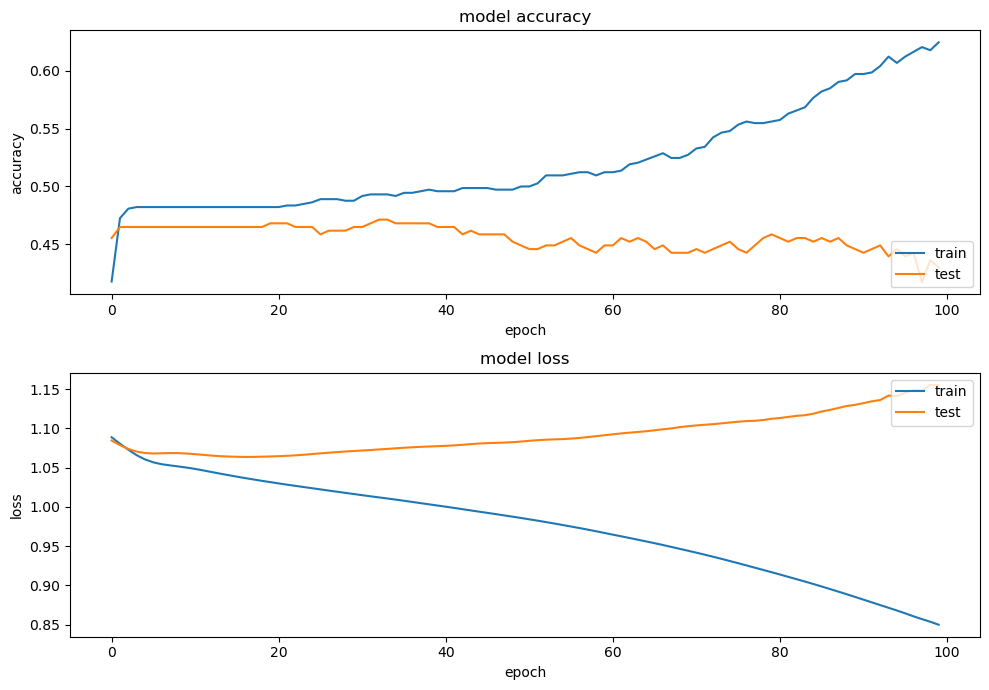

In [217]:
result_ind = nn_report(y_test_encoded,history, X_test, target, result_ind, numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None


    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7

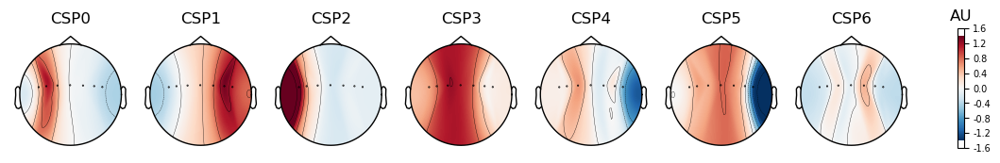

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [218]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [219]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[1,5])

In [220]:
result_ind = svm(X_train, X_test, y_train, y_test, target, result_ind, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]



In [221]:
result_ind = lda(X_train, X_test, y_train, y_test, target, result_ind)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.45215311004784686
precision: 0.2650706118145904
recall: 0.45215311004784686
f1_score: 0.29005658521912914
              precision    recall  f1-score   support

        rest       0.46      0.98      0.62       192
        left       0.20      0.01      0.02       117
       right       0.00      0.00      0.00       109

    accuracy                           0.45       418
   macro avg       0.22      0.33      0.21       418
weighted avg       0.27      0.45      0.29       418

Confusion matrix 
[[188   4   0]
 [116   1   0]
 [109   0   0]]



In [222]:
result_ind = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind)

============ logistic_regression ============
Accuracy: 0.45215311004784686
precision: 0.2650706118145904
recall: 0.45215311004784686
f1_score: 0.29005658521912914
              precision    recall  f1-score   support

        rest       0.46      0.98      0.62       192
        left       0.20      0.01      0.02       117
       right       0.00      0.00      0.00       109

    accuracy                           0.45       418
   macro avg       0.22      0.33      0.21       418
weighted avg       0.27      0.45      0.29       418

Confusion matrix 
[[188   4   0]
 [116   1   0]
 [109   0   0]]



In [223]:
result_ind = naive(X_train, X_test, y_train, y_test, target, result_ind)

============ naive bayes ============
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]



In [224]:
result_ind = knn(X_train, X_test, y_train, y_test, target, result_ind)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.33014354066985646
precision: 0.28161675644929235
recall: 0.33014354066985646
f1_score: 0.2946728248531083
              precision    recall  f1-score   support

        rest       0.41      0.59      0.49       192
        left       0.15      0.10      0.12       117
       right       0.18      0.11      0.14       109

    accuracy                           0.33       418
   macro avg       0.25      0.27      0.25       418
weighted avg       0.28      0.33      0.29       418

Confusion matrix 
[[114  43  35]
 [ 87  12  18]
 [ 74  23  12]]



In [225]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_62 (Dense)            (None, 64)                192       
                                                                 
 dense_63 (Dense)            (None, 32)                2080      
                                                                 
 dense_64 (Dense)            (None, 16)                528       
                                                                 
 dense_65 (Dense)            (None, 3)                 51        
                                                                 
Total params: 2,851
Trainable params: 2,851
Non-trainable params: 0
_________________________________________________________________


In [226]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 638ms/step - loss: 1.0989 - accuracy: 0.3179 - val_loss: 1.1006 - val_accuracy: 0.2990
Epoch 2/100
1/1 [==============================] - 0s 49ms/step - loss: 1.0954 - accuracy: 0.3291 - val_loss: 1.0979 - val_accuracy: 0.2990
Epoch 3/100
1/1 [==============================] - 0s 38ms/step - loss: 1.0920 - accuracy: 0.3466 - val_loss: 1.0952 - val_accuracy: 0.3756
Epoch 4/100
1/1 [==============================] - 0s 38ms/step - loss: 1.0885 - accuracy: 0.3898 - val_loss: 1.0926 - val_accuracy: 0.4067
Epoch 5/100
1/1 [==============================] - 0s 36ms/step - loss: 1.0852 - accuracy: 0.4121 - val_loss: 1.0901 - val_accuracy: 0.4258
Epoch 6/100
1/1 [==============================] - 0s 37ms/step - loss: 1.0820 - accuracy: 0.4521 - val_loss: 1.0878 - val_accuracy: 0.4378
Epoch 7/100
1/1 [==============================] - 0s 35ms/step - loss: 1.0789 - accuracy: 0.4681 - val_loss: 1.0856 - val_accuracy: 0.4450
Epoch 8/100
1/1 [==

14/14 [==============================] - 0s 2ms/step
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]
Test loss: 1.0760201215744019
Test accuracy: 0.45933014154434204


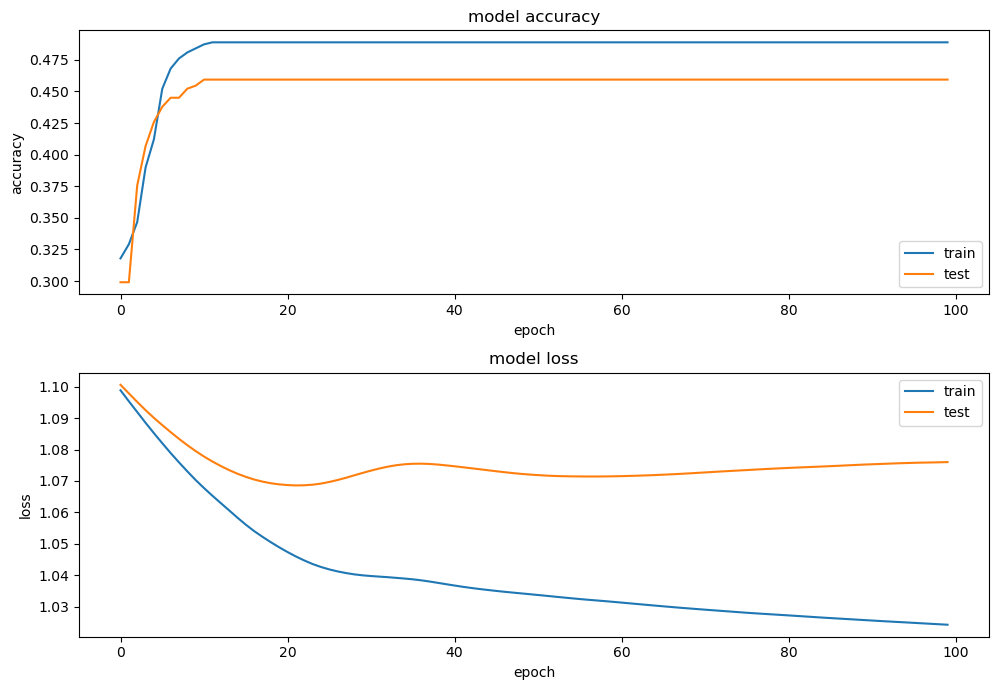

In [227]:
result_ind = nn_report(y_test_encoded,history, X_test, target, result_ind, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None


    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7

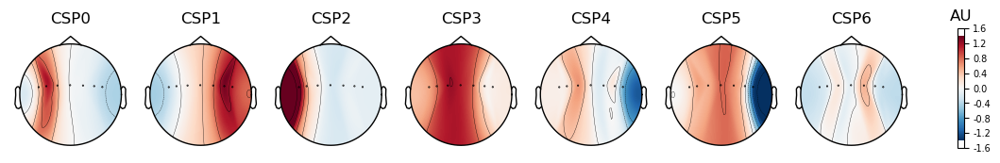

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [228]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [229]:
subset = mRMR_csp(csp,x,y,k=2)
subset

100%|██████████| 2/2 [00:01<00:00,  1.62it/s]


[0, 1]

In [230]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=subset)

In [231]:
result_ind = svm(X_train, X_test, y_train, y_test, target, result_ind, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]



In [232]:
result_ind = lda(X_train, X_test, y_train, y_test, target, result_ind)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]



In [233]:
result_ind = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind)

============ logistic_regression ============
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]



In [234]:
result_ind = naive(X_train, X_test, y_train, y_test, target, result_ind)

============ naive bayes ============
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]



In [235]:
result_ind = knn(X_train, X_test, y_train, y_test, target, result_ind)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.4019138755980861
precision: 0.3768496882763983
recall: 0.4019138755980861
f1_score: 0.37331694314631286
              precision    recall  f1-score   support

        rest       0.44      0.64      0.52       192
        left       0.28      0.17      0.21       117
       right       0.37      0.23      0.28       109

    accuracy                           0.40       418
   macro avg       0.36      0.35      0.34       418
weighted avg       0.38      0.40      0.37       418

Confusion matrix 
[[123  41  28]
 [ 82  20  15]
 [ 73  11  25]]



In [236]:
#create model
model = Sequential()
#add model layers
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_66 (Dense)            (None, 128)               384       
                                                                 
 dense_67 (Dense)            (None, 32)                4128      
                                                                 
 dense_68 (Dense)            (None, 8)                 264       
                                                                 
 dense_69 (Dense)            (None, 3)                 27        
                                                                 
Total params: 4,803
Trainable params: 4,803
Non-trainable params: 0
_________________________________________________________________


In [237]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=70,batch_size = X_train.shape[0])

Epoch 1/70
1/1 [==============================] - 1s 615ms/step - loss: 1.1185 - accuracy: 0.2492 - val_loss: 1.1056 - val_accuracy: 0.2823
Epoch 2/70
1/1 [==============================] - 0s 44ms/step - loss: 1.1105 - accuracy: 0.2524 - val_loss: 1.1002 - val_accuracy: 0.3158
Epoch 3/70
1/1 [==============================] - 0s 36ms/step - loss: 1.1037 - accuracy: 0.2780 - val_loss: 1.0958 - val_accuracy: 0.3445
Epoch 4/70
1/1 [==============================] - 0s 35ms/step - loss: 1.0983 - accuracy: 0.3307 - val_loss: 1.0918 - val_accuracy: 0.4115
Epoch 5/70
1/1 [==============================] - 0s 35ms/step - loss: 1.0934 - accuracy: 0.3898 - val_loss: 1.0884 - val_accuracy: 0.4258
Epoch 6/70
1/1 [==============================] - 0s 35ms/step - loss: 1.0893 - accuracy: 0.3962 - val_loss: 1.0859 - val_accuracy: 0.4450
Epoch 7/70
1/1 [==============================] - 0s 35ms/step - loss: 1.0857 - accuracy: 0.4377 - val_loss: 1.0839 - val_accuracy: 0.4545
Epoch 8/70
1/1 [==========

14/14 [==============================] - 0s 1ms/step
Accuracy: 0.45933014354066987
precision: 0.2109841807650924
recall: 0.45933014354066987
f1_score: 0.28915209036002826
              precision    recall  f1-score   support

        rest       0.46      1.00      0.63       192
        left       0.00      0.00      0.00       117
       right       0.00      0.00      0.00       109

    accuracy                           0.46       418
   macro avg       0.15      0.33      0.21       418
weighted avg       0.21      0.46      0.29       418

Confusion matrix 
[[192   0   0]
 [117   0   0]
 [109   0   0]]
Test loss: 1.0643099546432495
Test accuracy: 0.45933014154434204


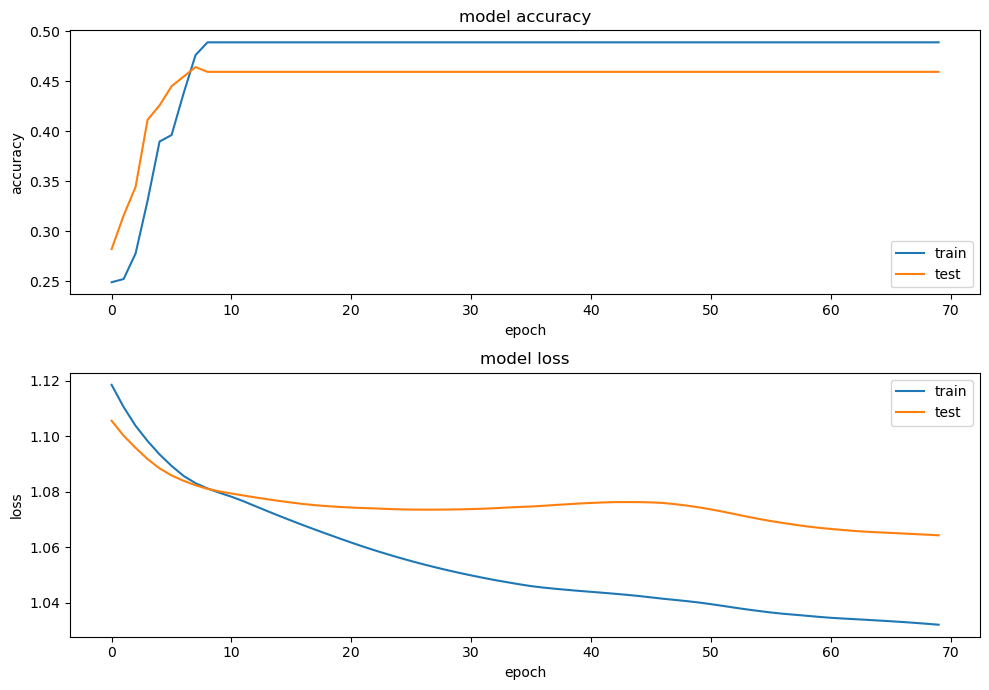

In [238]:
result_ind = nn_report(y_test_encoded,history, X_test, target, result_ind, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank 

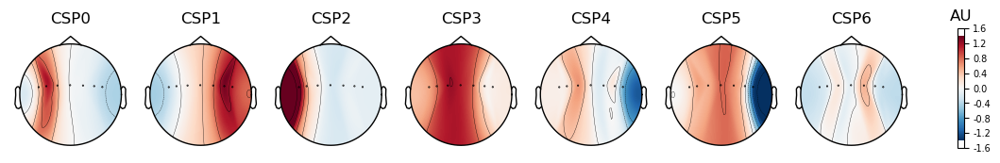

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


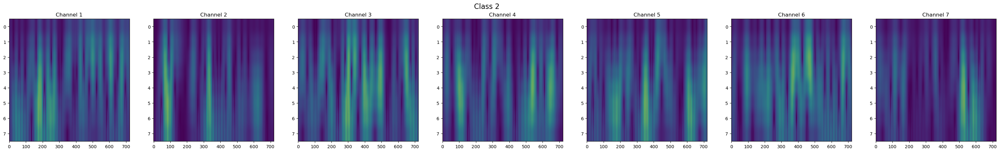

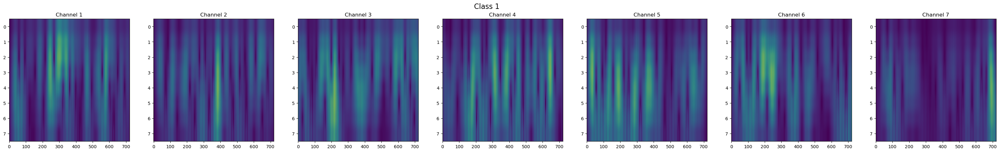

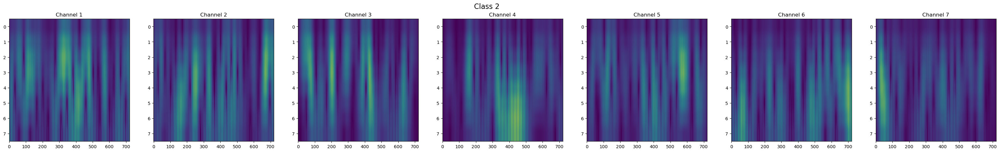

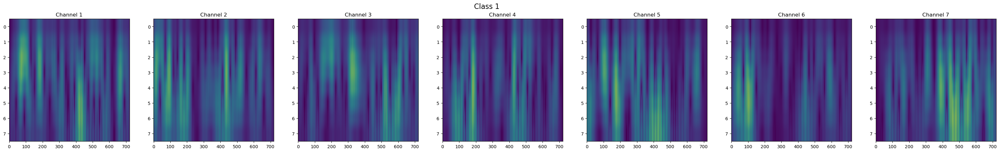

In [239]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [240]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [241]:
result_ind = svm(X_train, X_test, y_train, y_test, target, result_ind, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
Accuracy: 0.423444976076555
precision: 0.4025466447980218
recall: 0.423444976076555
f1_score: 0.40885810209906864
              precision    recall  f1-score   support

        rest       0.52      0.63      0.57       192
        left       0.29      0.26      0.27       117
       right       0.31      0.24      0.27       109

    accuracy                           0.42       418
   macro avg       0.38      0.38      0.37       418
weighted avg       0.40      0.42      0.41       418

Confusion matrix 
[[121  38  33]
 [ 63  30  24]
 [ 49  34  26]]



In [242]:
result_ind = lda(X_train, X_test, y_train, y_test, target, result_ind)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.41148325358851673
precision: 0.38625672754173
recall: 0.41148325358851673
f1_score: 0.39444871881754184
              precision    recall  f1-score   support

        rest       0.51      0.63      0.57       192
        left       0.30      0.26      0.28       117
       right       0.26      0.19      0.22       109

    accuracy                           0.41       418
   macro avg       0.36      0.36      0.35       418
weighted avg       0.39      0.41      0.39       418

Confusion matrix 
[[121  39  32]
 [ 58  30  29]
 [ 57  31  21]]



In [243]:
result_ind = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind)

============ logistic_regression ============
Accuracy: 0.42822966507177035
precision: 0.4113632917925202
recall: 0.42822966507177035
f1_score: 0.4172939739686151
              precision    recall  f1-score   support

        rest       0.53      0.62      0.57       192
        left       0.30      0.26      0.28       117
       right       0.32      0.27      0.29       109

    accuracy                           0.43       418
   macro avg       0.38      0.38      0.38       418
weighted avg       0.41      0.43      0.42       418

Confusion matrix 
[[119  36  37]
 [ 61  31  25]
 [ 44  36  29]]



In [244]:
result_ind = naive(X_train, X_test, y_train, y_test, target, result_ind)

============ naive bayes ============
Accuracy: 0.3229665071770335
precision: 0.35464218932912217
recall: 0.3229665071770335
f1_score: 0.3114529800732495
              precision    recall  f1-score   support

        rest       0.46      0.30      0.36       192
        left       0.27      0.14      0.18       117
       right       0.26      0.56      0.36       109

    accuracy                           0.32       418
   macro avg       0.33      0.33      0.30       418
weighted avg       0.35      0.32      0.31       418

Confusion matrix 
[[ 58  28 106]
 [ 36  16  65]
 [ 32  16  61]]



In [245]:
result_ind = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_ind)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.3875598086124402
precision: 0.37111102572784566
recall: 0.3875598086124402
f1_score: 0.37711289050384816
              precision    recall  f1-score   support

        rest       0.49      0.57      0.52       192
        left       0.31      0.26      0.28       117
       right       0.24      0.20      0.22       109

    accuracy                           0.39       418
   macro avg       0.34      0.34      0.34       418
weighted avg       0.37      0.39      0.38       418

Confusion matrix 
[[109  41  42]
 [ 57  31  29]
 [ 58  29  22]]



In [246]:
#create model
model = Sequential()
#add model layers
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_70 (Dense)            (None, 128)               5168256   
                                                                 
 dense_71 (Dense)            (None, 64)                8256      
                                                                 
 dense_72 (Dense)            (None, 32)                2080      
                                                                 
 dense_73 (Dense)            (None, 3)                 99        
                                                                 
Total params: 5,178,691
Trainable params: 5,178,691
Non-trainable params: 0
_________________________________________________________________


In [247]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 1s/step - loss: 1.5880 - accuracy: 0.3131 - val_loss: 51.7551 - val_accuracy: 0.4593
Epoch 2/50
1/1 [==============================] - 0s 193ms/step - loss: 49.1153 - accuracy: 0.4888 - val_loss: 53.3569 - val_accuracy: 0.2608
Epoch 3/50
1/1 [==============================] - 0s 142ms/step - loss: 56.8573 - accuracy: 0.2444 - val_loss: 23.8634 - val_accuracy: 0.4593
Epoch 4/50
1/1 [==============================] - 0s 153ms/step - loss: 22.5186 - accuracy: 0.4888 - val_loss: 32.4989 - val_accuracy: 0.2799
Epoch 5/50
1/1 [==============================] - 0s 143ms/step - loss: 31.8445 - accuracy: 0.2668 - val_loss: 34.5046 - val_accuracy: 0.4593
Epoch 6/50
1/1 [==============================] - 0s 136ms/step - loss: 32.3939 - accuracy: 0.4888 - val_loss: 23.2549 - val_accuracy: 0.4593
Epoch 7/50
1/1 [==============================] - 0s 121ms/step - loss: 21.6855 - accuracy: 0.4888 - val_loss: 27.8125 - val_accuracy: 0.2799
Epoch 8/50

14/14 [==============================] - 0s 5ms/step
Accuracy: 0.38516746411483255
precision: 0.44797929383797414
recall: 0.38516746411483255
f1_score: 0.37457630862061275
              precision    recall  f1-score   support

        rest       0.63      0.38      0.47       192
        left       0.29      0.14      0.19       117
       right       0.29      0.67      0.41       109

    accuracy                           0.39       418
   macro avg       0.41      0.39      0.35       418
weighted avg       0.45      0.39      0.37       418

Confusion matrix 
[[ 72  19 101]
 [ 26  16  75]
 [ 16  20  73]]
Test loss: 1.4910205602645874
Test accuracy: 0.3851674497127533


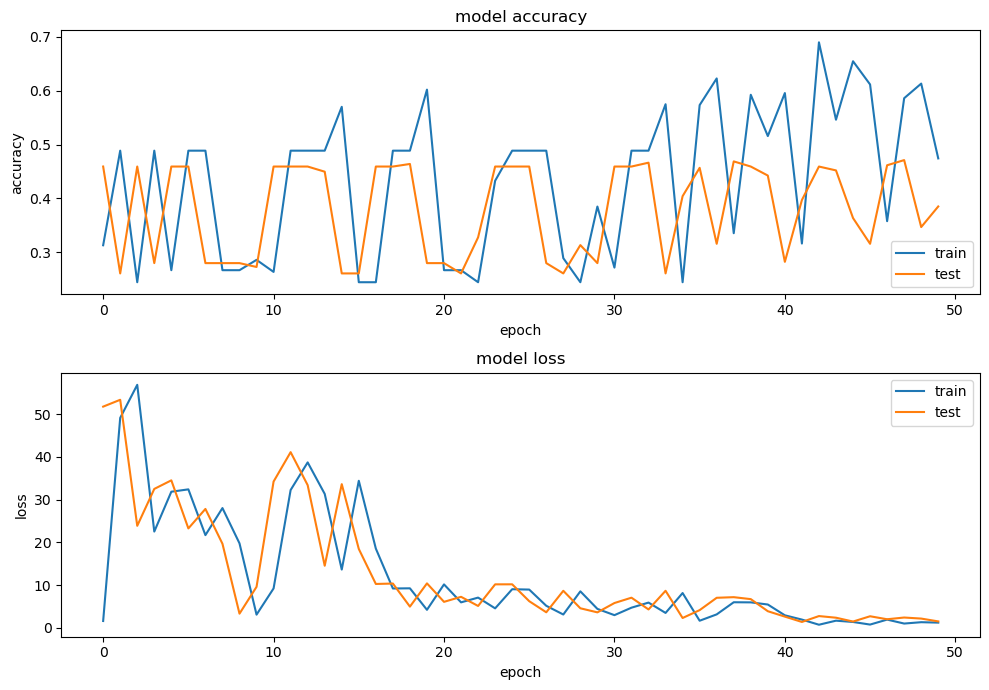

In [248]:
result_ind = nn_report(y_test_encoded,history, X_test, target, result_ind, numclass , model)

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank 

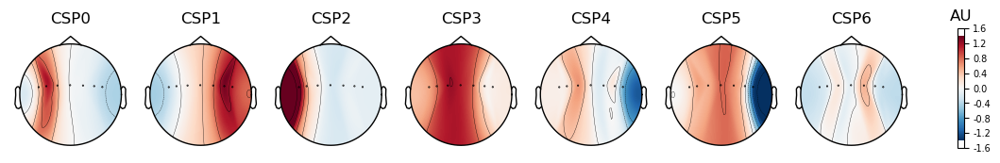

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


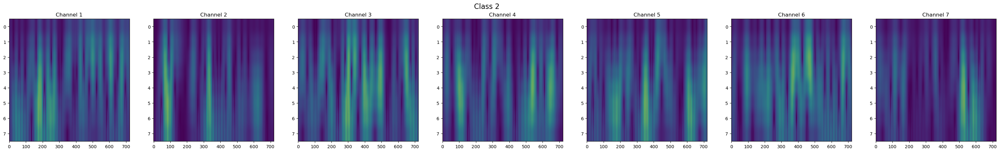

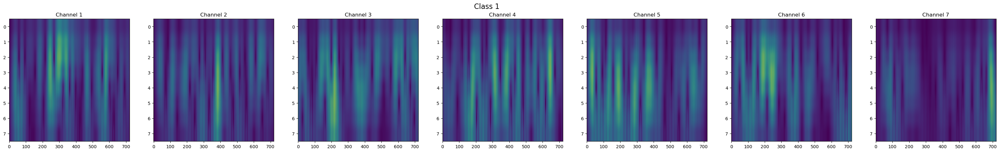

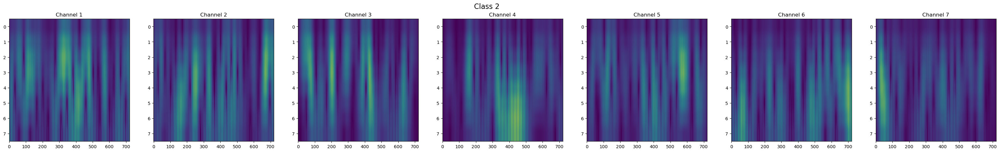

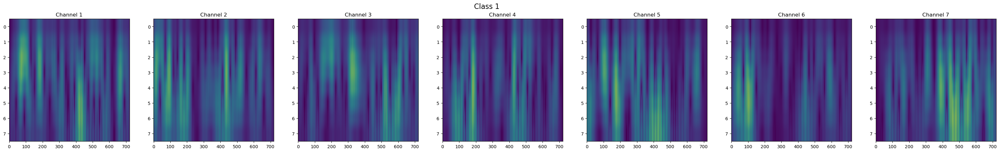

In [249]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [250]:
subset = mRMR_WT(data_WT, y,k=100)

100%|██████████| 100/100 [04:13<00:00,  2.53s/it]


[9557, 34108, 523, 1480, 1721, 23174, 21089, 14743, 1551, 9588, 22858, 2514, 798, 6248, 11259, 32929, 2442, 1238, 759, 10309, 20368, 8836, 830, 34428, 1889, 7049, 18079, 11029, 1757, 1722, 792, 517, 31040, 23895, 1487, 8843, 15464, 8868, 1728, 3235, 7677, 516, 31485, 1486, 11250, 1545, 10301, 22850, 2636, 2450, 1519, 3070, 9564, 19646, 23180, 1720, 32674, 6956, 38, 1243, 9589, 1001, 823, 34437, 1793, 31048, 31479, 9565, 10529, 6328, 1237, 765, 2072, 9549, 21810, 22841, 1544, 10308, 1908, 28900, 6242, 2449, 34731, 33650, 791, 9572, 1168, 280, 8875, 2485, 20367, 31348, 522, 753, 9556, 29830, 22849, 1000, 23901, 9581]


In [251]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56,subset=subset)

In [252]:
result_ind = svm(X_train, X_test, y_train, y_test, target, result_ind, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============


Accuracy: 0.44976076555023925
precision: 0.4325335402923888
recall: 0.44976076555023925
f1_score: 0.43650490919917123
              precision    recall  f1-score   support

        rest       0.52      0.64      0.58       192
        left       0.37      0.30      0.33       117
       right       0.34      0.28      0.30       109

    accuracy                           0.45       418
   macro avg       0.41      0.40      0.40       418
weighted avg       0.43      0.45      0.44       418

Confusion matrix 
[[123  29  40]
 [ 63  35  19]
 [ 49  30  30]]



In [253]:
result_ind = lda(X_train, X_test, y_train, y_test, target, result_ind)

============ Linear Discriminant Analysis (LDA) ============
Accuracy: 0.47607655502392343
precision: 0.4597538893017891
recall: 0.47607655502392343
f1_score: 0.4627230079847849
              precision    recall  f1-score   support

        rest       0.54      0.67      0.60       192
        left       0.39      0.34      0.37       117
       right       0.38      0.28      0.33       109

    accuracy                           0.48       418
   macro avg       0.44      0.43      0.43       418
weighted avg       0.46      0.48      0.46       418

Confusion matrix 
[[128  30  34]
 [ 61  40  16]
 [ 46  32  31]]



In [254]:
result_ind = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind)

============ logistic_regression ============
Accuracy: 0.45215311004784686
precision: 0.44361769944546114
recall: 0.45215311004784686
f1_score: 0.4466757264779896
              precision    recall  f1-score   support

        rest       0.54      0.60      0.57       192
        left       0.39      0.34      0.36       117
       right       0.33      0.31      0.32       109

    accuracy                           0.45       418
   macro avg       0.42      0.42      0.42       418
weighted avg       0.44      0.45      0.45       418

Confusion matrix 
[[115  30  47]
 [ 56  40  21]
 [ 42  33  34]]



In [255]:
result_ind = naive(X_train, X_test, y_train, y_test, target, result_ind)

============ naive bayes ============
Accuracy: 0.37320574162679426
precision: 0.4413010076013813
recall: 0.37320574162679426
f1_score: 0.3733372014429015
              precision    recall  f1-score   support

        rest       0.62      0.31      0.42       192
        left       0.32      0.58      0.41       117
       right       0.26      0.26      0.26       109

    accuracy                           0.37       418
   macro avg       0.40      0.38      0.36       418
weighted avg       0.44      0.37      0.37       418

Confusion matrix 
[[60 83 49]
 [19 68 30]
 [18 63 28]]



In [256]:
result_ind = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_ind)

============ K-Nearest Neighbors (KNN) ============
Accuracy: 0.45215311004784686
precision: 0.4281163850284437
recall: 0.45215311004784686
f1_score: 0.42896887363236164
              precision    recall  f1-score   support

        rest       0.51      0.69      0.59       192
        left       0.37      0.25      0.30       117
       right       0.35      0.26      0.30       109

    accuracy                           0.45       418
   macro avg       0.41      0.40      0.39       418
weighted avg       0.43      0.45      0.43       418

Confusion matrix 
[[132  31  29]
 [ 65  29  23]
 [ 62  19  28]]



In [257]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_74 (Dense)            (None, 64)                6464      
                                                                 
 dense_75 (Dense)            (None, 32)                2080      
                                                                 
 dense_76 (Dense)            (None, 16)                528       
                                                                 
 dense_77 (Dense)            (None, 3)                 51        
                                                                 
Total params: 9,123
Trainable params: 9,123
Non-trainable params: 0
_________________________________________________________________


In [258]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=80,batch_size = X_train.shape[0])

Epoch 1/80
1/1 [==============================] - 1s 817ms/step - loss: 2.3252 - accuracy: 0.2604 - val_loss: 1.6745 - val_accuracy: 0.2751
Epoch 2/80
1/1 [==============================] - 0s 42ms/step - loss: 1.7316 - accuracy: 0.2812 - val_loss: 1.4224 - val_accuracy: 0.3349
Epoch 3/80
1/1 [==============================] - 0s 42ms/step - loss: 1.4310 - accuracy: 0.3562 - val_loss: 1.3982 - val_accuracy: 0.3660
Epoch 4/80
1/1 [==============================] - 0s 42ms/step - loss: 1.3865 - accuracy: 0.4185 - val_loss: 1.4556 - val_accuracy: 0.3995
Epoch 5/80
1/1 [==============================] - 0s 40ms/step - loss: 1.4299 - accuracy: 0.4489 - val_loss: 1.4879 - val_accuracy: 0.4258
Epoch 6/80
1/1 [==============================] - 0s 45ms/step - loss: 1.4511 - accuracy: 0.4681 - val_loss: 1.4725 - val_accuracy: 0.4306
Epoch 7/80
1/1 [==============================] - 0s 43ms/step - loss: 1.4322 - accuracy: 0.4728 - val_loss: 1.4218 - val_accuracy: 0.4330
Epoch 8/80
1/1 [==========

14/14 [==============================] - 0s 2ms/step
Accuracy: 0.5143540669856459
precision: 0.499022312274192
recall: 0.5143540669856459
f1_score: 0.4932348790921267
              precision    recall  f1-score   support

        rest       0.57      0.72      0.64       192
        left       0.44      0.44      0.44       117
       right       0.45      0.23      0.30       109

    accuracy                           0.51       418
   macro avg       0.48      0.46      0.46       418
weighted avg       0.50      0.51      0.49       418

Confusion matrix 
[[139  34  19]
 [ 54  51  12]
 [ 52  32  25]]
Test loss: 1.0372533798217773
Test accuracy: 0.5143540501594543


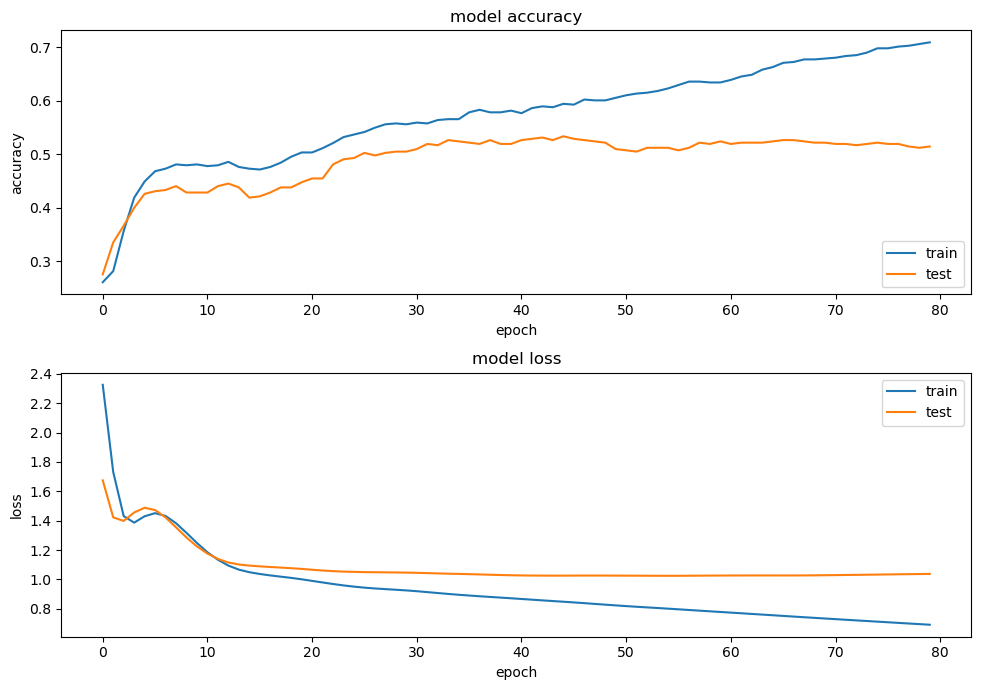

In [259]:
result_ind = nn_report(y_test_encoded,history, X_test, target, result_ind, numclass , model)

## **Conclusion**

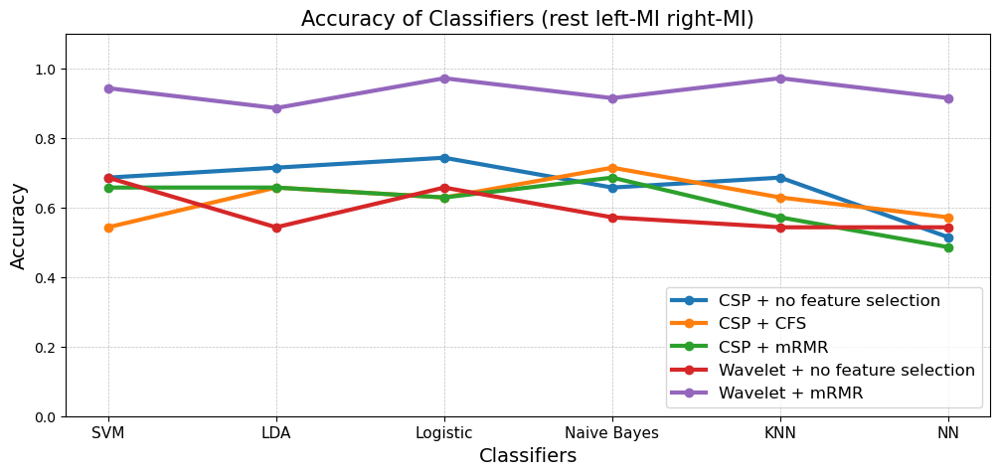

In [387]:
import matplotlib.pyplot as plt
import numpy as np

ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result[0][0:6]),'o-',linewidth=3)
plt.plot(np.array(result[0][6:12]),'o-',linewidth=3)
plt.plot(np.array(result[0][12:18]),'o-',linewidth=3)
plt.plot(np.array(result[0][18:24]),'o-',linewidth=3)
plt.plot(np.array(result[0][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

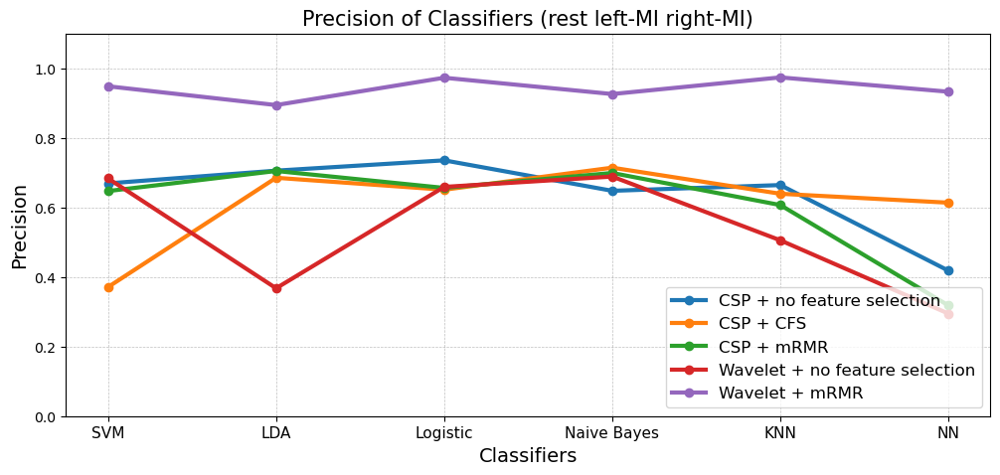

In [388]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result[1][0:6]),'o-',linewidth=3)
plt.plot(np.array(result[1][6:12]),'o-',linewidth=3)
plt.plot(np.array(result[1][12:18]),'o-',linewidth=3)
plt.plot(np.array(result[1][18:24]),'o-',linewidth=3)
plt.plot(np.array(result[1][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

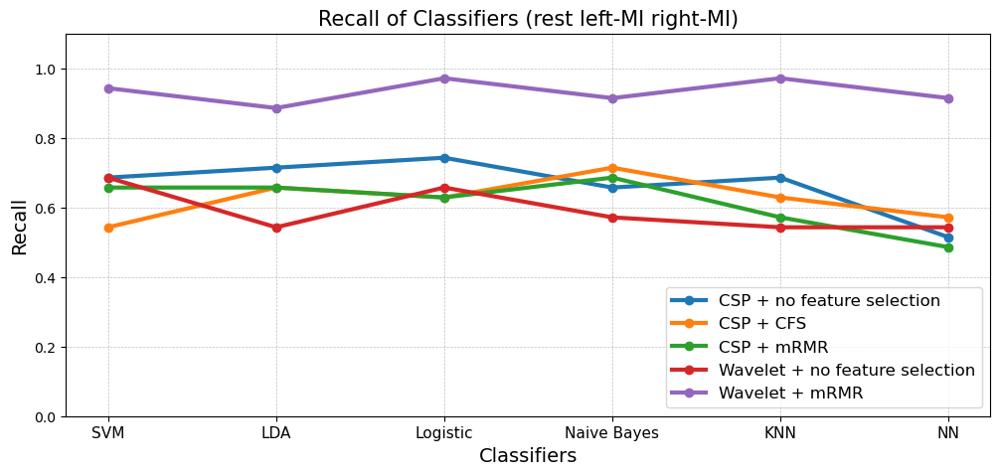

In [389]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result[2][0:6]),'o-',linewidth=3)
plt.plot(np.array(result[2][6:12]),'o-',linewidth=3)
plt.plot(np.array(result[2][12:18]),'o-',linewidth=3)
plt.plot(np.array(result[2][18:24]),'o-',linewidth=3)
plt.plot(np.array(result[2][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

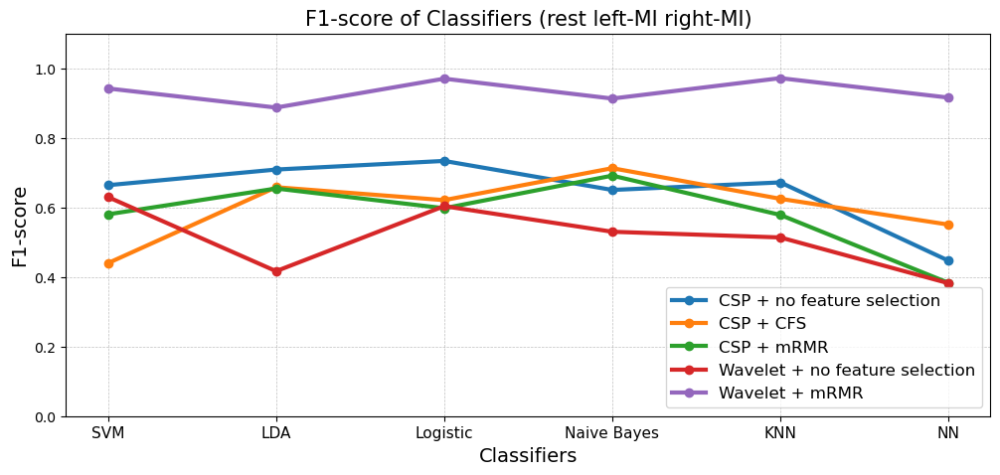

In [390]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result[3][0:6]),'o-',linewidth=3)
plt.plot(np.array(result[3][6:12]),'o-',linewidth=3)
plt.plot(np.array(result[3][12:18]),'o-',linewidth=3)
plt.plot(np.array(result[3][18:24]),'o-',linewidth=3)
plt.plot(np.array(result[3][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

-----------------------------------------------------

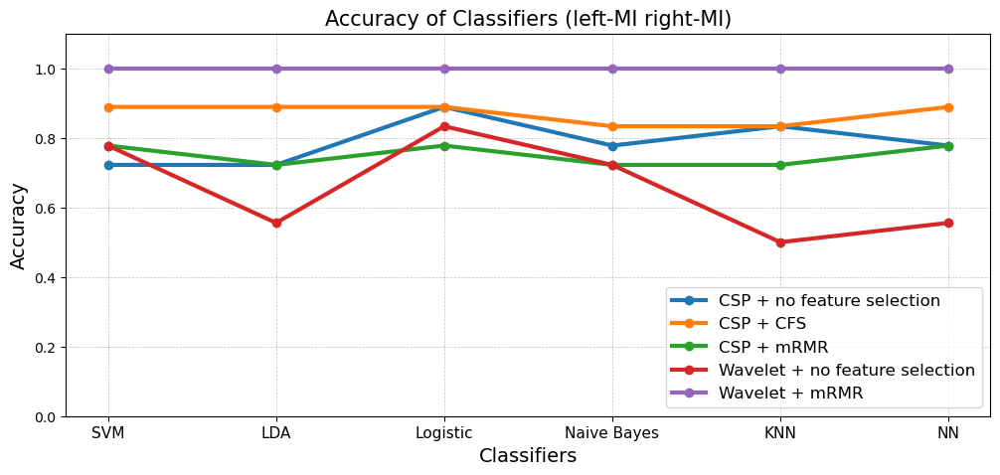

In [391]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi[0][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_mi[0][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_mi[0][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_mi[0][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_mi[0][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

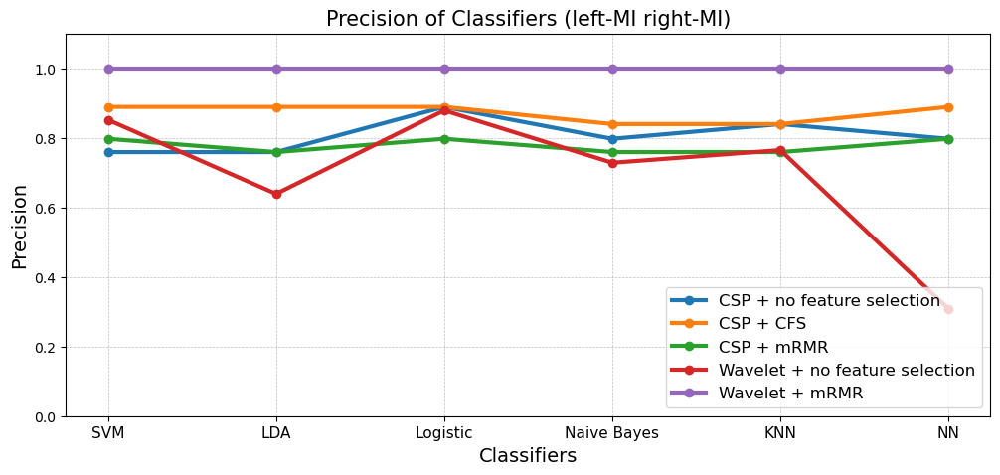

In [392]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi[1][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_mi[1][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_mi[1][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_mi[1][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_mi[1][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

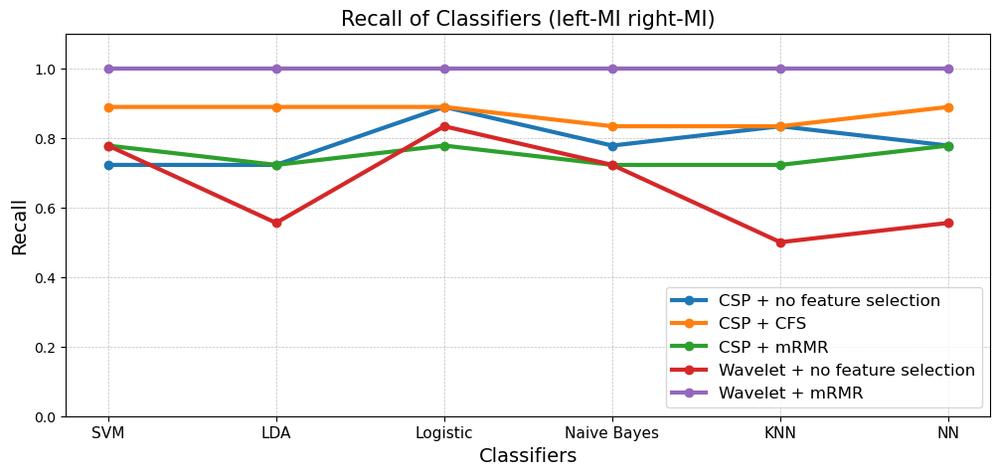

In [393]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi[2][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_mi[2][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_mi[2][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_mi[2][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_mi[2][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

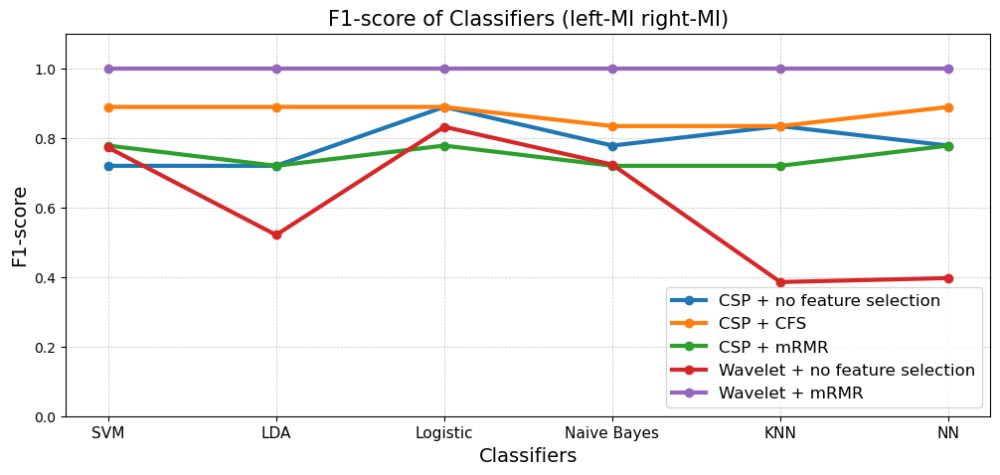

In [394]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi[3][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_mi[3][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_mi[3][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_mi[3][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_mi[3][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

-------------------------------------------------------

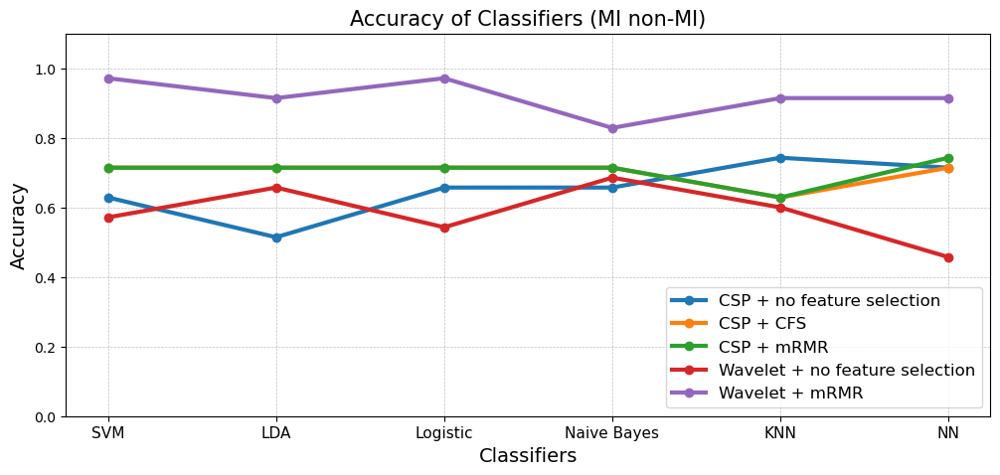

In [395]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi[0][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[0][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[0][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[0][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[0][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

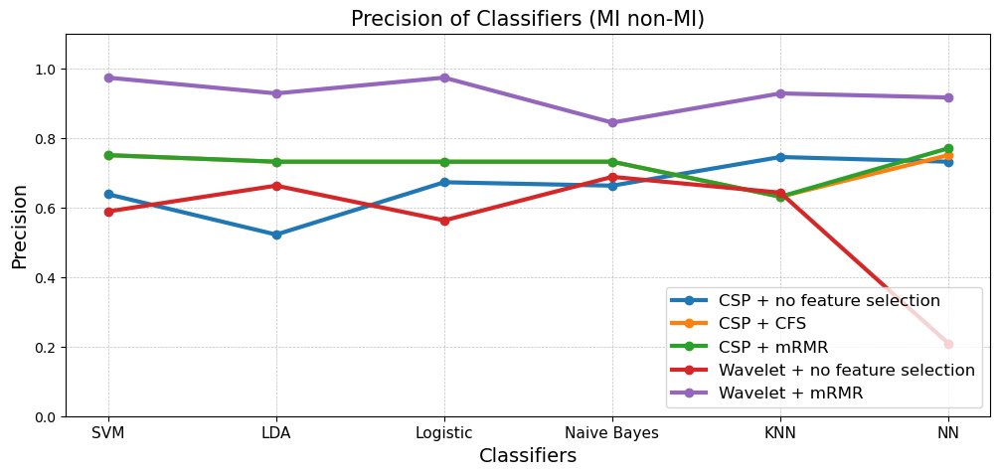

In [396]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi[1][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[1][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[1][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[1][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[1][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

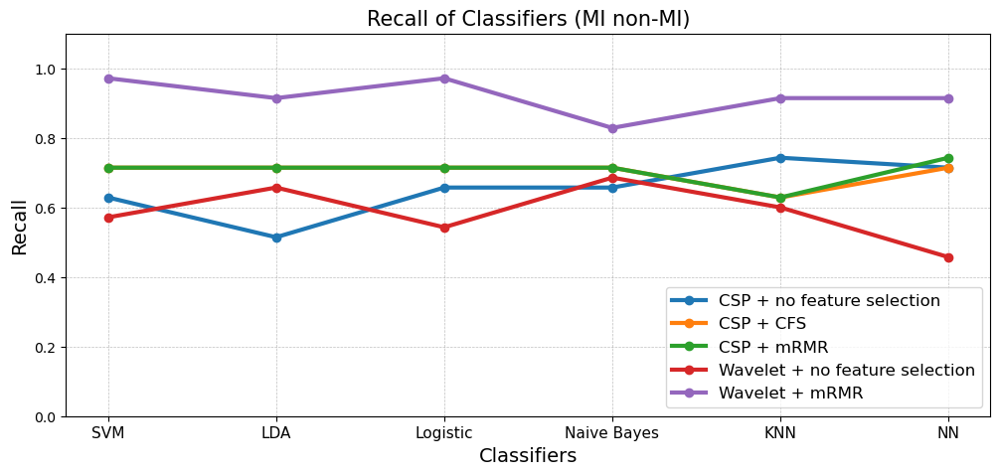

In [397]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi[2][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[2][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[2][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[2][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[2][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

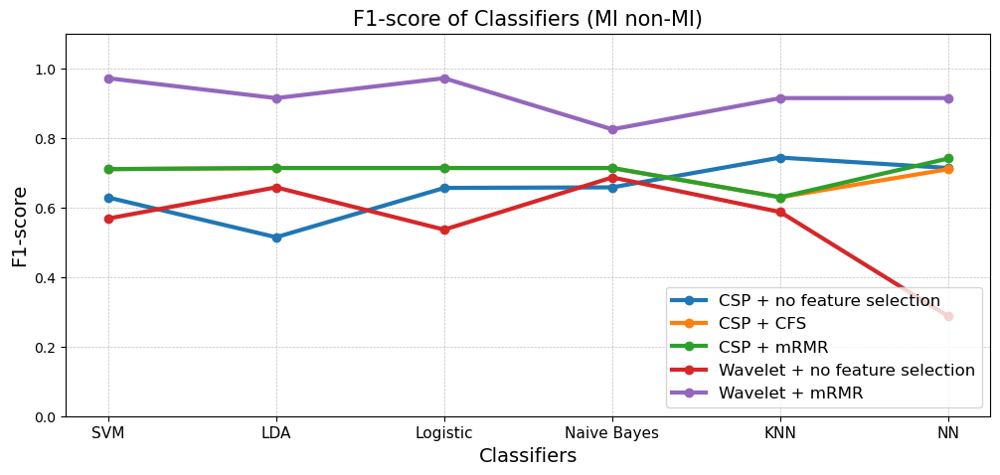

In [398]:
ac = np.array(result[0])
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi[3][0:6]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[3][6:12]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[3][12:18]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[3][18:24]),'o-',linewidth=3)
plt.plot(np.array(result_nonmi[3][24:30]),'o-',linewidth=3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()